### Initialization 

In [253]:
import sys 
import os 
import glob
import numpy as np
import scipy as sp
import matplotlib
import matplotlib.gridspec as gridspec
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib import cm
from matplotlib import colors
from matplotlib.ticker import PercentFormatter
import matplotlib.ticker as ticker
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator)
from pylab import *
from matplotlib.ticker import NullFormatter, MultipleLocator, FormatStrFormatter, FuncFormatter
from mpl_toolkits.axes_grid1 import make_axes_locatable
from gridData import Grid 
from io import StringIO
from collections import Counter
import seaborn as sns
from scipy.stats import norm
from  scipy.stats import gaussian_kde
from sklearn.neighbors import KernelDensity
#import statsmodels.api as sm
#from statsmodels.graphics.tsaplots import plot_acf
import math 
##Figure fonts and other params ##
##Figure fonts and other params ##
hfont = {'fontname':'Helvetica'}
mpl.rcParams['figure.dpi'] =300
mpl.rcParams.update({'font.size': 16})
mpl.rcParams['pdf.fonttype'] = 42 
plt.rc('font', family='Helvetica')
##

def rolling_window(a, window_size):
    shape = (a.shape[0] - window_size + 1, window_size) + a.shape[1:]
    strides = (a.strides[0],) + a.strides
    return np.lib.stride_tricks.as_strided(a, shape=shape, strides=strides)


### BLOCK AVG --  ##

#(rm1[:,1])

def blockAverage(datastream, isplot=True, maxBlockSize=0):
 
	Nobs         = len(datastream)           # total number of observations in datastream
	minBlockSize = 1;                        # min: 1 observation/block
 
	if maxBlockSize == 0:
		maxBlockSize = int(Nobs/4);        # max: 4 blocs (otherwise can't calc variance)
  
	NumBlocks = maxBlockSize - minBlockSize   # total number of block sizes

	blockMean = np.zeros(NumBlocks)               # mean (expect to be "nearly" constant)
	blockVar  = np.zeros(NumBlocks)               # variance associated with each blockSize
	blockCtr  = 0
	
				#
				#  blockSize is # observations/block
				#  run them through all the possibilities
				#
 
	for blockSize in range(minBlockSize, maxBlockSize):

		Nblock    = int(Nobs/blockSize)               # total number of such blocks in datastream
		obsProp   = np.zeros(Nblock)                  # container for parcelling block 
        
		# Loop to chop datastream into blocks
		# and take average
		for i in range(1,Nblock+1):
			
			ibeg = (i-1) * blockSize
			iend =  ibeg + blockSize
			obsProp[i-1] = np.mean(datastream[ibeg:iend])

		blockMean[blockCtr] = np.mean(obsProp)
		blockVar[blockCtr]  = np.var(obsProp)/(Nblock - 1)
		blockCtr += 1
 
	v = np.arange(minBlockSize,maxBlockSize)
	
	if isplot:
    
		plt.figure( figsize = (6,3)) 
		plt.subplot(1,2,1)
		plt.plot(v, np.sqrt(blockVar),'-',lw=1)
		plt.xlabel('block size')
		plt.ylabel('std')

		plt.subplot(1,2,2)
		plt.errorbar(v, blockMean, np.sqrt(blockVar))
		plt.ylabel('<x>')
		plt.xlabel('block size')

		print (blockMean[-1], np.sqrt(blockVar[-1]))
        
		plt.tight_layout()
		plt.show()
		
	#return v, blockVar, blockMean

# Plots for TF-F7 MS figures 

In this script: All the code used to generate the final figures, both main and supplementary, to be inlcuded ton the TF-F7 manuscript ("A Structural model of full-length tissue factor (TF) and the TF-factor VIIa complex in lipid membranes") by A. Luchini, R. Araya-Secchi, F. Tideman et al. 

The order of the plot scripts will follow the MS figures.

## Fig. 2 -- Protein Density profiles

## Fig3, Fig5 and associated Sup. Mat. figures.

###   Protein lipid contact profiles (TF: CLpcps r1-r3, CLpc, TF-F7 for comparison)

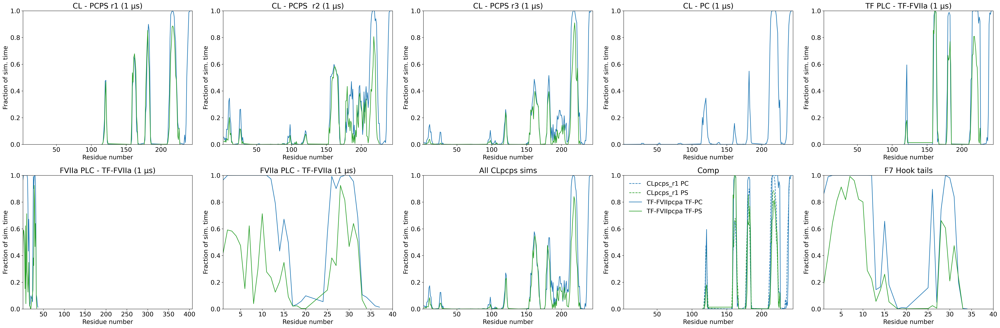

In [7]:
## CL - PCPS
plt.figure( figsize = (36,12)) 
#R1

file1 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/CL_1us_pcps_PLC_PC_100ps.dat_hist.dat.eq'
file2 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/CL_1us_pcps_PLC_PS_100ps.dat_hist.dat.eq'

with open(file1, 'r') as fd:
    lines1 = fd.read().split()
    counter1 = Counter(lines1)
    items1 = sorted(counter1.items(), key=lambda x: int(x[0]))
    num_items1 = np.array(items1, dtype=int)

with open(file2, 'r') as fd:
    lines2 = fd.read().split()
    counter2 = Counter(lines2)
    items2 = sorted(counter2.items(), key=lambda x: int(x[0]))
    num_items2 = np.array(items2, dtype=int)
        
    plt.subplot(251)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('CL - PCPS r1 (1 µs)')
    plt.plot((num_items1[:,0]+2), (num_items1[:,1]/8003), color= 'C0', zorder=1)
    plt.plot((num_items2[:,0]+2), (num_items2[:,1]/8003), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])   
    
#R2

file3 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/CLr2_1us_pcps_PLC_PC_100ps.dat_hist.dat.eq'
file4 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/CLr2_1us_pcps_PLC_PS_100ps.dat_hist.dat.eq'

with open(file3, 'r') as fd:
    lines3 = fd.read().split()
    counter3 = Counter(lines3)
    items3 = sorted(counter3.items(), key=lambda x: int(x[0]))
    num_items3 = np.array(items3, dtype=int)

with open(file4, 'r') as fd:
    lines4 = fd.read().split()
    counter4 = Counter(lines4)
    items4 = sorted(counter4.items(), key=lambda x: int(x[0]))
    num_items4 = np.array(items4, dtype=int)
        
    plt.subplot(252)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('CL - PCPS  r2 (1 µs)')
    plt.plot((num_items3[:,0]+2), (num_items3[:,1]/9421), color= 'C0', zorder=1)
    plt.plot((num_items4[:,0]+2), (num_items4[:,1]/9421), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])   

#R3
file5 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/CLr3_1us_pcps_PLC_PC_100ps.dat_hist.dat.eq'
file6 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/CLr3_1us_pcps_PLC_PS_100ps.dat_hist.dat.eq'

with open(file5, 'r') as fd:
    lines5 = fd.read().split()
    counter5 = Counter(lines5)
    items5 = sorted(counter5.items(), key=lambda x: int(x[0]))
    num_items5 = np.array(items5, dtype=int)

with open(file6, 'r') as fd:
    lines6 = fd.read().split()
    counter6 = Counter(lines6)
    items6 = sorted(counter6.items(), key=lambda x: int(x[0]))
    num_items6 = np.array(items6, dtype=int)
        
    plt.subplot(253)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('CL - PCPS r3 (1 µs)')
    plt.plot((num_items5[:,0]+2), (num_items5[:,1]/9144), color= 'C0', zorder=1)
    plt.plot((num_items6[:,0]+2), (num_items6[:,1]/9144), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])   

    ## CL - PC
file7 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/CL_1us_pc_PLC_PC_100ps.dat_hist.dat.eq'

with open(file7, 'r') as fd:
    lines7 = fd.read().split()
    counter7 = Counter(lines7)
    items7 = sorted(counter7.items(), key=lambda x: int(x[0]))
    num_items7 = np.array(items7, dtype=int)
    #print(num_items7[:,1])
    
    plt.subplot(254)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('CL - PC (1 µs)')
    plt.plot((num_items7[:,0]+2), (num_items7[:,1]/7962), color= 'C0', zorder=1)
    plt.ylim([0, 1])
    plt.xlim([2, 245])   


## TF- FVIIa PCPS

## TF - TFcl-FVIIa 

filea =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/TFF7pcps_TFPLC_PC_100ps_s7_1us.dat_hist.dat.eq'
fileb = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/TFF7pcps_TFPLC_PS_100ps_s7_1us.dat_hist.dat.eq'

with open(filea, 'r') as fd:
    linesa = fd.read().split()  
    countera = Counter(linesa)
    itemsa = sorted(countera.items(), key=lambda x: int(x[0]))
    num_itemsa = np.array(itemsa, dtype=int)    
    #print(len(lines9))
    
with open(fileb, 'r') as fd:
    linesb = fd.read().split() 
    counterb = Counter(linesb)
    itemsb = sorted(counterb.items(), key=lambda x: int(x[0]))
    num_itemsb = np.array(itemsb, dtype=int)    
    #print(num_items10)
    
    plt.subplot(255)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('TF PLC - TF-FVIIa (1 µs)')
    plt.plot((num_itemsa[:,0]+2), (num_itemsa[:,1]/8466), color= 'C0', zorder=1)
    plt.plot((num_itemsb[:,0]+2), (num_itemsb[:,1]/8466), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])        
    

# FVIIa - TFcl-FVIIa
file11 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/TFF7pcps_F7PLC_PC_100ps_s7_1us.dat_hist.dat.eq'
file12 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/TFF7pcps_F7PLC_PS_100ps_s7_1us.dat_hist.dat.eq'

with open(file11, 'r') as fd:
    lines11 = fd.read().split() 
    counter11 = Counter(lines11)
    items11 = sorted(counter11.items(), key=lambda x: int(x[0]))
    num_items11 = np.array(items11, dtype=int)    
    #print(len(items11[:,1]))
    
with open(file12, 'r') as fd:
    lines12 = fd.read().split()
    counter12 = Counter(lines12)
    items12 = sorted(counter12.items(), key=lambda x: int(x[0]))
    num_items12 = np.array(items12, dtype=int)    
    #print(num_items10)
    
    plt.subplot(256)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('FVIIa PLC - TF-FVIIa (1 µs)')
    plt.plot((num_items11[:,0]), (num_items11[:,1]/8466), color='C0', zorder=1)
    plt.plot((num_items12[:,0]), (num_items12[:,1]/8466), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([1, 407])       
    
    plt.subplot(257)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('FVIIa PLC - TF-FVIIa (1 µs)')
    plt.plot((num_items11[:,0]), (num_items11[:,1]/8466), color='C0', zorder=1)
    plt.plot((num_items12[:,0]), (num_items12[:,1]/8466), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([1, 40])         

## Sum of all CLpcps PLC ##

file_comb1 = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/CL_r1_3_PLC_pc_comb.dat_hist.dat.eq'
file_comb2 = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/CL_r1_3_PLC_ps_comb.dat_hist.dat.eq'

with open(file_comb1, 'r') as fd:
    lines13 = fd.read().split() 
    counter13 = Counter(lines13)
    items13 = sorted(counter13.items(), key=lambda x: int(x[0]))
    num_items13 = np.array(items13, dtype=int)    
    #print(len(lines9))
    
with open(file_comb2, 'r') as fd:
    lines14 = fd.read().split() 
    counter14 = Counter(lines14)
    items14 = sorted(counter14.items(), key=lambda x: int(x[0]))
    num_items14 = np.array(items14, dtype=int)    
    #print(len(lines9))


    plt.subplot(2,5,8)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('All CLpcps sims')
    plt.plot((num_items13[:,0]+2),(num_items13[:,1]/26568), color= 'C0', zorder=1)
    plt.plot((num_items14[:,0]+2),(num_items14[:,1]/26568), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])       

## Comparison CL pcps (r1) -- CL (pc) -- TF-F7 (TF)(pcps)

    plt.subplot(2,5,9)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('Comp')
    plt.plot((num_items1[:,0]+2), (num_items1[:,1]/8003),linestyle='--',color= 'C0', zorder=1, label='CLpcps_r1 PC')
    plt.plot((num_items2[:,0]+2), (num_items2[:,1]/8003),linestyle='--',color='C2', zorder=2, label='CLpcps_r1 PS')
    #plt.plot((num_items7[:,0]+2), (num_items7[:,1]/7962),linestyle=':', color= 'C0', zorder=3, label='CLpc PC')
    plt.plot((num_itemsa[:,0]+2), (num_itemsa[:,1]/8466),color= 'C0', zorder=4, label='TF-FVIIpcpa TF-PC')
    plt.plot((num_itemsb[:,0]+2), (num_itemsb[:,1]/8466), color='C2', zorder=5, label='TF-FVIIpcpa TF-PS')
    
    plt.ylim([0, 1])
    plt.xlim([2, 245])       
    plt.legend(loc='best', frameon = False)
    
## Comparison CL pcps (r1) -- CL (pc) 

#    plt.subplot(2,5,10)
#    plt.xlabel('Residue number')
#    plt.ylabel('Fraction of sim. time')
#    plt.title('Comp')
#    plt.plot((num_items1[:,0]+2), (num_items1[:,1]/8003),color= 'C0', zorder=1, label='CLpcps_r1 PC')
#    plt.plot((num_items2[:,0]+2), (num_items2[:,1]/8003),color='C2', zorder=2, label='CLpcps_r1 PS')
#    plt.plot((num_items7[:,0]+2), (num_items7[:,1]/7962),linestyle=':', color= 'C0', zorder=3, label='CLpc PC')
       
#    plt.ylim([0, 1])
#    plt.xlim([2, 245])       
#    plt.legend(loc='best', frameon = False)

## GLA-Hook Penetration
## Keep in mind that files are wrong -- > PC is for PS and viceversa
fileHs =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/pcps_tail_F7PLC_PSfix_100ps_s71us.dat_hist.eq'
fileHc =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/pcps_tail_F7PLC_PCfix_100ps_s71us.dat_hist.eq'

with open(fileHs, 'r') as fd:
    lines20 = fd.read().split() 
    counter20 = Counter(lines20)
    items20 = sorted(counter20.items(), key=lambda x: int(x[0]))
    num_items20 = np.array(items20, dtype=int)    
    #print(len(lines9))
    
with open(fileHc, 'r') as fd:
    lines21 = fd.read().split() 
    counter21 = Counter(lines21)
    items21 = sorted(counter21.items(), key=lambda x: int(x[0]))
    num_items21 = np.array(items21, dtype=int)    
    #print(len(lines9))


    plt.subplot(2,5,10)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('F7 Hook tails')
    plt.plot((num_items20[:,0]),(num_items20[:,1]/8466), color= 'C2', zorder=2)
    plt.plot((num_items21[:,0]),(num_items21[:,1]/8466), color='C0', zorder=1)
    plt.ylim([0, 1])
    plt.xlim([1, 40])       


plt.tight_layout()  
plt.savefig("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/PLC_full_report_280421_hook1.pdf", dpi=300)

plt.show() 



###   Protein - protein contact profiles (TF-F7 pcps)

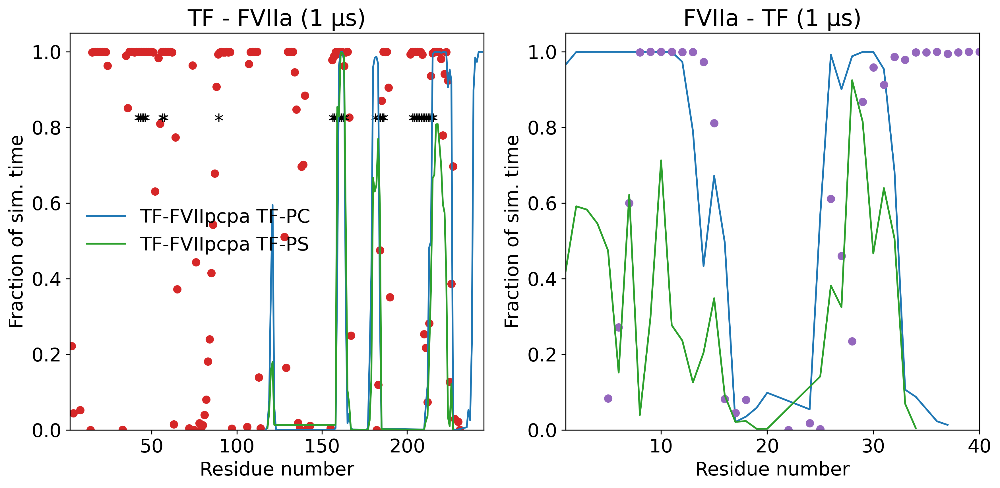

In [12]:
plt.figure( figsize = (12,6)) 
## Protein - Protein interactions --- TF - F7 pcps

 ## P-P contacts

## TF - FVIIa

file13 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/TFF7pcps_TF_F7_PP_100ps_s7_1us.dat_hist.dat.eq'
with open(file13, 'r') as fd:
    lines13 = fd.read().split()   
    counter13 = Counter(lines13)
    items13 = sorted(counter13.items(), key=lambda x: int(x[0]))
    num_items13 = np.array(items13, dtype=int)
    
    plt.subplot(121)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('TF - FVIIa (1 µs)')
    plt.scatter((num_items13[:,0]+2), (num_items13[:,1]/8466),marker='o', color='C3', zorder=2)
    #plt.ylim([0, 1])
    #plt.xlim([2, 245])  
    
    ## Comparison CL pcps (r1) -- CL (pc) -- TF-F7 (TF)(pcps)

    #plt.xlabel('Residue number')
    #plt.ylabel('Fraction of sim. time')
    #plt.title('Comp')
    #plt.plot((num_items1[:,0]+2), (num_items1[:,1]/8003),linestyle='--',color= 'C0', zorder=1, label='CLpcps_r1 PC')
    #plt.plot((num_items2[:,0]+2), (num_items2[:,1]/8003),linestyle='--',color='C2', zorder=2, label='CLpcps_r1 PS')
    #plt.plot((num_items7[:,0]+2), (num_items7[:,1]/7962),linestyle=':', color= 'C0', zorder=3, label='CLpc PC')
    plt.plot((num_itemsa[:,0]+2), (num_itemsa[:,1]/8466),color= 'C0', zorder=4, label='TF-FVIIpcpa TF-PC')
    plt.plot((num_itemsb[:,0]+2), (num_itemsb[:,1]/8466), color='C2', zorder=5, label='TF-FVIIpcpa TF-PS')
    
    plt.ylim([0, 1.05])
    plt.xlim([2, 245])       
    plt.legend(loc='best', frameon = False)
    
    plt.annotate('*', xy=(41-1.5,0.8))
    plt.annotate('*', xy=(42-1.5,0.8))
    plt.annotate('*', xy=(43-1.5,0.8))
    plt.annotate('*', xy=(44-1.5,0.8))
    plt.annotate('*', xy=(45-1.5,0.8))
    plt.annotate('*', xy=(55-1.5,0.8))
    plt.annotate('*', xy=(56-1.5,0.8))
    plt.annotate('*', xy=(88-1.5,0.8))
    plt.annotate('*', xy=(155-1.5,0.8))
    plt.annotate('*', xy=(156-1.5,0.8))
    plt.annotate('*', xy=(157-1.5,0.8))
    plt.annotate('*', xy=(158-1.5,0.8))
    plt.annotate('*', xy=(159-1.5,0.8))
    plt.annotate('*', xy=(160-1.5,0.8))
    plt.annotate('*', xy=(161-1.5,0.8))
    plt.annotate('*', xy=(162-1.5,0.8))
    plt.annotate('*', xy=(180-1.5,0.8))
    plt.annotate('*', xy=(182-1.5,0.8))
    plt.annotate('*', xy=(183-1.5,0.8))
    plt.annotate('*', xy=(184-1.5,0.8))
    plt.annotate('*', xy=(185-1.5,0.8))
    plt.annotate('*', xy=(202-1.5,0.8))
    plt.annotate('*', xy=(203-1.5,0.8))
    plt.annotate('*', xy=(204-1.5,0.8))
    plt.annotate('*', xy=(205-1.5,0.8))
    plt.annotate('*', xy=(206-1.5,0.8))
    plt.annotate('*', xy=(207-1.5,0.8))
    plt.annotate('*', xy=(208-1.5,0.8))
    plt.annotate('*', xy=(209-1.5,0.8))
    plt.annotate('*', xy=(210-1.5,0.8))
    plt.annotate('*', xy=(211-1.5,0.8))
    plt.annotate('*', xy=(212-1.5,0.8))
    plt.annotate('*', xy=(213-1.5,0.8))
    plt.annotate('*', xy=(214-1.5,0.8))

## FVIIa - TF

file14 =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/PLC/TFF7pcps_F7_TF_PP_100ps_s7_1us.dat_hist.dat.eq'

with open(file14, 'r') as fd:
    lines14 = fd.read().split()     
    counter14 = Counter(lines14)
    items14 = sorted(counter14.items(), key=lambda x: int(x[0]))
    num_items14 = np.array(items14, dtype=int)
    
    plt.subplot(122)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('FVIIa - TF (1 µs)')
    plt.scatter((num_items14[:,0]), (num_items14[:,1]/8466),marker='o', color='C4', zorder=2)
    plt.plot((num_items11[:,0]), (num_items11[:,1]/8466), color='C0', zorder=1)
    plt.plot((num_items12[:,0]), (num_items12[:,1]/8466), color='C2', zorder=2)
    plt.ylim([0, 1.05])
    plt.xlim([1, 40])     
    #plt.ylim([0, 1])
    #plt.xlim([0, 407])     

plt.tight_layout()  
#plt.savefig("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/PPC_full_report_250121.pdf", dpi=300)

plt.show() 



In [ ]:
## Generate frequencies for PDB coloring ##

## TF -- F7 pcps 
#TFpp_rn =(num_items13[:,0]+2)
#TFpp_ppc=(num_items13[:,1]/8466)
#TFppc_table=np.column_stack((TFpp_rn,TFpp_ppc))

#F7pp_rn =(num_items14[:,0]+2)
#F7pp_ppc=(num_items14[:,1]/8466)
#F7ppc_table=np.column_stack((F7pp_rn,F7pp_ppc))

#print (TFppc_table)
#print (F7ppc_table)

### TFC-x, TFC-TFN and TMD-tilt angles (TF: CLpcps r1-r3, CLpc, TF-F7 for comparison)

#### TFC-x

/home/raul/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/raul/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/raul/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `hist

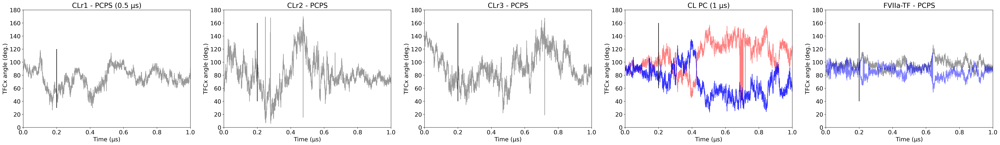

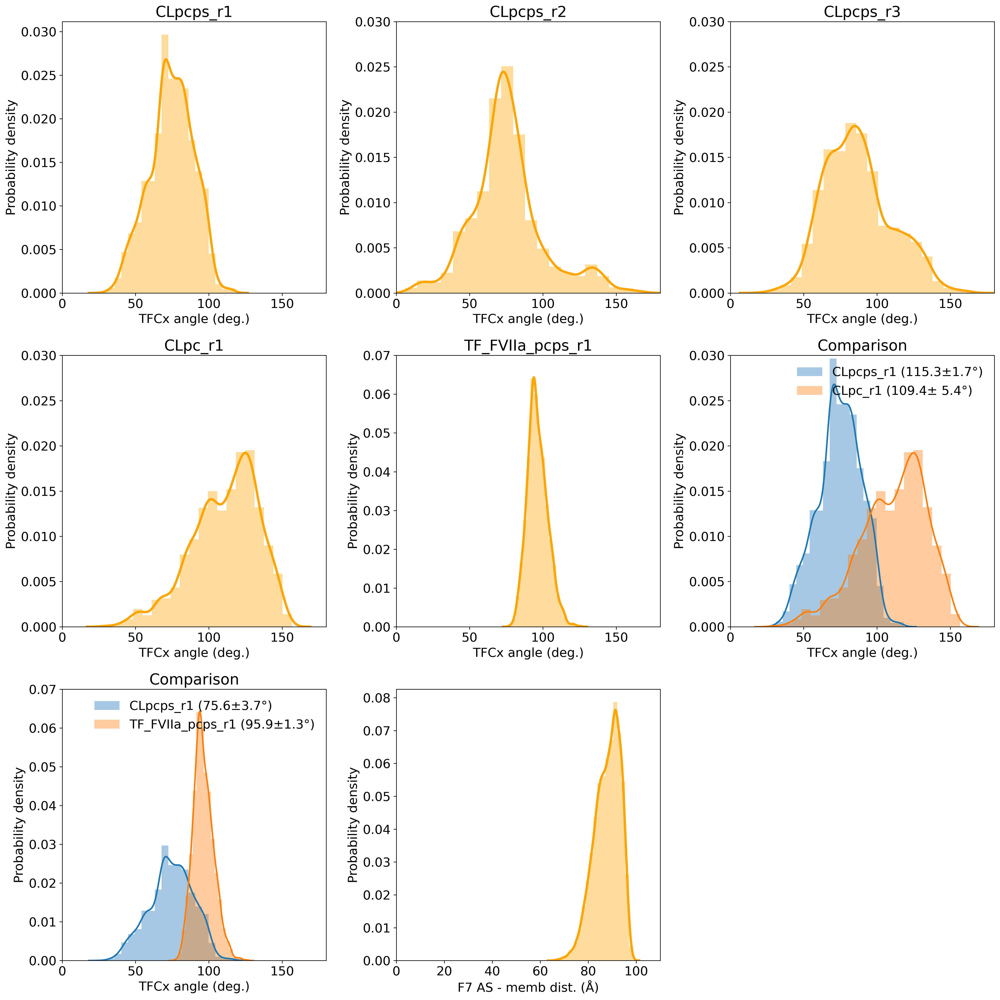

In [34]:
###### TFC-x angle ######

## PCPS ##

### CL ###

CLpsr1a= '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/CL_pcps_r1_TFCx_angle_1us_200ps.dat'

CLpsr1a_all = np.genfromtxt(CLpsr1a, usecols=(0,2))
CLpsr1a_all2 = np.genfromtxt(CLpsr1a, usecols=(0,3))
CLpsr1a_eq = np.genfromtxt(CLpsr1a, usecols=(0,2), skip_header=399)

CLpsr2a= '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/CL_pcps_r2_TFCx_angle_1us_200ps.dat'
CLpsr2a_all = np.genfromtxt(CLpsr2a, usecols=(0,2))
CLpsr2a_all2 = np.genfromtxt(CLpsr1a, usecols=(0,3))
CLpsr2a_eq = np.genfromtxt(CLpsr2a, usecols=(0,2), skip_header=399)

CLpsr3a= '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/CL_pcps_r3_TFCx_angle_1us_200ps.dat'
CLpsr3a_all = np.genfromtxt(CLpsr3a, usecols=(0,2))
CLpsr3a_all2 = np.genfromtxt(CLpsr3a, usecols=(0,3))
CLpsr3a_eq = np.genfromtxt(CLpsr3a, usecols=(0,2), skip_header=399)


### CL-PC ###

CLpcr1a= '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/CL_pc_r1_TFCx_angle_1us_200ps.dat'
CLpcr1a_all = np.genfromtxt(CLpcr1a, usecols=(0,2))
CLpcr1a_all2 = np.genfromtxt(CLpcr1a, usecols=(0,3))
CLpcr1a_eq = np.genfromtxt(CLpcr1a, usecols=(0,2), skip_header=399)

# TF-FVIIa

## PCPS ##

TF7psr1a= '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFF7_pcps_r1_TFCx_angle_1us_200ps.dat'
TF7psr1a_all = np.genfromtxt(TF7psr1a, usecols=(0,2))
TF7psr1a_all2 = np.genfromtxt(TF7psr1a, usecols=(0,3))
TF7psr1a_eq = np.genfromtxt(TF7psr1a, usecols=(0,2), skip_header=399)


#CLpsr1a_all_v2 = np.array([x*-1 if x < -0.65 else x+0 for x in CLpsr1a_all[:,1]])
#CLpsr2a_all_v2 = np.array([x*-1 if x < -0.65 else x+0 for x in CLpsr2a_all[:,1]])
#CLpsr3a_all_v2 = np.array([x*-1 if x < -0.65 else x+0 for x in CLpsr3a_all[:,1]])
#CLpcr1a_all_v2 = np.array([x*-1 if x < -0.65 else x+0 for x in CLpcr1a_all[:,1]])
#TF7psr1a_all_v2 = np.array([x*-1 if x < -0.65 else x+0 for x in TF7psr1a_all[:,1]])

#print (CLpsr1a_all_v2)
#CLpsr1a_all_v2ang= np.array([57.2958 * math.acos(x) for x in CLpsr1a_all_v2])
#CLpsr2a_all_v2ang= np.array([57.2958 * math.acos(x) for x in CLpsr2a_all_v2])
#CLpsr3a_all_v2ang= np.array([57.2958 * math.acos(x) for x in CLpsr3a_all_v2])
#CLpcr1a_all_v2ang= np.array([57.2958 * math.acos(x) for x in CLpcr1a_all_v2])
#TF7psr1a_all_v2ang= np.array([57.2958 * math.acos(x) for x in TF7psr1a_all_v2])



#print (CLpsr1a_all_v2ang)
## Rolling window avg ##

def rolling_window(a, window_size):
    shape = (a.shape[0] - window_size + 1, window_size) + a.shape[1:]
    strides = (a.strides[0],) + a.strides
    return np.lib.stride_tricks.as_strided(a, shape=shape, strides=strides)


#Rolling averages -- time evol
#ravCLpsr1=np.mean(rolling_window(CLpsr1a_all, 20), 1)
#ravCLpsr2=np.mean(rolling_window(CLpsr2a_all, 20), 1)
#ravCLpsr3=np.mean(rolling_window(CLpsr3a_all, 20), 1)
#ravCLpcr1=np.mean(rolling_window(CLpcr1a_all, 20), 1)
#ravTF7psr1=np.mean(rolling_window(TF7psr1a_all, 20), 1)

### Figure 1 - Time evol 
plt.figure(1,figsize = (48,6)) 

#CL_pcps r1-3
plt.subplot(151)
plt.plot((CLpsr1a_all[:,0]*0.0002),(CLpsr1a_all[:,1]), color='gray', alpha=0.8)
#plt.plot((CLpsr1a_all2[:,0]*0.0002),(CLpsr1a_all2[:,1]), color='blue', alpha=0.5)

#plt.plot((ravCLpsr1[:,0]*0.0002),(ravCLpsr1), color='red')
plt.xlabel('Time (µs)')
plt.xlim([0, 1])
plt.ylim([0, 180])
plt.ylabel('TFCx angle (deg.)')
plt.title('CLr1 - PCPS (0.5 µs)')
plt.vlines(0.2, 30, 120, colors='k', linestyles='solid',zorder=6)

plt.subplot(152)
plt.plot((CLpsr2a_all[:,0]*0.0002),(CLpsr2a_all[:,1]), color='gray', alpha=0.8)
#plt.plot((CLpsr2a_all2[:,0]*0.0002),(CLpsr2a_all2[:,1]), color='blue', alpha=0.5)

#plt.plot((ravCLpsr2[:,0]*0.0002),(ravCLpsr2[:,1]), color='red')
plt.xlabel('Time (µs)')
plt.xlim([0, 1])
plt.ylim([0, 180])
plt.ylabel('TFCx angle (deg.)')
plt.title('CLr2 - PCPS')
plt.vlines(0.2, 40, 160, colors='k', linestyles='solid',zorder=6)

plt.subplot(153)
plt.plot((CLpsr3a_all[:,0]*0.0002),(CLpsr3a_all[:,1]), color='gray', alpha=0.8)
#plt.plot((CLpsr3a_all2[:,0]*0.0002),(CLpsr3a_all2[:,1]), color='blue', alpha=0.5)
#plt.plot((ravCLpsr3[:,0]*0.0002),(ravCLpsr3[:,1]), color='red')
plt.xlabel('Time (µs)')
plt.xlim([0, 1])
plt.ylim([0, 180])
plt.ylabel('TFCx angle (deg.)')
plt.title('CLr3 - PCPS')
plt.vlines(0.2, 40, 160, colors='k', linestyles='solid',zorder=6)

#CLpcr1

plt.subplot(154)
plt.plot((CLpcr1a_all[:,0]*0.0002), (CLpcr1a_all[:,1]), color='red', alpha=0.5)
plt.plot((CLpcr1a_all2[:,0]*0.0002),(CLpcr1a_all2[:,1]), color='blue', alpha=0.8)

#plt.plot((ravCLpcr1[:,0]*0.0002),(ravCLpcr1[:,1]), color='red')
plt.xlabel('Time (µs)')
plt.xlim([0, 1])
plt.ylim([0, 180])
plt.ylabel('TFCx angle (deg.)')
plt.title('CL PC (1 µs)')
plt.vlines(0.2, 60, 160, colors='k', linestyles='solid',zorder=6)

#TF-FVIIapcps

plt.subplot(155)
plt.plot((TF7psr1a_all[:,0]*0.0002),(TF7psr1a_all[:,1]), color='gray', alpha=0.8)
plt.plot((TF7psr1a_all2[:,0]*0.0002),(TF7psr1a_all2[:,1]), color='blue', alpha=0.5)
#plt.plot((ravTF7psr1[:,0]*0.0002),(ravTF7psr1[:,1]), color='red')
plt.xlabel('Time (µs)')
plt.xlim([0, 1])
plt.ylim([0, 180])
plt.ylabel('TFCx angle (deg.)')
plt.title('FVIIa-TF - PCPS')
plt.vlines(0.2, 40, 160, colors='k', linestyles='solid',zorder=6)
#

### Fig.2 Prob. dist ###
plt.figure(2,figsize = (18,18)) 

plt.subplot(331)
ax=sns.distplot((CLpsr1a_eq[:,1]),bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
#sns.histplot((CLpsr1a_eq[:,1]), stat='count',bins=20,kde=True, color='orange')
lin=ax.lines[0].get_xdata().astype(int)
lin2=ax.lines[0].get_xdata(0)
lin3=ax.lines[0].get_ydata()

np.savetxt("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/Fig3e.csv", (np.c_[lin2,lin3]), delimiter=",")

#print (tabla)

plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r1')
plt.xlim([0, 180])
#plt.ylim([0, 0.03])

plt.subplot(332)
sns.distplot((CLpsr2a_eq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r2')
plt.xlim([0, 180])
plt.ylim([0, 0.03])

plt.subplot(333)
sns.distplot((CLpsr3a_eq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r3')
plt.xlim([0, 180])
plt.ylim([0, 0.03])

plt.subplot(334)
sns.distplot((CLpcr1a_eq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpc_r1')
plt.xlim([0, 180])
plt.ylim([0, 0.03])
          
plt.subplot(335)
ax3=sns.distplot((TF7psr1a_eq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('TF_FVIIa_pcps_r1')
plt.xlim([0, 180])
plt.ylim([0, 0.07])

lin21=ax3.lines[0].get_xdata(0)
lin31=ax3.lines[0].get_ydata()
np.savetxt("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/Fig5e.csv", (np.c_[lin21,lin31]), delimiter=",")



plt.subplot(336)
sns.distplot((CLpsr1a_eq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 2}  ,label='CLpcps_r1 (115.3±1.7°)')
#sns.distplot((r2_angle1_veq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
#sns.distplot((r3_angle1_veq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
sns.distplot((CLpcr1a_eq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 2} ,label='CLpc_r1 (109.4± 5.4°)')
#sns.distplot((TF7psr1a_eq[:,1]), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2},label='TF_FVIIa_pcps_r1 (118.1±1.1°)')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('Comparison')
plt.xlim([0, 180])
plt.ylim([0, 0.03])
legend(loc='best', frameon = False)

plt.subplot(337)
sns.distplot((CLpsr1a_eq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 2}  ,label='CLpcps_r1 (75.6±3.7°)')
#sns.distplot((r2_angle1_veq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
#sns.distplot((r3_angle1_veq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
#sns.distplot((CLpcr1a_eq[:,1]), bins=20, hist =False, kde = True, kde_kws = {'linewidth': 2} ,label='CLpc_r1 (115.9±1.1°)')
sns.distplot((TF7psr1a_eq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 2},label='TF_FVIIa_pcps_r1 (95.9±1.3°)')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('Comparison')
plt.xlim([0, 180])
plt.ylim([0, 0.07])
legend(loc='best', frameon = False)

## F7 AS dist ##

file_AS =  '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/AS/TFF7pcps_F7_ASdist_100ps_s7_1us.dat'

ASdz = np.genfromtxt(file_AS, usecols=(0,4))

## Eq
ASdz_eq = np.genfromtxt(file_AS, usecols=(0,4),skip_header=399)

## Fig ##

#CLpcps
#dasz=ASdz
#madasz=np.mean(rolling_window(dasz, 20), 1)
#plt.subplot(121)
#plt.plot((dasz[:,0]*0.0001),(dasz[:,1]), color='gray', alpha=0.5)
#plt.plot((madasz[:,0]*0.0001),(madasz[:,1]), color='red')
#plt.xlabel('Time (µs)')
#plt.xlim([0, 1])
#plt.ylim([60, 110])
#plt.ylabel('F7 AS - memb dist. (Å)')
##plt.title('FVIIa-TF - PCPS (0.5 µs)')
#plt.vlines(0.2, 60, 120, colors='k', linestyles='solid',zorder=6)

dasz_eq=ASdz_eq
plt.subplot(338)
ax4=sns.distplot((dasz_eq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('F7 AS - memb dist. (Å)')
plt.ylabel('Probability density')
#plt.title('FVIIa-TF - PCPS (0.5 µs)')
plt.xlim([0, 110])
#plt.ylim([0, 0.07])

lin22=ax4.lines[0].get_xdata(0)
lin32=ax4.lines[0].get_ydata()

np.savetxt("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/Fig5f.csv", (np.c_[lin22,lin32]), delimiter=",")



plt.tight_layout()  
#plt.savefig("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/TFCx_Angle_F7ASd_report140421.pdf", dpi=300)
plt.show()



CLpcps_R1
75.61182736494797 3.702751392292741


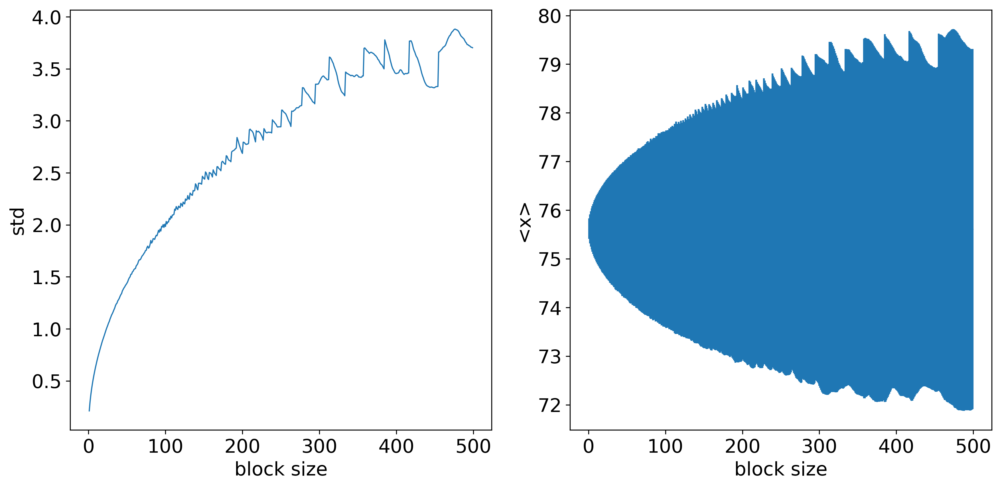

94.84761364773051 3.3622172041417793


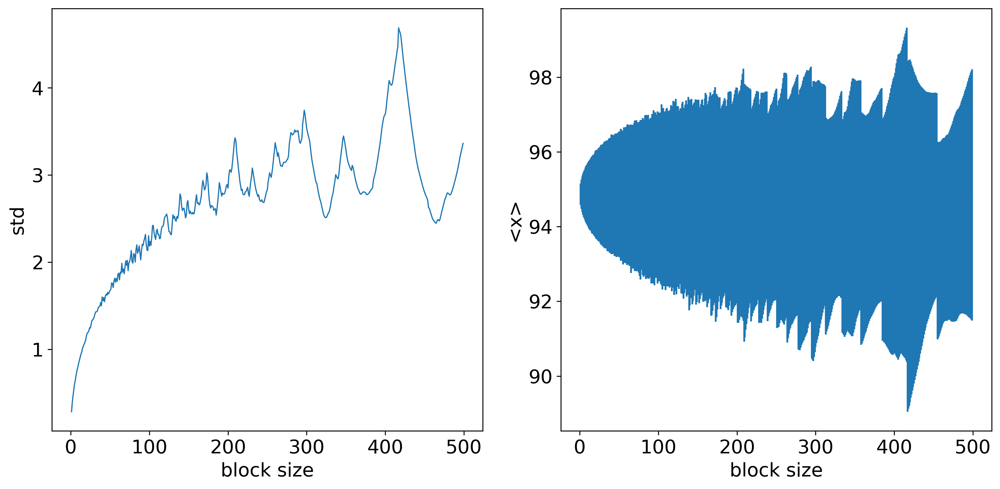

CLpcps_R2
78.9188667176743 6.11390238876359


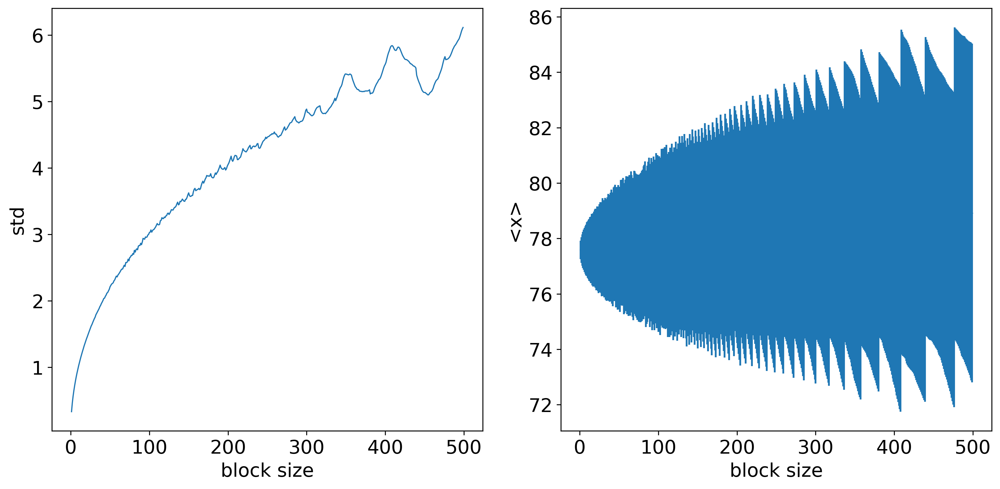

94.84761364773051 3.3622172041417793


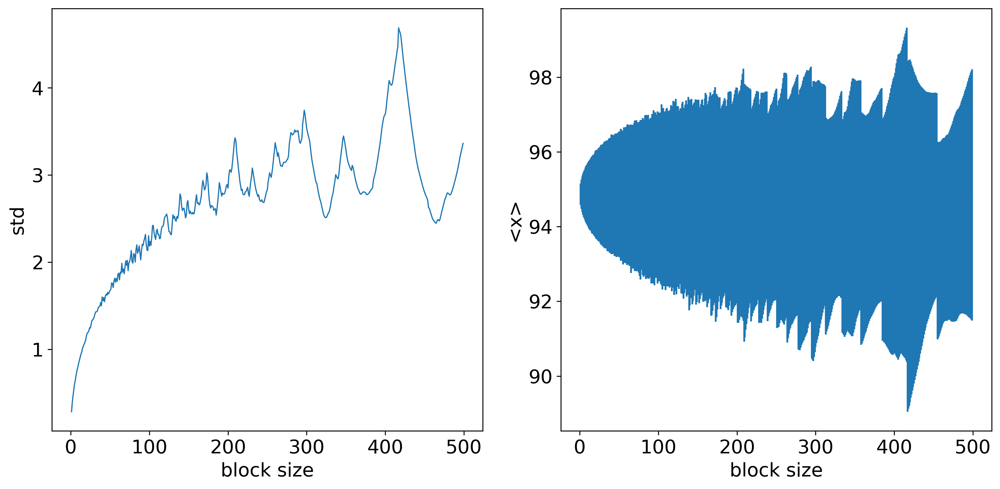

CLpcps R3
90.29737183451087 5.98640433194032


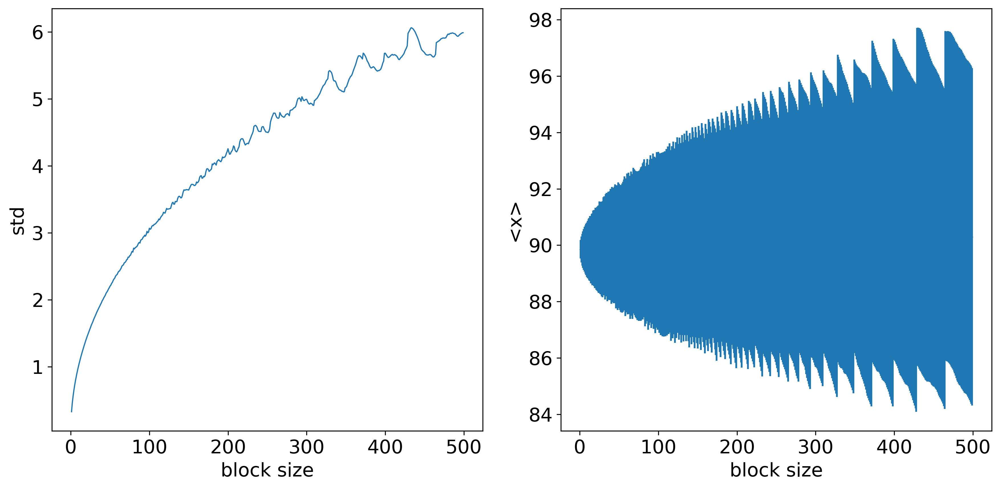

93.82701082079453 4.115736740634238


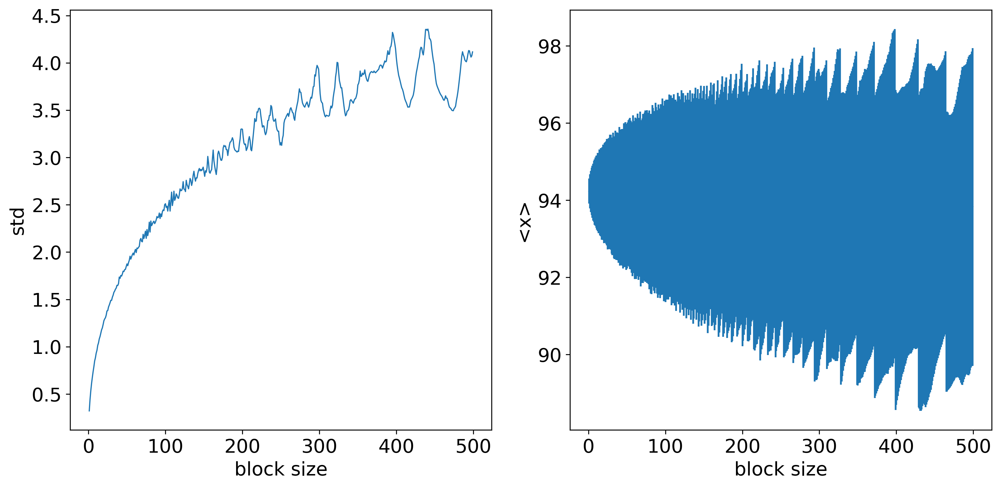

CLpc
109.40123537615823 5.353996777093269


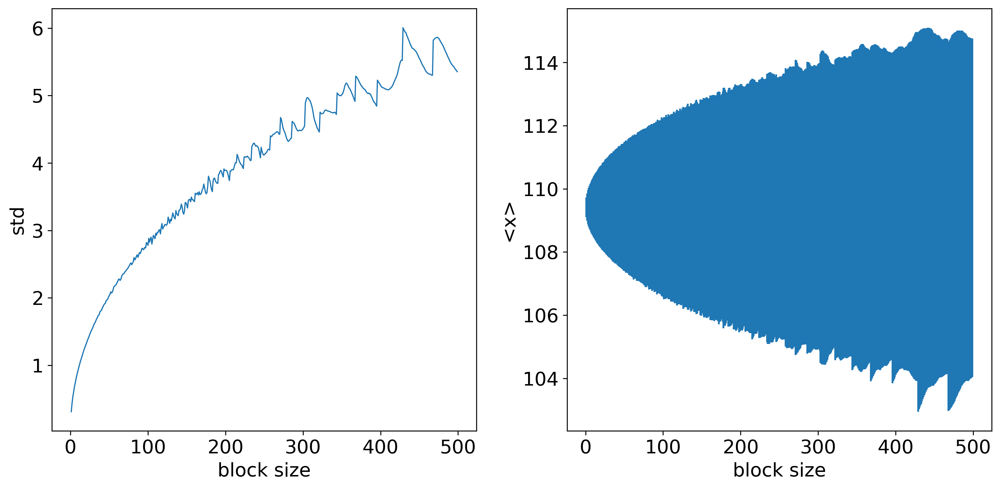

69.76953882702817 5.721289069874279


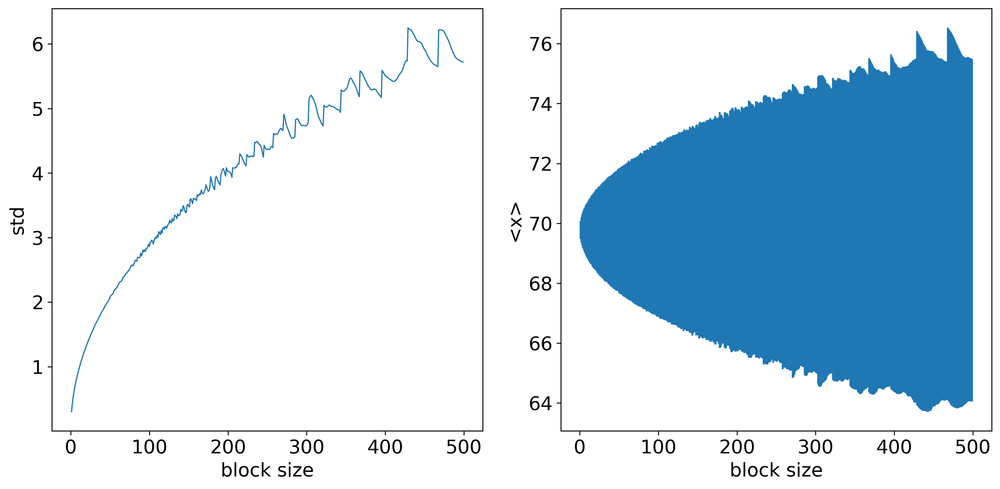

TFF7pcps
95.86880126785573 1.2466707306810847


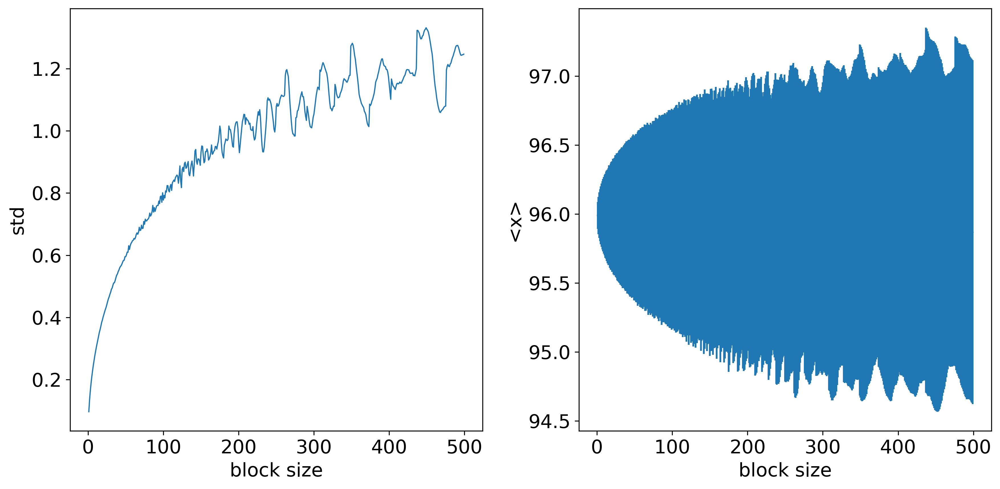

85.41762970115276 1.3461976614002298


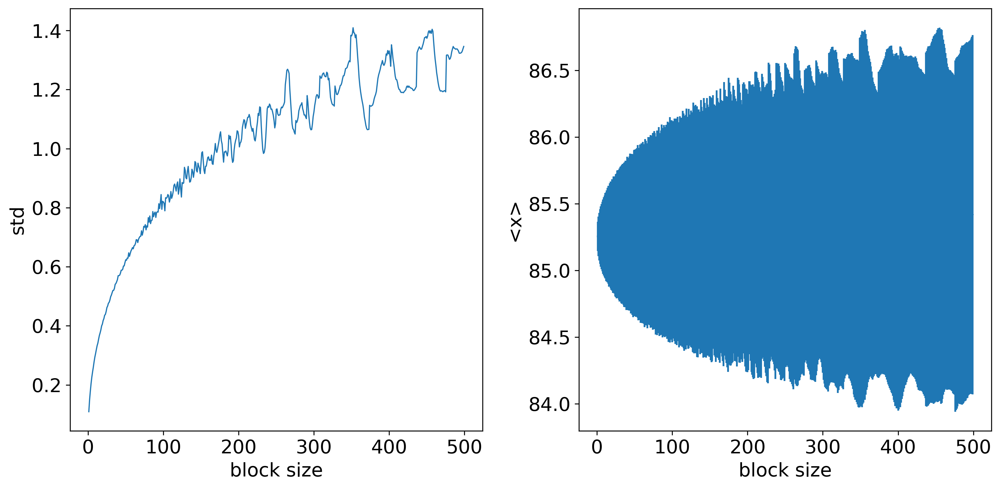

In [3]:
## Block analysis for TFC-TFN angle ##
print ('CLpcps_R1')
blockAverage(CLpsr1a_all[:,1],maxBlockSize=500)
blockAverage(CLpsr1a_all2[:,1],maxBlockSize=500)
print ('CLpcps_R2')
blockAverage(CLpsr2a_all[:,1],maxBlockSize=500)
blockAverage(CLpsr2a_all2[:,1],maxBlockSize=500)
print ('CLpcps R3')
blockAverage(CLpsr3a_all[:,1],maxBlockSize=500)
blockAverage(CLpsr3a_all2[:,1],maxBlockSize=500)
#blockAverage(r3_angle1_veq2,maxBlockSize=700)
print ('CLpc')
blockAverage(CLpcr1a_all[:,1],maxBlockSize=500)
blockAverage(CLpcr1a_all2[:,1],maxBlockSize=500)

print ('TFF7pcps')
blockAverage(TF7psr1a_all[:,1],maxBlockSize=500)
blockAverage(TF7psr1a_all2[:,1],maxBlockSize=500)

#### TFC-TFN angle

/home/raul/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/raul/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/raul/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `hist

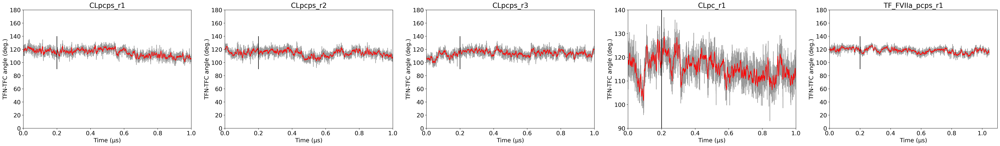

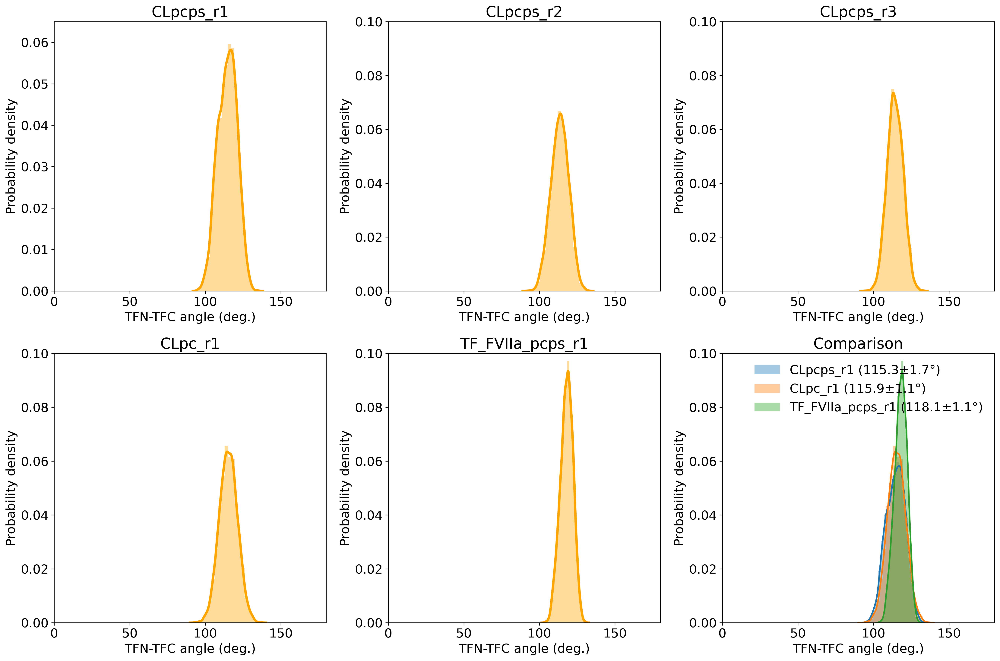

In [33]:
###### TFC-TFN angle #######

#### CL - PCPS ####

#R1
r1C = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/CL_PCPSna_r1_TFN_TFCal_angle_1us_200ps_zalPC_nc.dat'
r1N = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/CL_PCPSna_r1_TFN_TFCal_angle_1us_200ps_zalPN_nc.dat'

# Angle
r1_angle1_v = np.genfromtxt(r1C, usecols=(1))
r1_angle1eq_v = np.genfromtxt(r1C, usecols=(1),skip_header=399)

r1_angle1_t = np.genfromtxt(r1C, usecols=(0))
r1_angle1eq_t = np.genfromtxt(r1C, usecols=(0),skip_header=399)
                   
r1_angle1_v2 = np.array([180-x if x < 90 else x+0 for x in r1_angle1_v])
r1_angle1_veq2 = [180-x if x < 90 else x+0 for x in r1_angle1eq_v]

#Rolling averages -- time evol
rav_r1_angle1v=np.mean(rolling_window(r1_angle1_v2, 20), 1)
rav_r1_angle1t=np.mean(rolling_window(r1_angle1_t, 20), 1)

#r2

r2C = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/CL_PCPSna_r2_TFN_TFCal_angle_1us_200ps_zalPC.dat'
r2N = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/CL_PCPSna_r2_TFN_TFCal_angle_1us_200ps_zalPN.dat'

# Angle
r2_angle1_v = np.genfromtxt(r2C, usecols=(1))
r2_angle1eq_v = np.genfromtxt(r2C, usecols=(1),skip_header=399)

r2_angle1_t = np.genfromtxt(r2C, usecols=(0))
r2_angle1eq_t = np.genfromtxt(r2C, usecols=(0),skip_header=399)


r2_angle1_v2 = np.array([180-x if x < 90 else x+0 for x in r2_angle1_v ])
r2_angle1_veq2 = [180-x if x < 90 else x+0 for x in r2_angle1eq_v ]

#Rolling averages -- time evol
rav_r2_angle1v=np.mean(rolling_window(r2_angle1_v2, 20), 1)
rav_r2_angle1t=np.mean(rolling_window(r2_angle1_t, 20), 1)

#r3

r3C = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/CL_PCPSna_r3_TFN_TFCal_angle_1us_200ps_zalPC.dat'
r3N = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/CL_PCPSna_r3_TFN_TFCal_angle_1us_200ps_zalPN.dat'

r3_angle1_v = np.genfromtxt(r3C, usecols=(1))
r3_angle1eq_v = np.genfromtxt(r3C, usecols=(1),skip_header=399)

r3_angle1_t = np.genfromtxt(r3C, usecols=(0))
r3_angle1eq_t = np.genfromtxt(r3C, usecols=(0),skip_header=399)
                   
r3_angle1_v2 = np.array([180-x if x < 90 else x+0 for x in r3_angle1_v ])
r3_angle1_veq2 = [180-x if x < 90 else x+0 for x in r3_angle1eq_v ]

#Rolling averages -- time evol
rav_r3_angle1v=np.mean(rolling_window(r3_angle1_v2, 20), 1)
rav_r3_angle1t=np.mean(rolling_window(r3_angle1_t, 20), 1)

#### CL PC ####

#files

clpcC = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/CL_PC_TFN_TFCal_angle_1us_200ps_zalPC_nc.dat'
clpcN = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/CL_PC_TFN_TFCal_angle_1us_200ps_zalPN_nc.dat'

# Angle
clpc_angle1_v = np.genfromtxt(clpcC, usecols=(1))
clpc_angle1eq_v = np.genfromtxt(clpcC, usecols=(1),skip_header=399)

clpc_angle1_t = np.genfromtxt(clpcC, usecols=(0))
clpc_angle1eq_t = np.genfromtxt(clpcC, usecols=(0),skip_header=399)
                        
clpc_angle1_v2 = np.array([180-x if x < 90 else x+0 for x in clpc_angle1_v])
clpc_angle1_veq2 = [180-x if x < 90 else x+0 for x in clpc_angle1eq_v ]

#Rolling averages -- time evol
rav_clpc_angle1v=np.mean(rolling_window(clpc_angle1_v2, 20), 1)
rav_clpc_angle1t=np.mean(rolling_window(clpc_angle1_t, 20), 1)
                         
#TF-F7 pcps 

tff7_C = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/TFF7_PCPS_TFN_TFCal_angle_1us_200ps_zalPCnc.dat'
tff7_N = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TFN_TFC_test/TFF7_PCPS_TFN_TFCal_angle_1us_200ps_zalPNnc.dat'

# Angle
tff7_angle1_v = np.genfromtxt(tff7_C, usecols=(1))
tff7_angle1eq_v = np.genfromtxt(tff7_C, usecols=(1),skip_header=399)

tff7_angle1_t = np.genfromtxt(tff7_C, usecols=(0))
tff7_angle1eq_t = np.genfromtxt(tff7_C, usecols=(0),skip_header=399)  
                        
tff7_angle1_v2 = np.array([180-x if x < 90 else x+0 for x in tff7_angle1_v])
tff7_angle1_veq2 = [180-x if x < 90 else x+0 for x in tff7_angle1eq_v ]
 
#Rolling averages -- time evol
rav_tff7_angle1_v=np.mean(rolling_window(tff7_angle1_v2, 20), 1)
rav_tff7_angle1_t=np.mean(rolling_window(tff7_angle1_t, 20), 1)

### Figure 1 - Time evol 
plt.figure(1,figsize = (48,6)) 

plt.subplot(151)
plt.plot((r1_angle1_t*0.0002),(r1_angle1_v2), color='gray', alpha=0.8)
plt.plot((rav_r1_angle1t*0.0002),(rav_r1_angle1v), color='red', alpha=1)
plt.ylim([0, 180])
plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TFN-TFC angle (deg.)')
plt.title('CLpcps_r1')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(152)
plt.plot((r2_angle1_t*0.0002),(r2_angle1_v2), color='gray', alpha=0.8)
plt.plot((rav_r2_angle1t*0.0002),(rav_r2_angle1v), color='red', alpha=1)
plt.ylim([0, 180])
plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TFN-TFC angle (deg.)')
plt.title('CLpcps_r2')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(153)
plt.plot((r3_angle1_t*0.0002),(r3_angle1_v2), color='gray', alpha=0.8)
plt.plot((rav_r3_angle1t*0.0002),(rav_r3_angle1v), color='red', alpha=1)
plt.ylim([0, 180])
plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TFN-TFC angle (deg.)')
plt.title('CLpcps_r3')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(154)
plt.plot((clpc_angle1_t*0.0002),(clpc_angle1_v2), color='gray', alpha=0.8)
plt.plot((rav_clpc_angle1t*0.0002),(rav_clpc_angle1v), color='red', alpha=1)
plt.ylim([90, 140])
plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TFN-TFC angle (deg.)')
plt.title('CLpc_r1')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(155)
plt.plot((tff7_angle1_t*0.0002),(tff7_angle1_v2), color='gray', alpha=0.8)
plt.plot((rav_tff7_angle1_t*0.0002),(rav_tff7_angle1_v), color='red', alpha=1)
plt.ylim([0, 180])
plt.xlim([0, 1.1])
plt.xlabel('Time (µs)')
plt.ylabel('TFN-TFC angle (deg.)')
plt.title('TF_FVIIa_pcps_r1')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

### Fig.2 Prob. dist ###
plt.figure(2,figsize = (18,12)) 
          
plt.subplot(231)
ax2=sns.distplot((r1_angle1_veq2 ), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')

#lin=ax2.lines[0].get_xdata().astype(int)
lin2=ax2.lines[0].get_xdata(0)
lin3=ax2.lines[0].get_ydata()

np.savetxt("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/Fig3f.csv", (np.c_[lin2,lin3]), delimiter=",")

plt.xlabel('TFN-TFC angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r1')
plt.xlim([0, 180])
plt.ylim([0, 0.065])

plt.subplot(232)
sns.distplot((r2_angle1_veq2 ), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TFN-TFC angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r2')
plt.xlim([0, 180])
plt.ylim([0, 0.1])

plt.subplot(233)
sns.distplot((r3_angle1_veq2 ), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TFN-TFC angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r3')
plt.xlim([0, 180])
plt.ylim([0, 0.1])

plt.subplot(234)
sns.distplot((clpc_angle1_veq2), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TFN-TFC angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpc_r1')
plt.xlim([0, 180])
plt.ylim([0, 0.1])
          
plt.subplot(235)
sns.distplot((tff7_angle1_veq2), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TFN-TFC angle (deg.)')
plt.ylabel('Probability density')
plt.title('TF_FVIIa_pcps_r1')
plt.xlim([0, 180])
plt.ylim([0, 0.1])

plt.subplot(236)
sns.distplot((r1_angle1_veq2), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 2}  ,label='CLpcps_r1 (115.3±1.7°)')
#sns.distplot((r2_angle1_veq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
#sns.distplot((r3_angle1_veq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
sns.distplot((clpc_angle1_veq2), bins=20, hist =True, kde = True, kde_kws = {'linewidth': 2} ,label='CLpc_r1 (115.9±1.1°)')
sns.distplot((tff7_angle1_veq2), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 2},label='TF_FVIIa_pcps_r1 (118.1±1.1°)')
plt.xlabel('TFN-TFC angle (deg.)')
plt.ylabel('Probability density')
plt.title('Comparison')
plt.xlim([0, 180])
plt.ylim([0, 0.1])
legend(loc='best', frameon = False)

plt.tight_layout()  
#plt.savefig("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/TFN_TFC_angle_report_140421.pdf", dpi=300)
plt.show()



In [ ]:
## Block analysis for TFC-TFN angle ##
print ('CLpcps_R1')
blockAverage(r1_angle1_veq2,maxBlockSize=700)
print ('CLpcps_R2')
blockAverage(r2_angle1_veq2,maxBlockSize=700)
print ('CLpcps R3')
blockAverage(r3_angle1_veq2,maxBlockSize=700)
print ('CLpc')
blockAverage(clpc_angle1_veq2,maxBlockSize=700)
print ('TFF7pcps')
blockAverage(tff7_angle1_veq2,maxBlockSize=700)

#### TMD-tilt angle 

/home/raul/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/raul/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/raul/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `hist

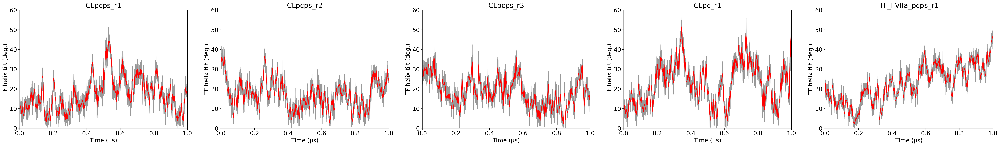

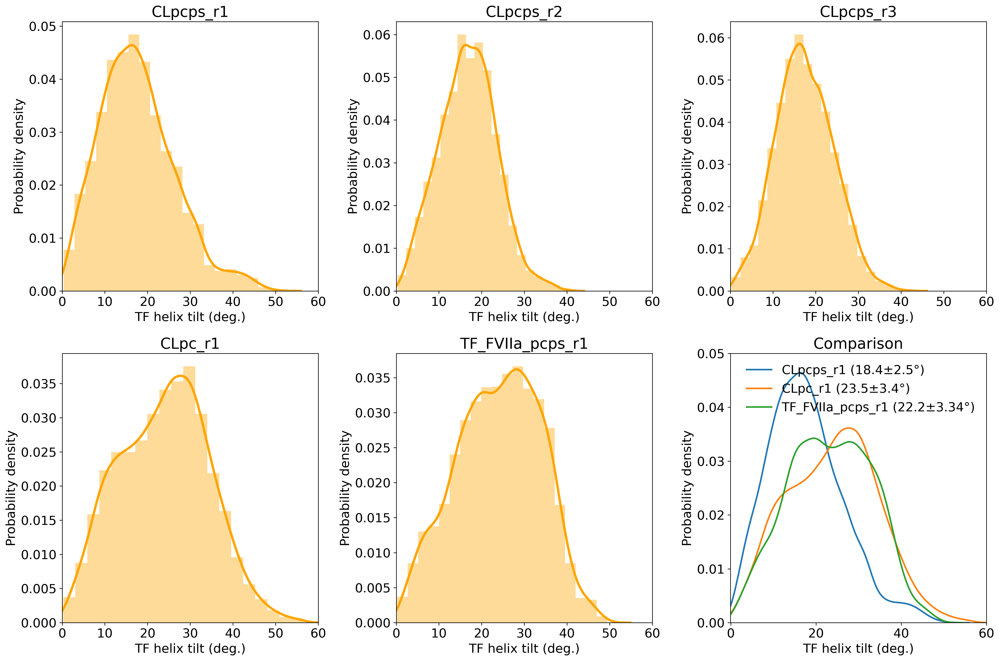

In [5]:
##### TMD-tilt angle ####

#### CL - PCPS ####

#R1
r1 = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TMDtilt/CL_PCPS_r1_TMDtilt_200ps.dat'

# Angle
r1_tilt  = np.genfromtxt(r1, usecols=(0,2))
r1_tilteq  = np.genfromtxt(r1, usecols=(0,2),skip_header=399)

#Rolling averages -- time evol
rav_r1_tilt =np.mean(rolling_window(r1_tilt,20), 1)


#r2

r2 = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TMDtilt/CL_PCPS_r2_TMDtilt_200ps.dat'

# Angle
r2_tilt  = np.genfromtxt(r2, usecols=(0,2))
r2_tilteq  = np.genfromtxt(r2, usecols=(0,2),skip_header=399)

#Rolling averages -- time evol
rav_r2_tilt =np.mean(rolling_window(r2_tilt,20), 1)


#r3

r3 = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TMDtilt/CL_PCPS_r3_TMDtilt_200ps.dat'

r3_tilt  = np.genfromtxt(r3, usecols=(0,2))
r3_tilteq  = np.genfromtxt(r3, usecols=(0,2),skip_header=399)

#Rolling averages -- time evol
rav_r3_tilt =np.mean(rolling_window(r3_tilt,20), 1)

#### CL PC ####

#files

clpc = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TMDtilt/CL_PC_TMDtilt_200ps.dat'

# Angle
clpc_tilt  = np.genfromtxt(clpc, usecols=(0,2))
clpc_tilteq  = np.genfromtxt(clpc, usecols=(0,2),skip_header=399)

#Rolling averages -- time evol
rav_clpc_tilt =np.mean(rolling_window(clpc_tilt,20), 1)

                         
#TF-F7 pcps 

tff7 = '/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/angle/TMDtilt/TFF7_PCPS_r1_TMDtilt_200ps.dat'

# Angle
tff7_tilt  = np.genfromtxt(tff7, usecols=(0,2))
tff7_tilteq  = np.genfromtxt(tff7, usecols=(0,2),skip_header=399)


#Rolling averages -- time evol
rav_tff7_tilt =np.mean(rolling_window(tff7_tilt,20), 1)

### Figure 1 - Time evol 
plt.figure(1,figsize = (48,6)) 

plt.subplot(151)
plt.plot((r1_tilt[:,0]*0.0002),(r1_tilt[:,1]), color='gray', alpha=0.8)
plt.plot((rav_r1_tilt[:,0]*0.0002),(rav_r1_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('CLpcps_r1')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(152)
plt.plot((r2_tilt[:,0]*0.0002),(r2_tilt[:,1]), color='gray', alpha=0.8)
plt.plot((rav_r2_tilt[:,0]*0.0002),(rav_r2_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('CLpcps_r2')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(153)
plt.plot((r3_tilt[:,0]*0.0002),(r3_tilt[:,1]), color='gray', alpha=0.8)
plt.plot((rav_r3_tilt[:,0]*0.0002),(rav_r3_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('CLpcps_r3')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(154)
plt.plot((clpc_tilt[:,0]*0.0002),(clpc_tilt[:,1]), color='gray', alpha=0.8)
plt.plot((rav_clpc_tilt[:,0]*0.0002),(rav_clpc_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('CLpc_r1')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(155)
plt.plot((tff7_tilt[:,0]*0.0002),(tff7_tilt[:,1]), color='gray', alpha=0.8)
plt.plot((rav_tff7_tilt[:,0]*0.0002),(rav_tff7_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('TF_FVIIa_pcps_r1')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

### Fig.2 Prob. dist ###
plt.figure(2,figsize = (18,12)) 
          
plt.subplot(231)
sns.distplot((r1_tilteq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r1')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])

plt.subplot(232)
sns.distplot((r2_tilteq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r2')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])

plt.subplot(233)
sns.distplot((r3_tilteq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r3')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])

plt.subplot(234)
sns.distplot((clpc_tilteq[:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('CLpc_r1')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])
          
plt.subplot(235)
sns.distplot((tff7_tilteq [:,1]), bins=20, hist = True, kde = True, kde_kws = {'linewidth': 3}, color='orange')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('TF_FVIIa_pcps_r1')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])

plt.subplot(236)
sns.distplot((r1_tilteq[:,1]), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2}  ,label='CLpcps_r1 (18.4±2.5°)')
#sns.distplot((r2_tilt eq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
#sns.distplot((r3_tilt eq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
sns.distplot((clpc_tilteq[:,1]), bins=20, hist =False, kde = True, kde_kws = {'linewidth': 2} ,label='CLpc_r1 (23.5±3.4°)')
sns.distplot((tff7_tilt[:,1]), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2},label='TF_FVIIa_pcps_r1 (22.2±3.34°)')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('Comparison')
plt.xlim([-0.1, 60])
plt.ylim([0, 0.05])
legend(loc='best', frameon = False)

plt.tight_layout()  
#plt.savefig("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/TF_helix_angle_report_020221.pdf", dpi=300)
plt.show()

In [ ]:
## Block analysis for TFC-TFN angle ##
print ('CLpcps_R1')
blockAverage(r1_tilteq[:,1],maxBlockSize=700)
print ('CLpcps_R2')
blockAverage(r2_tilteq[:,1],maxBlockSize=700)
print ('CLpcps R3')
blockAverage(r2_tilteq[:,1],maxBlockSize=700)
print ('CLpc')
blockAverage(clpc_tilteq[:,1],maxBlockSize=700)
print ('TFF7pcps')
blockAverage(tff7_tilteq[:,1],maxBlockSize=700)

## PS density map

In [ ]:
# CL PCPS

TFCL_PS   = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/CL_1us_pcps_s200ns_200ps_HGPSdens.dx')
TFCL_prot = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/CL_1us_pcps_s200ns_200ps_TFdens1A.dx')
TFCL_ECD  = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/CL_1us_pcps_s200ns_200ps_ECDdens1A.dx')
TFCL_TMD  = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/CL_1us_pcps_s200ns_200ps_TMDdens1A.dx')

TF_F7_pcps  = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/FVIIaTFcl_pcps1us_pcps_s200ns_200ps_HGPSdens.dx')
TF_F7_prot  = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/FVIIaTFcl_pcps1us_pcps_s200ns_200ps_PROTdens1A.dx')
TF_F7_TFecd = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/FVIIaTFcl_pcps1us_pcps_s200ns_200ps_TFECD1Adens.dx')
TF_F7_F7    = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/FVIIaTFcl_pcps1us_pcps_s200ns_200ps_F7dens1A.dx')
#TF_F7_TF    = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/')
TF_F7_TMD   = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/FVIIaTFcl_pcps1us_pcps_s200ns_200ps_TMDdens1A.dx')



In [ ]:
norm = cm.colors.Normalize(vmax=0.11)
norm2 = cm.colors.Normalize(vmax=0.08)
plt.figure( figsize = (14,6) )

#plt.subplot(121)
#grid1 = TFCL_ECD.grid
#sum_vec1 = np.sum(grid1, axis=2)
#rotX = np.rot90(sum_vecX)    
#cfE = plt.contourf(rotE, origin='upper', levels=10, cmap = 'coolwarm',extend='max')
#cfX = plt.contourf(sum_vec1, origin='upper', levels=10, cmap = 'coolwarm',extend='max')
#plt.colorbar( cfX )
#plt.title('TF + PCPS avg. PS_hg dens.(xy)')
#plt.xlim([10, 130])
#plt.ylim([20, 150])

plt.subplot(121)
gridX = TFCL_PS.grid
sum_vecX = np.sum(gridX, axis=2)
rotX = np.rot90(sum_vecX)    
#cfE = plt.contourf(rotX, origin='upper', levels=10, cmap = 'coolwarm',extend='max')
cfX = plt.contourf(sum_vecX, origin='upper', levels=10, cmap = 'coolwarm',extend='max', norm=norm)
plt.colorbar( cfX )
plt.title('TF + PCPS avg. PS_hg dens.(xy)')
plt.xlim([15, 125])
plt.ylim([20, 148])

#####
#plt.subplot(223)
#grid2 = TF_F7_prot.grid
#sum_vec2 = np.sum(grid2, axis=2)
#rotX = np.rot90(sum_vecX)    
#cfE = plt.contourf(rotE, origin='upper', levels=10, cmap = 'coolwarm',extend='max')
#cfX = plt.contourf(sum_vec2, origin='upper', levels=10, cmap = 'coolwarm',extend='max')
#plt.colorbar( cfX )
#plt.title('TF + PCPS avg. PS_hg dens.(xy)')
#plt.xlim([10, 130])
#plt.ylim([20, 150])

plt.subplot(122)
gridY = TF_F7_pcps.grid
sum_vecY = np.sum(gridY, axis=2)
#rotX = np.rot90(sum_vecX)    
#cfE = plt.contourf(rotE, origin='upper', levels=10, cmap = 'coolwarm',extend='max')
cfY = plt.contourf(sum_vecY, origin='upper', levels=10, cmap = 'coolwarm',extend='max', norm=norm2)
plt.colorbar( cfY )
plt.title('FVIIa-TF + PCPS avg. PC_hg dens.(xy)')
plt.xlim([15, 140])
plt.ylim([15, 140])

plt.tight_layout()  
plt.savefig("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/PS_dens_maps_020221.pdf", dpi=300)
plt.show()

## 21/02/2022 Re-do of angle analysis
Calculate again TFC-membrane and TFC-TFN angles. This time using the same definition for TFC-Memb. as used in Ohkubo et al. 2010.
Also include a calculation of tilt, skew and twist angles for TFN over TFN and of ECD over memb.

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figur

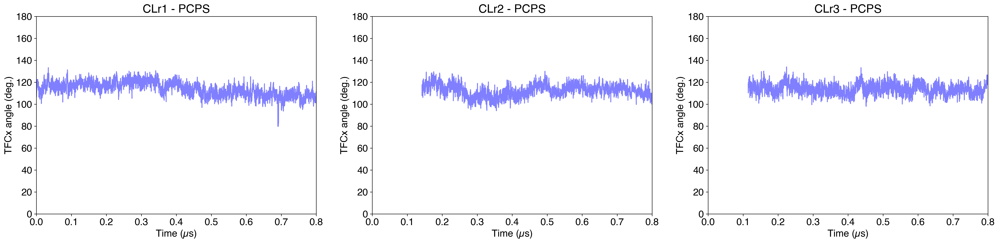

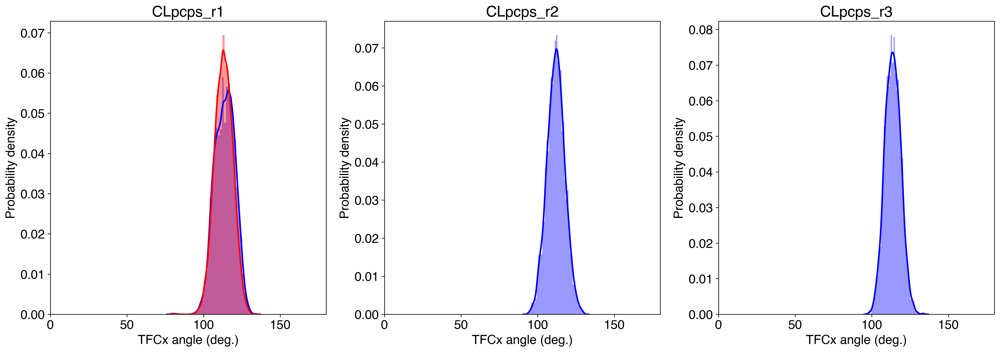

In [102]:
## TFN-TFC angle

CLpsr1a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R1_200ps.dat'

CLpsr1a_all = np.genfromtxt(CLpsr1a, usecols=(0,1))
#CLpsr1a_all2 = np.genfromtxt(CLpsr1a, usecols=(0,1))
CLpsr1a_eq = np.genfromtxt(CLpsr1a, usecols=(0,1))


CLpsr2a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R2_200ps.dat'
CLpsr2a_all = np.genfromtxt(CLpsr2a, usecols=(0,2))
CLpsr2a_eq = np.genfromtxt(CLpsr2a, usecols=(0,2), skip_header=711)


CLpsr3a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R3_200ps.dat'
CLpsr3a_all = np.genfromtxt(CLpsr3a, usecols=(0,1))
CLpsr3a_eq = np.genfromtxt(CLpsr3a, usecols=(0,1), skip_header=573)


CLpsr1a_eq_v2 = np.array([180-x for x in CLpsr1a_eq[:,1]])
CLpsr2a_eq_v2 = np.array([180-x if x < 90 else x+0 for x in CLpsr2a_eq[:,1]])
CLpsr3a_eq_v2 = np.array([180-x if x < 90 else x+0 for x in CLpsr3a_eq[:,1]])


## Rolling window avg ##

def rolling_window(a, window_size):
    shape = (a.shape[0] - window_size + 1, window_size) + a.shape[1:]
    strides = (a.strides[0],) + a.strides
    return np.lib.stride_tricks.as_strided(a, shape=shape, strides=strides)


#Rolling averages -- time evol
ravCLpsr1=np.mean(rolling_window(CLpsr1a_eq, 20), 1)
ravCLpsr2=np.mean(rolling_window(CLpsr2a_eq, 20), 1)
ravCLpsr3=np.mean(rolling_window(CLpsr3a_eq, 20), 1)

#ravCLpsr1m=np.mean(rolling_window(CLpsr1a_eqm, 20), 1)
#ravCLpsr2m=np.mean(rolling_window(CLpsr2a_eqm, 20), 1)
#ravCLpsr3m=np.mean(rolling_window(CLpsr3a_eqm, 20), 1)

ang_all=np.concatenate((CLpsr1a_eq_v2,CLpsr2a_eq_v2,CLpsr3a_eq_v2),axis=0)

### Figure 1 - Time evol 
plt.figure(1,figsize = (48,6)) 

#CL_pcps r1-3
plt.subplot(151)
#plt.plot((CLpsr1a_eq[:,0]*0.0002),(CLpsr1a_eq[:,1]), color='gray', alpha=0.8)
plt.plot((CLpsr1a_eq[:,0]*0.0002),(CLpsr1a_eq_v2), color='blue', alpha=0.5)
#plt.plot((ravCLpsr1[:,0]*0.0002),(ravCLpsr1[:,1]), color='red')
plt.xlabel('Time (µs)')
plt.xlim([0, 0.8])
plt.ylim([0, 180])
plt.ylabel('TFCx angle (deg.)')
plt.title('CLr1 - PCPS')
#plt.vlines(0.2, 30, 120, colors='k', linestyles='solid',zorder=6)

plt.subplot(152)
#plt.plot((CLpsr2a_eq[:,0]*0.0002),(CLpsr2a_eq[:,1]), color='gray', alpha=0.8)
plt.plot((CLpsr2a_eq[:,0]*0.0002),(CLpsr2a_eq_v2), color='blue', alpha=0.5)
#plt.plot((ravCLpsr2[:,0]*0.0002),(ravCLpsr2[:,1]), color='red')
plt.xlabel('Time (µs)')
plt.xlim([0, 0.8])
plt.ylim([0, 180])
plt.ylabel('TFCx angle (deg.)')
plt.title('CLr2 - PCPS')
#plt.vlines(0.2, 40, 160, colors='k', linestyles='solid',zorder=6)

plt.subplot(153)
#plt.plot((CLpsr3a_eq[:,0]*0.0002),(CLpsr3a_eq[:,1]), color='gray', alpha=0.8)
plt.plot((CLpsr3a_eq[:,0]*0.0002),(CLpsr3a_eq_v2), color='blue', alpha=0.5)
#plt.plot((CLpsr3a_eqm[:,0]*0.0002),(CLpsr3a_eqm[:,1]), color='blue', alpha=0.5)
#plt.plot((ravCLpsr3[:,0]*0.0002),(ravCLpsr3[:,1]), color='red')
plt.xlabel('Time (µs)')
plt.xlim([0, 0.8])
plt.ylim([0, 180])
plt.ylabel('TFCx angle (deg.)')
plt.title('CLr3 - PCPS')
#plt.vlines(0.2, 40, 160, colors='k', linestyles='solid',zorder=6)

### Fig.2 Prob. dist ###
plt.figure(2,figsize = (18,18)) 

plt.subplot(331)
#ax=sns.distplot((CLpsr1a_eq[:,1]),bins=40, hist = True, kde = True, kde_kws = {'linewidth': 2}, color='orange')
ax=sns.distplot((CLpsr1a_eq_v2),bins=40, hist = True, kde = True, kde_kws = {'linewidth': 2}, color='blue')
ax=sns.distplot((ang_all),bins=40, hist = True, kde = True, kde_kws = {'linewidth': 2}, color='red')

#sns.histplot((CLpsr1a_eq[:,1]), stat='count',bins=20,kde=True, color='orange')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r1')
plt.xlim([0, 180])
#plt.ylim([0, 0.03])

plt.subplot(332)
#sns.distplot((CLpsr2a_eq[:,1]), bins=40, hist = True, kde = True, kde_kws = {'linewidth': 2}, color='orange')
ax=sns.distplot((CLpsr2a_eq_v2),bins=40, hist = True, kde = True, kde_kws = {'linewidth': 2}, color='blue')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r2')
plt.xlim([0, 180])
#plt.ylim([0, 0.03])

plt.subplot(333)
#sns.distplot((CLpsr3a_eq[:,1]), bins=40, hist = True, kde = True, kde_kws = {'linewidth': 2}, color='orange')
ax=sns.distplot((CLpsr3a_eq_v2),bins=40, hist = True, kde = True, kde_kws = {'linewidth': 2}, color='blue')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r3')
plt.xlim([0, 180])
#plt.ylim([0, 0.03])
          
#lin21=ax3.lines[0].get_xdata(0)
#lin31=ax3.lines[0].get_ydata()
#np.savetxt("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/Fig5e.csv", (np.c_[lin21,lin31]), delimiter=",")

plt.tight_layout()  
#plt.savefig("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/TFCx_Angle_F7ASd_report140421.pdf", dpi=300)
plt.show()

CLpcps_R1
113.84802975737394 2.191500697613382


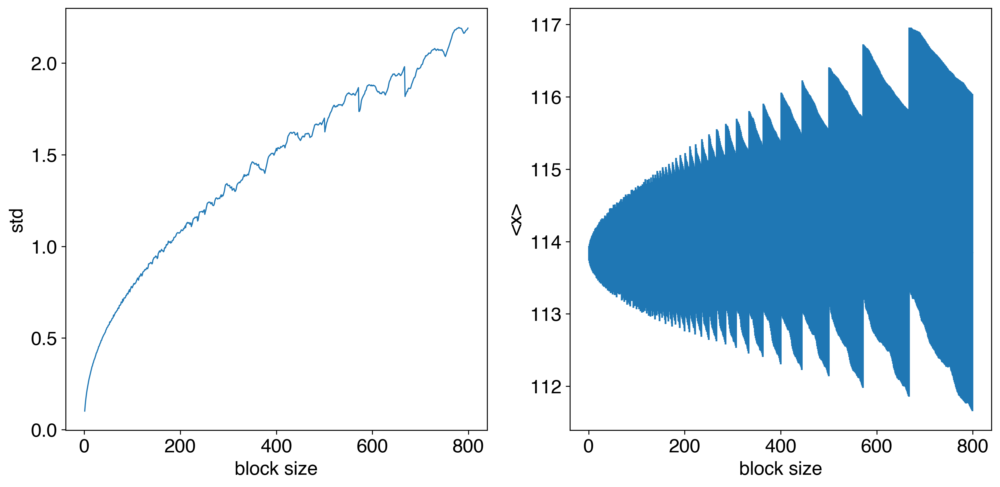

CLpcps_R2
111.84053884912441 1.2535968141346394


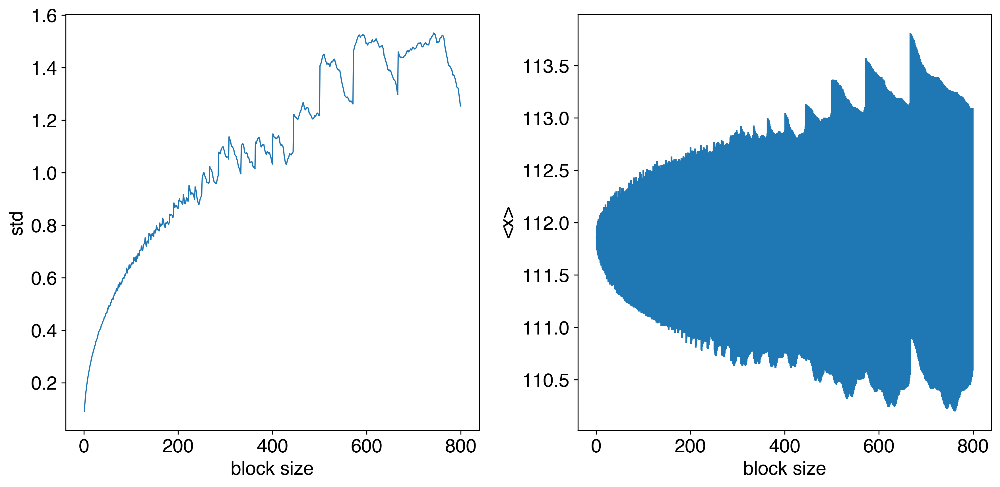

CLpcps R3
113.74543516336936 0.5628767633554403


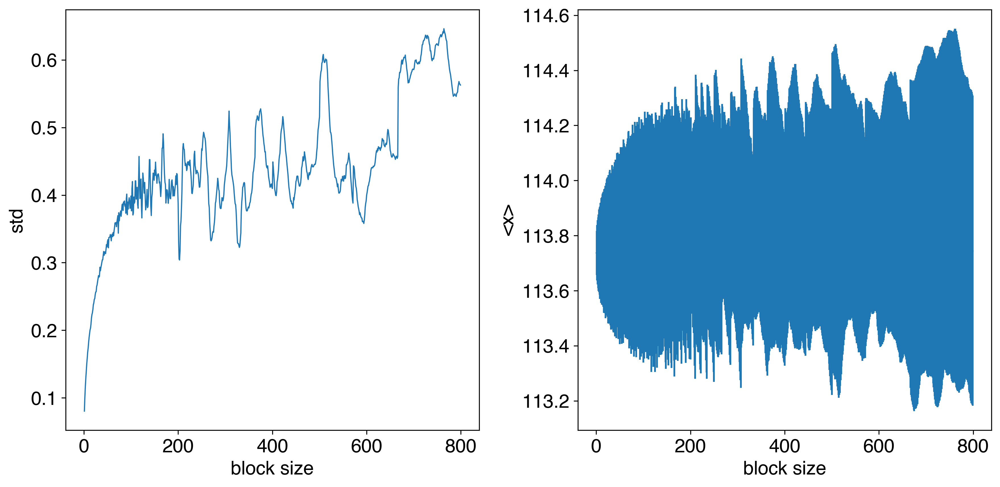

ang_all R3
113.14964829533149 0.8431937237702816


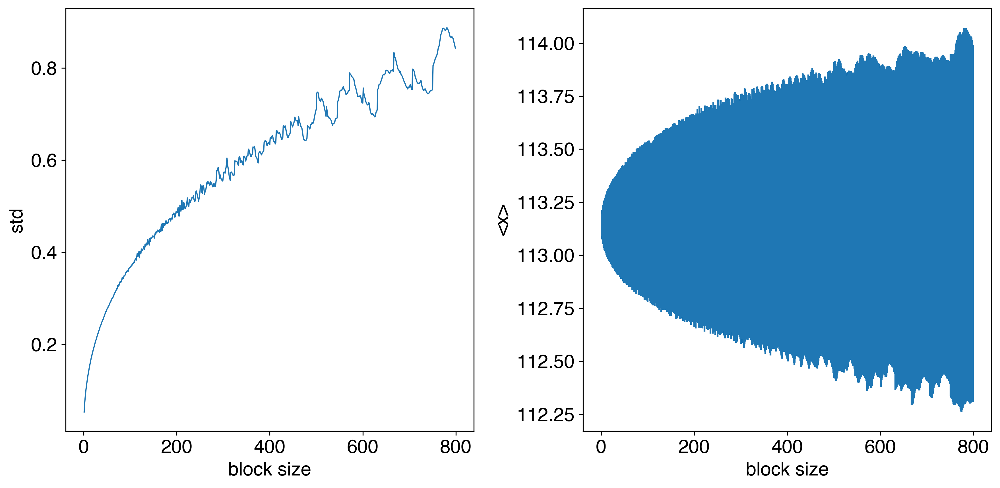

In [104]:
## Block Analysis TFC_TFN angle

## Block analysis for TFC-TFN angle ##
print ('CLpcps_R1')
blockAverage(CLpsr1a_eq_v2,maxBlockSize=800)

print ('CLpcps_R2')
blockAverage(CLpsr2a_eq_v2,maxBlockSize=800)

print ('CLpcps R3')
blockAverage(CLpsr3a_eq_v2,maxBlockSize=800)

print ('ang_all R3')
blockAverage(ang_all,maxBlockSize=800)



### Tilt, skew, twist 4D histogram -- test

## Panels for revised figures and SM -- 22/03/2022

### Tilt-skew and tilt-twist heatmaps.
<br>
--> For New Fig.2 with PCPS.
<br>
--> For SM fig for R2, R3 of PCPS and PC.
<br>
-->For TF/F7 in new Fig.
<br>
--> TF-ECD:For these maps the trjs were fitted to remove all xy translations and rotation and later the principal axis of the TMD was aligned to the Z-axis. The comparison of TTS is done then bw the TMD (z-axis) and the principal axis of TFN (residues 107 to 210)
<br>
--> TF-TFC:For these maps the trjs were fitted to remove all xy translations and rotation and later the principal axis of the TMD was aligned to the Z-axis. The comparison of TTS is done then bw the TMD (z-axis) and the principal axis of ECD (residues 1 to 210).
<br>
--> TF-TFC-TFN:For these maps the trjs were fitted to remove all xy translations and rotation and later the principal axis of the TFC was aligned to the Z-axis. The comparison of TTS is done then bw the TFC (z-axis) and the principal axis of TFN (this similat ro TFC-TFN angle).

0 90 0 180
0 90 0 360
0 90 0 180
0 90 0 360
0 90 0 180
0 90 0 360
0 90 0 180
0 90 0 360
0 90 0 180
0 90 0 360


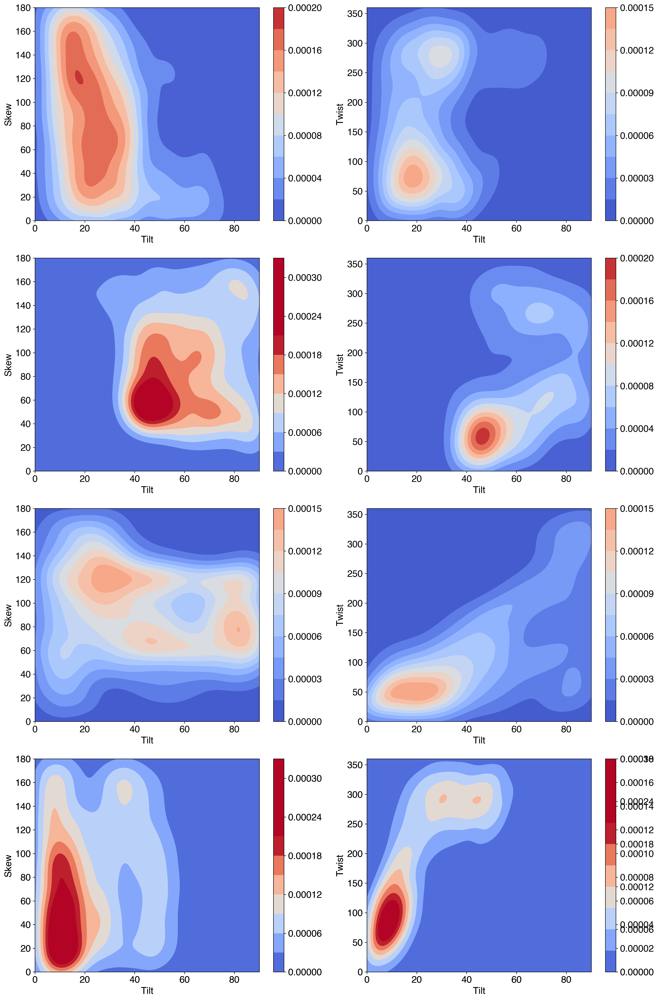

In [225]:
## 2D histograms of Tilt-Skew and Tilt-Twist using gaussian KDE. --- PA of TFC 
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as st

fig = plt.figure(figsize=(16,24))
#R1
data1 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_TFC_TMD_titl_skew_R1_wof200ns_200ps.dat'
tilt1=np.genfromtxt(data1, usecols=(6),autostrip=True)
skew1=np.genfromtxt(data1, usecols=(8),autostrip=True)
twist1=np.genfromtxt(data1, usecols=(11),autostrip=True)

#R1
data2 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_TFC_TMD_titl_skew_R2_wof200ns_200ps.dat'
tilt2=np.genfromtxt(data2, usecols=(6),autostrip=True, skip_header=711)
skew2=np.genfromtxt(data2,usecols=(8),autostrip=True, skip_header=711)
twist2=np.genfromtxt(data2, usecols=(11),autostrip=True, skip_header=711)

tilt2_2 = np.array([90-x for x in tilt2])

#R1
data3 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_TFC_TMD_titl_skew_R3_wof200ns_200ps.dat'
tilt3=np.genfromtxt(data3, usecols=(6),autostrip=True, skip_header=573)
skew3=np.genfromtxt(data3, usecols=(8),autostrip=True, skip_header=573)
twist3=np.genfromtxt(data3, usecols=(11),autostrip=True, skip_header=573)

tilt3_2 = np.array([180-x if x > 90 else x+0 for x in tilt3])

#tilt, skew = np.meshgrid(tilt, skew)

#Combine runs
tilt_all=np.concatenate((tilt1,tilt2,tilt3), axis=0)
skew_all=np.concatenate((skew1,skew2,skew3), axis=0)
twist_all=np.concatenate((twist1,twist2,twist3), axis=0)

#PC 

dataPC = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFPC_TFC_TMD_titl_skew_R1_wof200ns_200ps.dat'
tiltPC=np.genfromtxt(dataPC, usecols=(6),autostrip=True)
skewPC=np.genfromtxt(dataPC, usecols=(8),autostrip=True)
twistPC=np.genfromtxt(dataPC, usecols=(11),autostrip=True)

# TFF7 #

dataF7 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_F7/newTFF7_results/TFF7new_TFC_TMD_titl_skew_wof200ns_200ps.dat'
tiltF7=np.genfromtxt(dataF7, usecols=(6),autostrip=True, skip_header=719)
skewF7=np.genfromtxt(dataF7, usecols=(8),autostrip=True, skip_header=719)
twistF7=np.genfromtxt(dataF7, usecols=(11),autostrip=True, skip_header=719)

# normalize maps
norm1 = cm.colors.Normalize(vmax=0.00020)
norm2 = cm.colors.Normalize(vmax=0.00020)

# Extract x and y
x = tilt1
y = skew1
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 180
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(421)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm1)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Skew')
plt.colorbar(cfset)

# Extract x and y
x = tilt1
y = twist1
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 360
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(422)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm2)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Twist')
plt.colorbar(cfset)
#####

#R2
# Extract x and y
x = tilt2
y = skew2
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 180
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(423)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm1)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Skew')
plt.colorbar(cfset)
# Extract x and y
x = tilt2
y = twist2
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 360
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(424)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm2)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Twist')
plt.colorbar(cfset)

#R3

# Extract x and y
x = tilt3
y = skew3
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 180
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(425)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm1)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Skew')
plt.colorbar(cfset)

# Extract x and y
x = tilt3
y = twist3
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 360
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(426)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm2)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Twist')
plt.colorbar(cfset)

#PC

# Extract x and y
x = tiltPC
y = skewPC
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 180
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(427)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm1)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Skew')
plt.colorbar(cfset)

# Extract x and y
x = tiltPC
y = twistPC
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 360
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(428)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm2)
plt.colorbar(cfset)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Twist')

## TFF7

# Extract x and y
x = tiltF7
y = skewF7
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 180
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(427)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm1)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Skew')
plt.colorbar(cfset)

# Extract x and y
x = tiltF7
y = twistF7
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 360
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(428)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=10, cmap='coolwarm', norm=norm2)
plt.colorbar(cfset)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Twist')

plt.tight_layout()    
plt.savefig("/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TTS_maps_TMD-TFC_TFallTFsims_TFF7new_normalized.pdf", dpi=300)
plt.show()

0 90 0 180
0 90 0 360
0 90 0 180
0 90 0 360
0 90 0 180
0 90 0 360
0 90 0 180
0 90 0 360


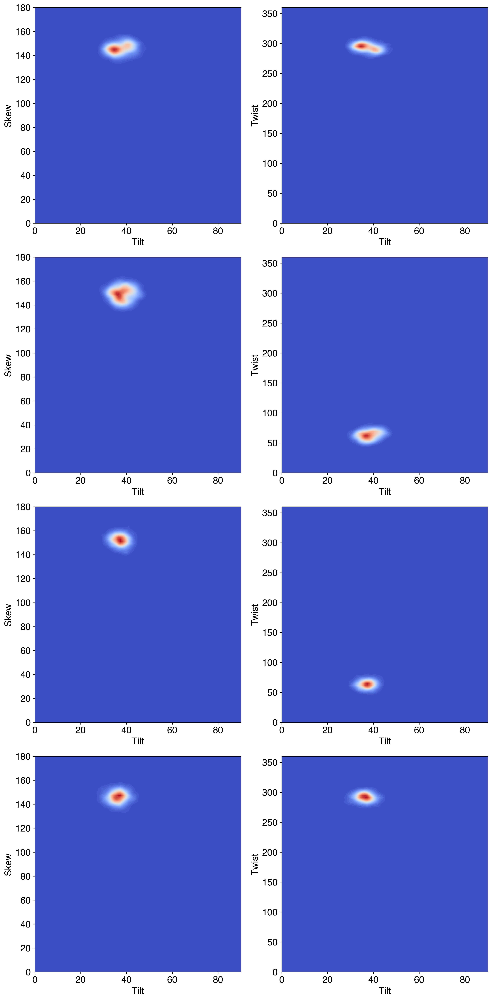

In [214]:
## 2D histograms of Tilt-Skew and Tilt-Twist using gaussian KDE. --- PA of TFN
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as st

fig = plt.figure(figsize=(12,24))

data = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_TFC_titl_skew_R1.dat'
tilt1=np.genfromtxt(data, usecols=(6),autostrip=True)
skew1=np.genfromtxt(data, usecols=(8),autostrip=True)
twist1=np.genfromtxt(data, usecols=(11),autostrip=True)

data2 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_TFC_titl_skew_R2.dat'
tilt2=np.genfromtxt(data2, usecols=(6),autostrip=True, skip_header=711)
skew2=np.genfromtxt(data2,usecols=(8),autostrip=True, skip_header=711)
twist2=np.genfromtxt(data2, usecols=(11),autostrip=True, skip_header=711)

tilt2_2 = np.array([90-x for x in tilt2])

data3 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_TFC_titl_skew_R3.dat'
tilt3=np.genfromtxt(data3, usecols=(6),autostrip=True, skip_header=573)
skew3=np.genfromtxt(data3, usecols=(8),autostrip=True, skip_header=573)
twist3=np.genfromtxt(data3, usecols=(11),autostrip=True, skip_header=573)

tilt3_2 = np.array([180-x if x > 90 else x+0 for x in tilt3])
twist1_2 = np.array([360-x  for x in twist])
#tilt, skew = np.meshgrid(tilt, skew)

#Combine runs
tilt_all=np.concatenate((tilt1,tilt2,tilt3), axis=0)
skew_all=np.concatenate((skew1,skew2,skew3), axis=0)
twist_all=np.concatenate((twist1,twist2,twist3), axis=0)

#PC 

dataPC = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_PC_TFC_titl_skew_R1.dat'
tiltPC=np.genfromtxt(dataPC, usecols=(6),autostrip=True)
skewPC=np.genfromtxt(dataPC, usecols=(8),autostrip=True)
twistPC=np.genfromtxt(dataPC, usecols=(11),autostrip=True)


# Extract x and y
x = tilt1
y = skew1
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 180
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(421)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=50, cmap='coolwarm')
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Skew')


# Extract x and y
x = tilt1
y = twist1
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 360
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(422)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=50, cmap='coolwarm')
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Twist')

#####

#R2
# Extract x and y
x = tilt2
y = skew2
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 180
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(423)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=50, cmap='coolwarm')
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Skew')

# Extract x and y
x = tilt2
y = twist2
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 360
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(424)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=50, cmap='coolwarm')
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Twist')

#R3

# Extract x and y
x = tilt3
y = skew3
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 180
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(425)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=50, cmap='coolwarm')
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Skew')

# Extract x and y
x = tilt3
y = twist3
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 360
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(426)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=50, cmap='coolwarm')
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Twist')

#PC

# Extract x and y
x = tiltPC
y = skewPC
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 180
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(427)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=50, cmap='coolwarm')
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Skew')

# Extract x and y
x = tiltPC
y = twistPC
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
# Define the borders
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = 0
xmax = 90
ymin = 0
ymax = 360
print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(428)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=50, cmap='coolwarm')
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel('Tilt')
ax.set_ylabel('Twist')

plt.tight_layout()    
plt.savefig("/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TTS_maps_TFC-TFN_allTFsims.pdf", dpi=300)
plt.show()

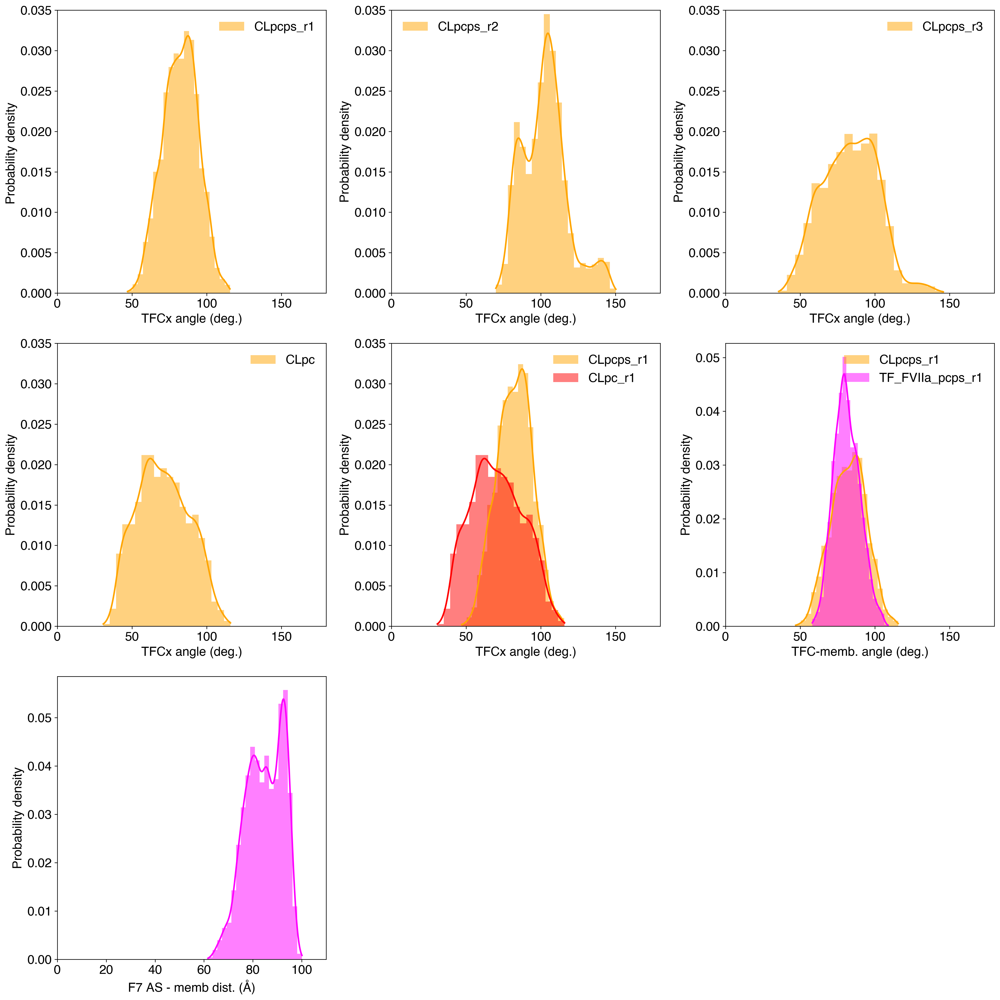

In [209]:
## Angles as in Fig. S3 but with new meausrements. Mostly with Okhubo definition for TFC-Memb angle.

### Data

#R1
CLpsr1a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R1_200ps.dat'

CLpsr1a_all = np.genfromtxt(CLpsr1a, usecols=(0,3))
#CLpsr1a_all2 = np.genfromtxt(CLpsr1a, usecols=(0,3))
CLpsr1a_eq = np.genfromtxt(CLpsr1a, usecols=(0,3))

#CLpsr1a_allm = np.genfromtxt(CLpsr1a, usecols=(0,6))
#CLpsr1a_eqm = np.genfromtxt(CLpsr1a, usecols=(0,6))

#R2
CLpsr2a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R2_200ps.dat'
CLpsr2a_all = np.genfromtxt(CLpsr2a, usecols=(0,3))
CLpsr2a_eq = np.genfromtxt(CLpsr2a, usecols=(0,3), skip_header=711)

#CLpsr2a_allm = np.genfromtxt(CLpsr2a, usecols=(0,8))
#CLpsr2a_eqm = np.genfromtxt(CLpsr2a, usecols=(0,8), skip_header=711)

#R3
CLpsr3a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R3_200ps.dat'
CLpsr3a_all = np.genfromtxt(CLpsr3a, usecols=(0,6))
CLpsr3a_eq = np.genfromtxt(CLpsr3a, usecols=(0,6), skip_header=573)

#CLpsr3a_allm = np.genfromtxt(CLpsr3a, usecols=(0,6))
#CLpsr3a_eqm = np.genfromtxt(CLpsr3a, usecols=(0,6), skip_header=573)

#PC
CLpcr1a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_PC_200ps.dat'

CLpcr1a_all = np.genfromtxt(CLpcr1a, usecols=(0,3))
#CLpsr1a_all2 = np.genfromtxt(CLpcr1a, usecols=(0,3))
CLpcr1a_eq = np.genfromtxt(CLpcr1a, usecols=(0,3), skip_header=144)

#Reg
CLpsr1a_eq_v2 = np.array([180-x if x > 90.5 else x+0 for x in CLpsr1a_eq[:,1]])
CLpsr2a_eq_v2 = np.array([180-x if x > 90.5 else x+0 for x in CLpsr2a_eq[:,1]])
CLpsr3a_eq_v2 = np.array([180-x if x > 90.5 else x+0 for x in CLpsr3a_eq[:,1]])
CLpcr1a_eq_v2 = np.array([180-x if x > 90.5 else x+0 for x in CLpcr1a_eq[:,1]])

# Concatenate all PCPS runs
#ang_all=np.concatenate((CLpsr1a_eq[:,1],CLpsr2a_eq[:,1],CLpsr3a_eq[:,1]),axis=0)
ang_all_v2=np.concatenate((CLpsr1a_eq_v2,CLpsr2a_eq_v2,CLpsr3a_eq_v2),axis=0)

# new TF_F7
TF7psr1a = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_F7/newTFF7_results/TF_F7_new_angles_as_Okhubo_200ps.dat'
TF7psr1a_all = np.genfromtxt(TF7psr1a, usecols=(0,6))
TF7psr1a_eq = np.genfromtxt(TF7psr1a, usecols=(0,6), skip_header=719)

### Fig.2 Prob. dist ###
plt.figure(2,figsize = (18,18)) 

plt.subplot(331)
sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((CLpsr1a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#lin=ax.lines[0].get_xdata().astype(int)
#lin2=ax.lines[0].get_xdata(0)
#lin3=ax.lines[0].get_ydata()
#np.savetxt("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/Fig3e.csv", (np.c_[lin2,lin3]), delimiter=",")
#print (tabla)

plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density ')
#plt.title('CLpcps_r1')
plt.xlim([0, 180])
legend(loc='best', frameon = False)
plt.ylim([0, 0.035])

plt.subplot(332)
sns.histplot((CLpsr2a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r2')
#sns.histplot((CLpsr2a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r2')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r2')
plt.xlim([0, 180])
legend(loc='best', frameon = False)
plt.ylim([0, 0.035])

plt.subplot(333)
sns.histplot((CLpsr3a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r3')
#sns.histplot((CLpsr3a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r3')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r3')
plt.xlim([0, 180])
legend(loc='best', frameon = False)
plt.ylim([0, 0.035])

plt.subplot(334)
sns.histplot((CLpcr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpc')
#sns.histplot((CLpcr1a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpc')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r3')
plt.xlim([0, 180])
legend(loc='best', frameon = False)
plt.ylim([0, 0.035])

plt.subplot(335)
sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((ang_all), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2),edgecolor="None",label='all_pcps')
sns.histplot((CLpcr1a_eq[:,1]), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2), edgecolor="None",label='CLpc_r1')
#sns.histplot((CLpsr1a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((ang_all_v2), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2),edgecolor="None",label='all_pcps')
#sns.histplot((CLpcr1a_eq_v2), stat='density',bins=20,kde=True, color='pink',line_kws=dict(color="pink", linewidth=2), edgecolor="None",label='CLpc_r1')

plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('Comparison')
plt.xlim([0, 180])
#plt.xlim([0, 90])
plt.ylim([0, 0.035])
legend(loc='best', frameon = False)

plt.subplot(336)

sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
sns.histplot((TF7psr1a_eq[:,1]), stat='density',bins=20,kde=True, color='magenta',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='TF_FVIIa_pcps_r1')

plt.xlabel('TFC-memb. angle (deg.)')
plt.ylabel('Probability density')
plt.xlim([0, 180])
#plt.ylim([0, 0.07])
legend(loc='best', frameon = False)

# F7 active site dist.
file_AS =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_F7/newTFF7_results/TFF7new_pcps_F7_ASdist_100ps.dat'

ASdz = np.genfromtxt(file_AS, usecols=(0,4))

ASdz_eq = np.genfromtxt(file_AS, usecols=(0,4),skip_header=1437)

plt.subplot(337)

dasz_eq=ASdz_eq
ax4=sns.histplot((dasz_eq[:,1]),stat='density',bins=20,kde=True, color='magenta',line_kws=dict(color="orange", linewidth=2), edgecolor="None")
plt.xlabel('F7 AS - memb dist. (Å)')
plt.ylabel('Probability density')
#plt.title('FVIIa-TF - PCPS (0.5 µs)')
plt.xlim([0, 110])
#plt.ylim([0, 0.07])

plt.tight_layout()    
plt.savefig("/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFC_CM_angle_as_Okhubo_nonReg_plus_ASDF7.pdf", dpi=300)
plt.show()


CLpcps_R1 V2
78.78768134782581 1.8714467776658148


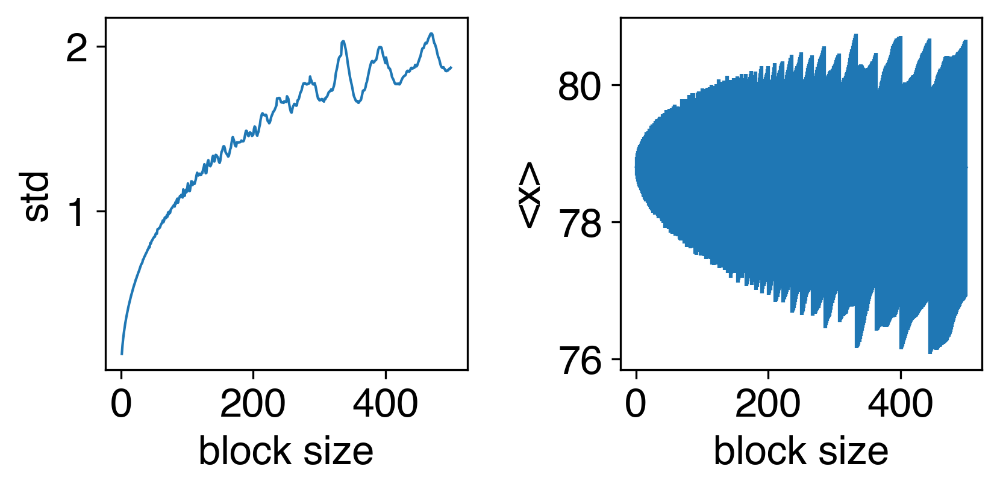

CLpcps_R2 V2
74.33331233258491 1.8728735239630676


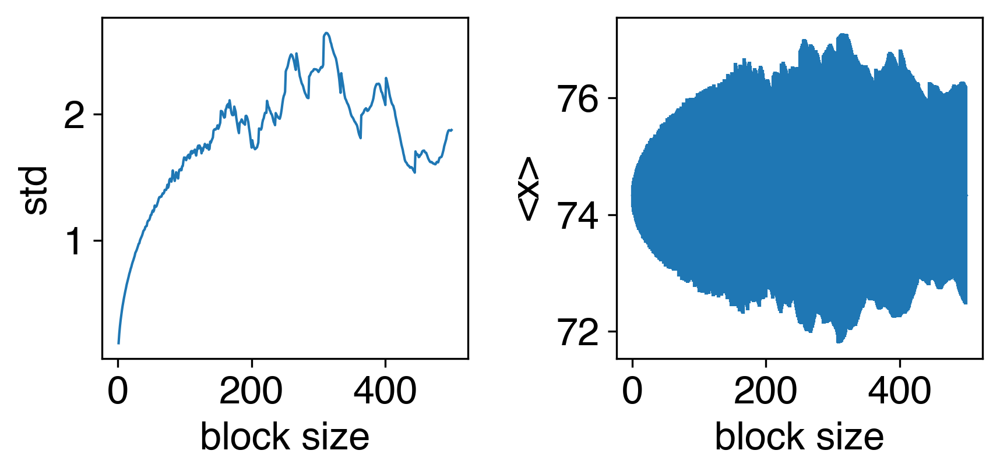

CLpcps R3 V2
74.06329510667038 2.468489679880501


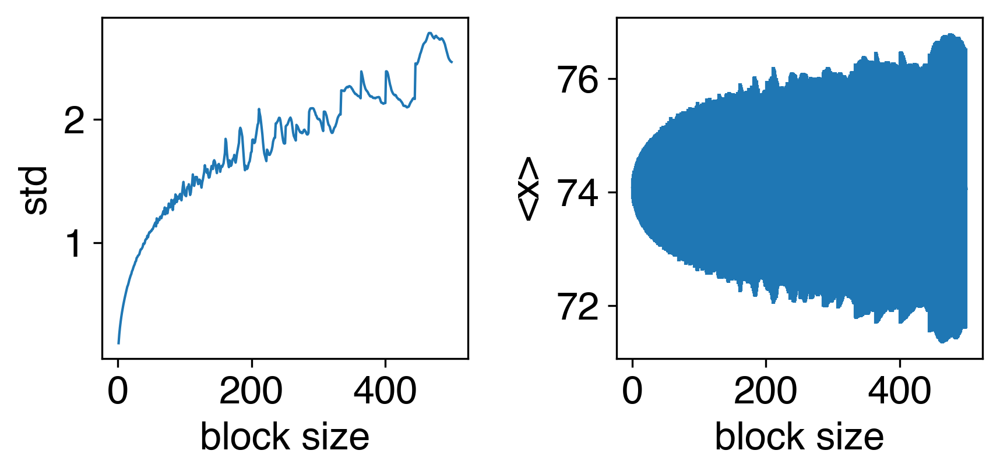

ang_all R3 V2
75.73681040770684 1.2319463785656515


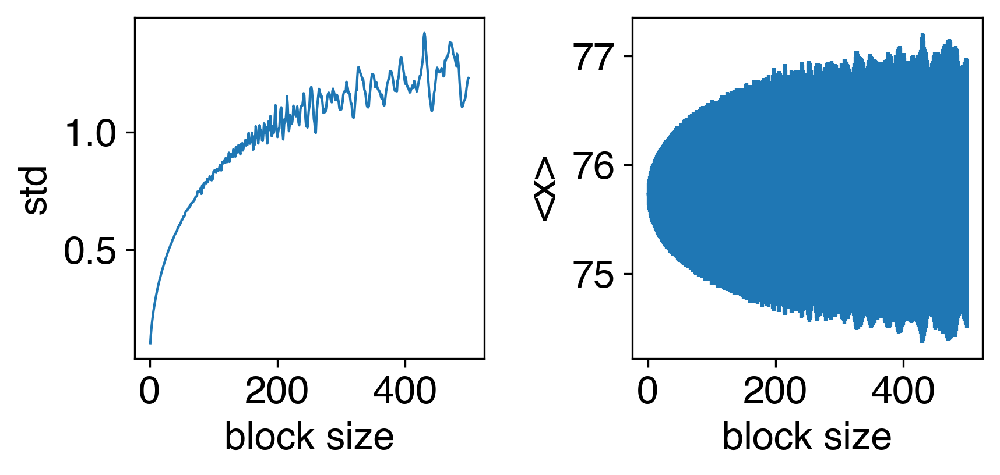

CLpc_R1 V2
68.41871884551176 3.5205748717307417


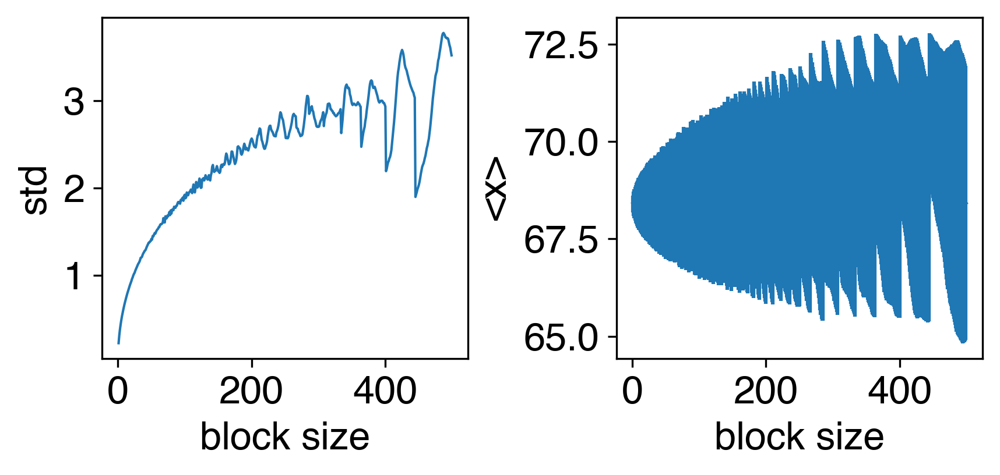

TFF7 V2
79.62741081058618 1.7376982681103355


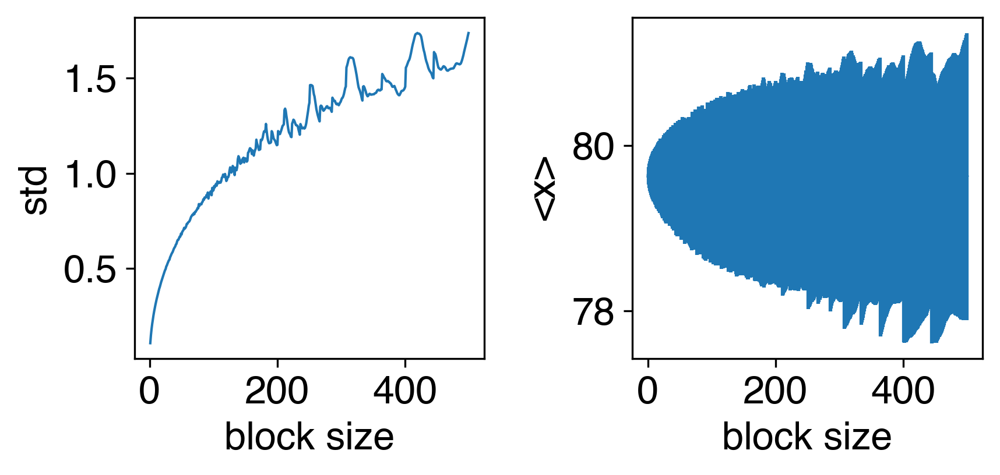

ASD
84.7191134676597 1.6881872278224317


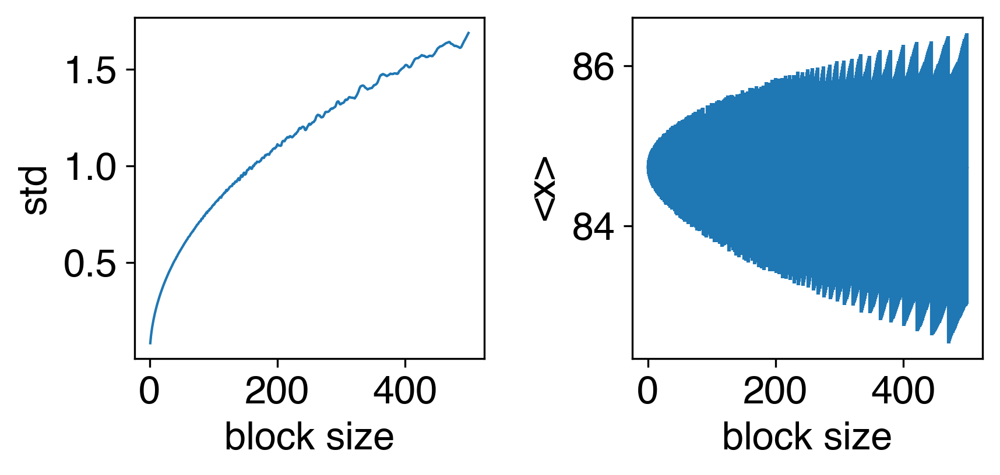

In [261]:
## Block Analysis TFC_memb angle


print ('CLpcps_R1 V2')
blockAverage(CLpsr1a_eq_v2,maxBlockSize=500)

print ('CLpcps_R2 V2')
blockAverage(CLpsr2a_eq_v2,maxBlockSize=500)

print ('CLpcps R3 V2')
blockAverage(CLpsr3a_eq_v2,maxBlockSize=500)

print ('ang_all R3 V2')
blockAverage(ang_all_v2,maxBlockSize=500)

print ('CLpc_R1 V2')
blockAverage(CLpcr1a_eq_v2,maxBlockSize=500)

print ('TFF7 V2')
blockAverage(TF7psr1a_eq_v2,maxBlockSize=500)

print ('ASD')
blockAverage((dasz_eq[:,1]),maxBlockSize=500)

CLpcps_R1
82.37878975688182 3.062288705809807


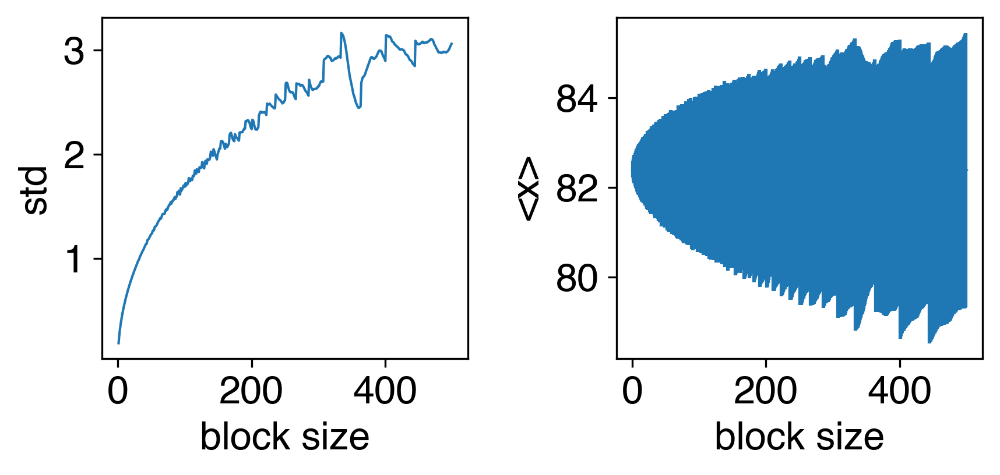

CLpcps_R2
102.74182716093631 2.1950541892423834


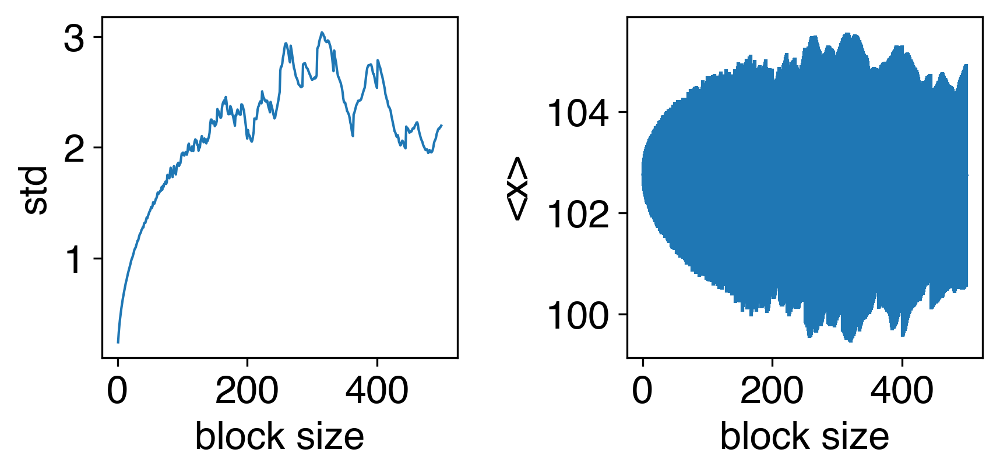

CLpcps R3
83.40457255479238 3.7382549137170074


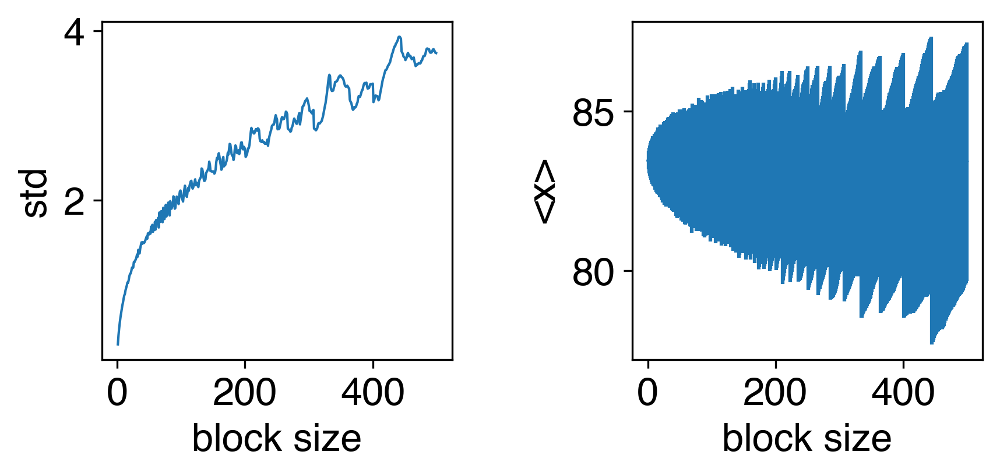

CLpc_R1
70.89491714338067 3.964785571859855


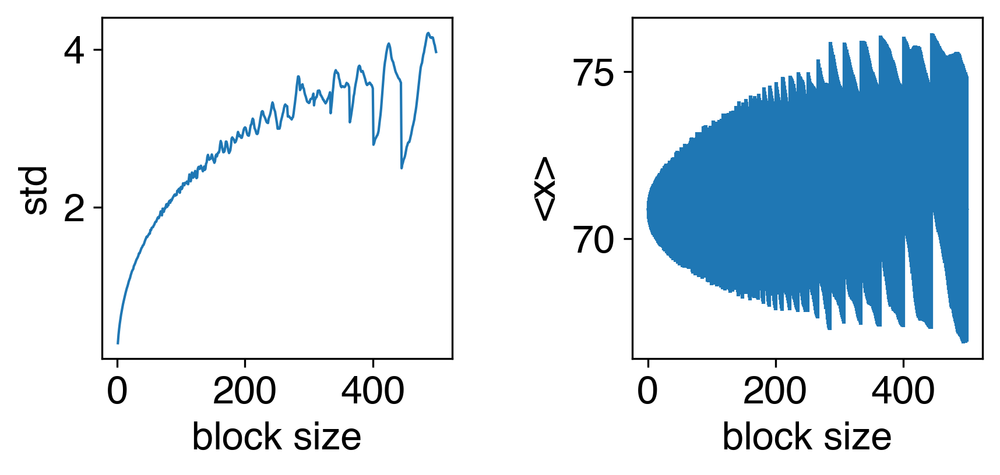

TF F7
81.21710660952502 2.441506082923505


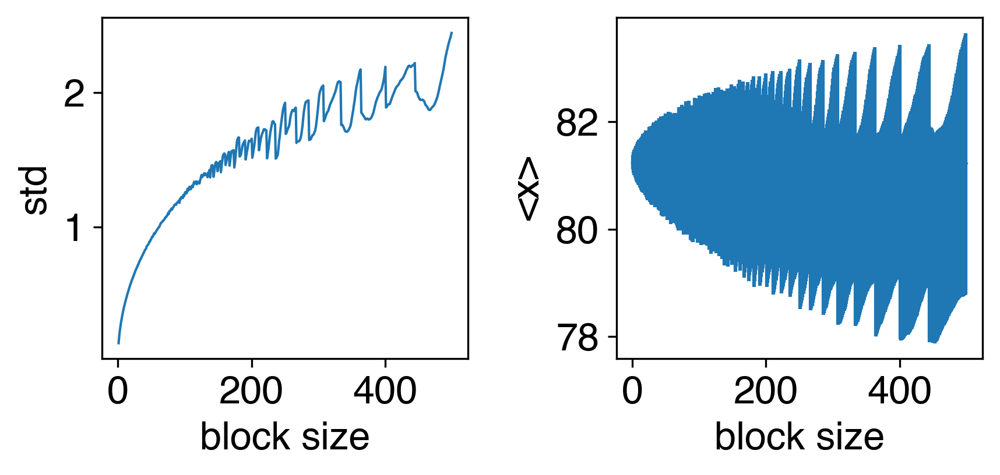

In [260]:
## Block Analysis TFC_memb angle

print ('CLpcps_R1')
blockAverage(CLpsr1a_eq[:,1],maxBlockSize=500)

print ('CLpcps_R2')
blockAverage(CLpsr2a_eq[:,1],maxBlockSize=500)

print ('CLpcps R3')
blockAverage(CLpsr3a_eq[:,1],maxBlockSize=500)

print ('CLpc_R1')
blockAverage(CLpcr1a_eq[:,1],maxBlockSize=500)

print ('TF F7')
blockAverage(TF7psr1a_eq[:,1],maxBlockSize=500)

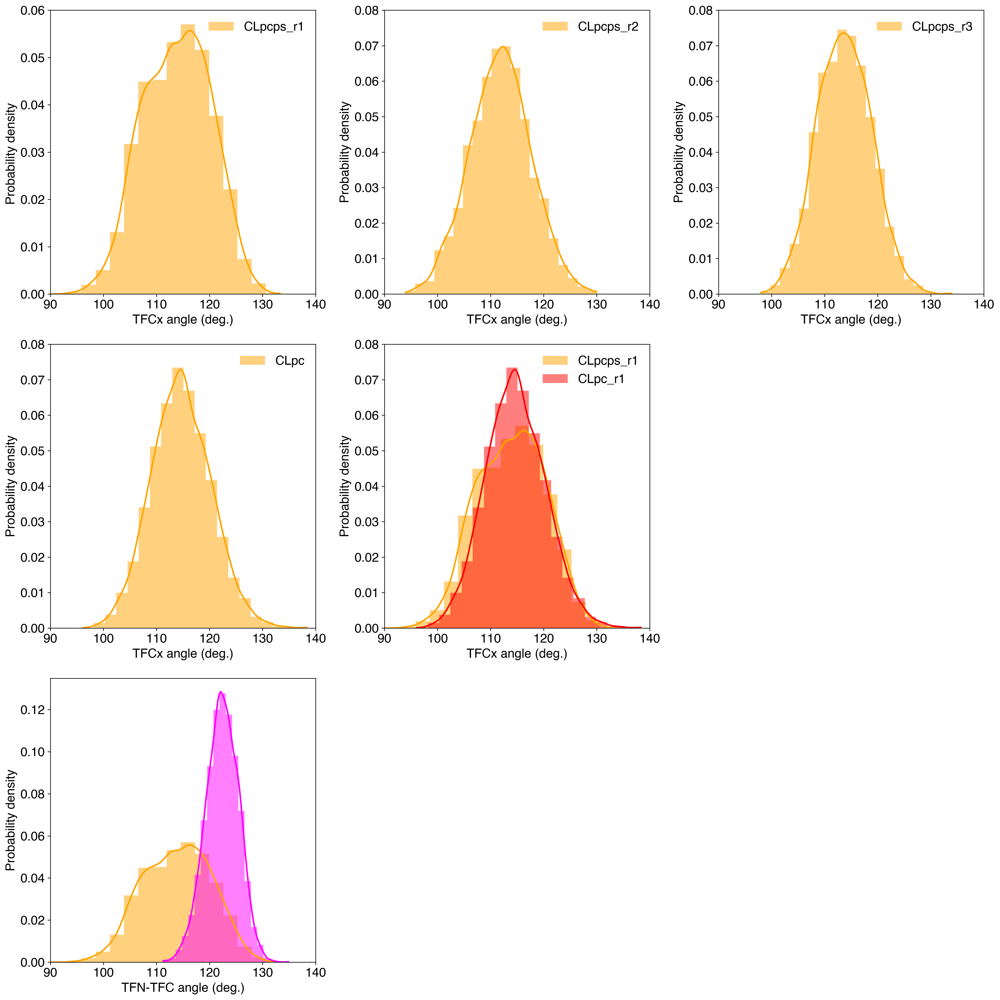

In [258]:
## TFN-TFC angle

#R1
CLpsr1a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R1_200ps.dat'

CLpsr1a_all_nf_nc = np.genfromtxt(CLpsr1a, usecols=(0,1))
#CLpsr1a_all2 = np.genfromtxt(CLpsr1a, usecols=(0,1))
CLpsr1a_eq_nf_nc = np.genfromtxt(CLpsr1a, usecols=(0,1))

#R2
CLpsr2a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R2_200ps.dat'
CLpsr2a_all_nf_nc = np.genfromtxt(CLpsr2a, usecols=(0,2))
CLpsr2a_eq_nf_nc = np.genfromtxt(CLpsr2a, usecols=(0,2), skip_header=711)

#R3
CLpsr3a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R3_200ps.dat'
CLpsr3a_all_nf_nc = np.genfromtxt(CLpsr3a, usecols=(0,1))
CLpsr3a_eq_nf_nc = np.genfromtxt(CLpsr3a, usecols=(0,1), skip_header=573)

#PC
CLpcr1a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_PC_200ps.dat'

CLpcr1a_all_nf_nc = np.genfromtxt(CLpcr1a, usecols=(0,1))
#CLpsr1a_all2 = np.genfromtxt(CLpcr1a, usecols=(0,3))
CLpcr1a_eq_nf_nc = np.genfromtxt(CLpcr1a, usecols=(0,1), skip_header=144)

TF7psr1a = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_F7/newTFF7_results/TF_F7_new_angles_as_Okhubo_200ps.dat'
#TF7psr1a_all = np.genfromtxt(TF7psr1a, usecols=(0,1))
TF7psr1a_eq_nf_nc = np.genfromtxt(TF7psr1a, usecols=(0,1), skip_header=719)

CLpsr1a_eq_v2_nf_nc = np.array([180-x for x in CLpsr1a_eq_nf_nc[:,1]])
CLpsr2a_eq_v2_nf_nc = np.array([180-x if x < 90 else x+0 for x in CLpsr2a_eq_nf_nc[:,1]])
CLpsr3a_eq_v2_nf_nc = np.array([180-x if x < 90 else x+0 for x in CLpsr3a_eq_nf_nc[:,1]])
CLpcr1a_eq_v2_nf_nc = np.array([180-x if x < 90 else x+0 for x in CLpcr1a_eq_nf_nc[:,1]])
CLpcr1a_eq_v2_nf_nc = np.array([180-x if x < 90 else x+0 for x in CLpcr1a_eq_nf_nc[:,1]])
TF7psr1a_eq2_nf_nc = np.array([180-x if x < 90 else x+0 for x in TF7psr1a_eq_nf_nc[:,1]])

ang_all_v2_nf_nc=np.concatenate((CLpsr1a_eq_v2_nf_nc,CLpsr2a_eq_v2_nf_nc,CLpsr3a_eq_v2_nf_nc),axis=0)

### Fig.2 Prob. dist ###
### Fig.2 Prob. dist ###
plt.figure(2,figsize = (18,18)) 

plt.subplot(331)
#sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
sns.histplot((CLpsr1a_eq_v2_nf_nc), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#lin=ax.lines[0].get_xdata().astype(int)
#lin2=ax.lines[0].get_xdata(0)
#lin3=ax.lines[0].get_ydata()
#np.savetxt("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/Fig3e.csv", (np.c_[lin2,lin3]), delimiter=",")
#print (tabla)

plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density ')
#plt.title('CLpcps_r1')
plt.xlim([90, 140])
legend(loc='best', frameon = False)
plt.ylim([0, 0.06])

plt.subplot(332)
#sns.histplot((CLpsr2a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r2')
sns.histplot((CLpsr2a_eq_v2_nf_nc), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r2')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r2')
plt.xlim([90, 140])
legend(loc='best', frameon = False)
plt.ylim([0, 0.08])

plt.subplot(333)
#sns.histplot((CLpsr3a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r3')
sns.histplot((CLpsr3a_eq_v2_nf_nc), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r3')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r3')
plt.xlim([90, 140])
legend(loc='best', frameon = False)
plt.ylim([0, 0.08])

plt.subplot(334)
#sns.histplot((CLpcr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpc')
sns.histplot((CLpcr1a_eq_v2_nf_nc), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpc')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r3')
plt.xlim([90, 140])
legend(loc='best', frameon = False)
plt.ylim([0, 0.08])

plt.subplot(335)
#sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((ang_all), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2),edgecolor="None",label='all_pcps')
#sns.histplot((CLpcr1a_eq[:,1]), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2), edgecolor="None",label='CLpc_r1')
sns.histplot((CLpsr1a_eq_v2_nf_nc), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((ang_all_v2), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2),edgecolor="None",label='all_pcps')
sns.histplot((CLpcr1a_eq_v2_nf_nc), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2), edgecolor="None",label='CLpc_r1')

plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('Comparison')
plt.xlim([90, 140])
#plt.xlim([0, 90])
plt.ylim([0, 0.08])
legend(loc='best', frameon = False)

plt.subplot(337)
sns.histplot((CLpsr1a_eq_v2_nf_nc), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
sns.histplot((TF7psr1a_eq2_nf_nc), stat='density',bins=20,kde=True, color='magenta',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='TF_FVIIa_pcps_r1')
plt.xlabel('TFN-TFC angle (deg.)')
plt.ylabel('Probability density')
#plt.title('Comparison')
plt.xlim([90, 140])
#plt.ylim([0, 0.07])
#legend(loc='best', frameon = False)

plt.tight_layout()    
plt.savefig("/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFC_TFN_angle_as_Okhubo_Reg_90140.pdf", dpi=300)
plt.show()

CLpcps_R1 V2
113.85449148789476 1.693245588773318


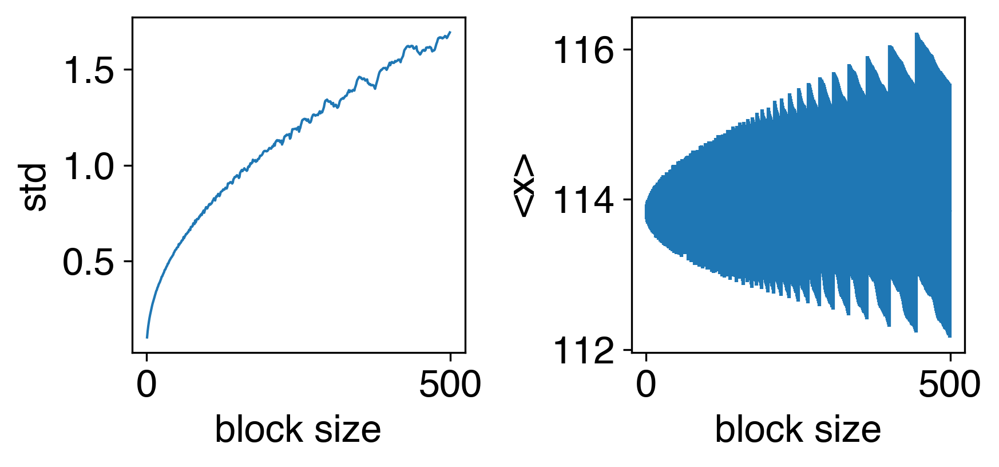

CLpcps_R2 V2
111.83262319884776 1.2169718370012608


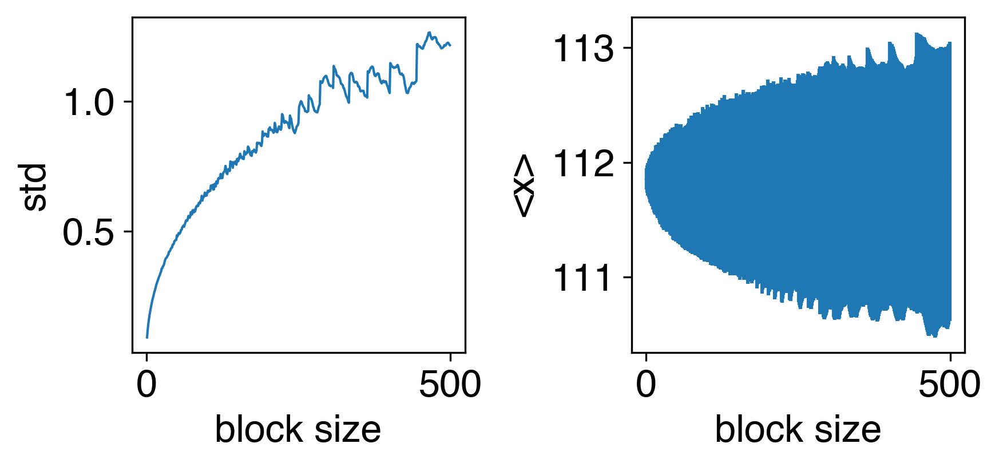

CLpcps R3 V2
113.74902312405409 0.5094453315086804


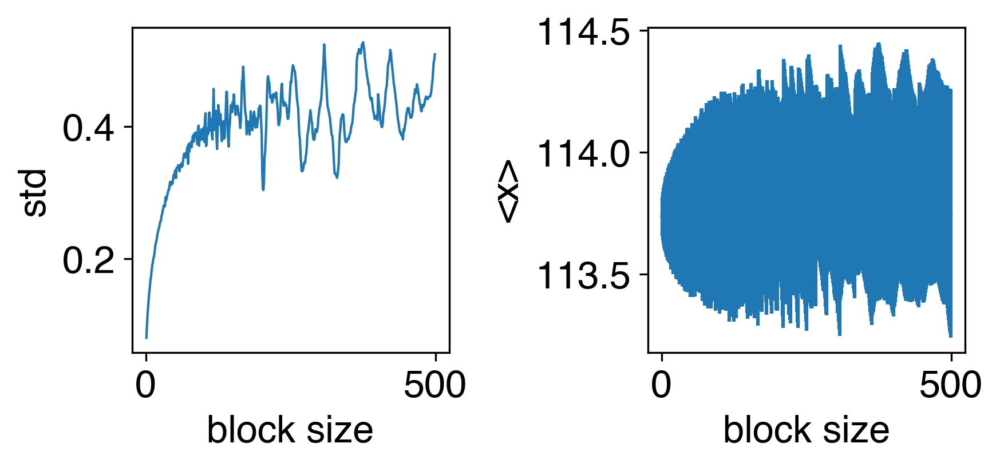

ang_all R3 V2
113.15259411276098 0.707524389779788


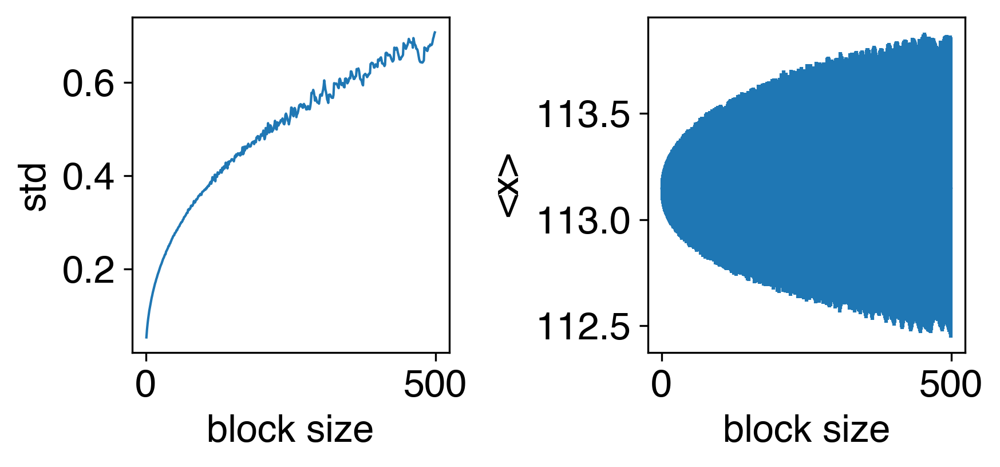

CLpc_R1 V2
114.68824001474658 1.0931108730344428


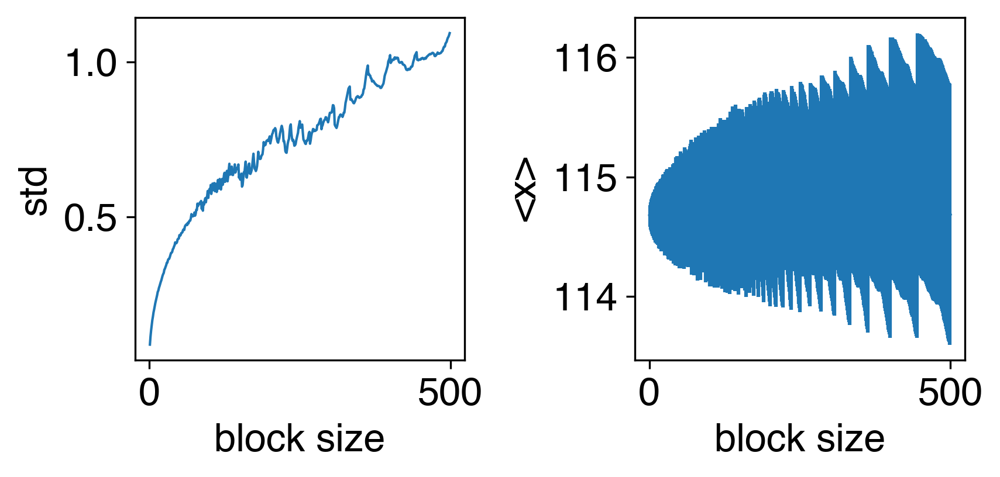

TFF7
122.34622772298243 0.34145143799145483


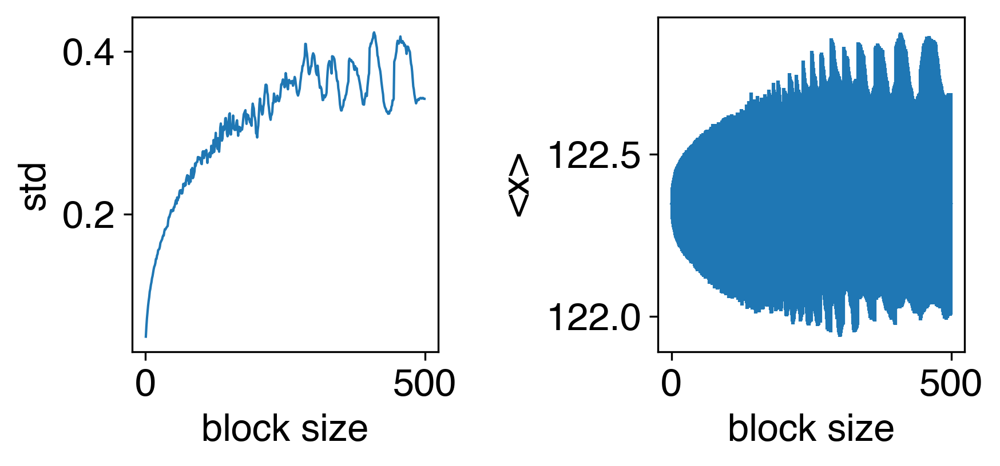

In [195]:
## Block Analysis TFC_TFN (reg) angle

## Block analysis for TFC-TFN angle ##
print ('CLpcps_R1 V2')
blockAverage(CLpsr1a_eq_v2_nf_nc,maxBlockSize=500)

print ('CLpcps_R2 V2')
blockAverage(CLpsr2a_eq_v2_nf_nc,maxBlockSize=500)

print ('CLpcps R3 V2')
blockAverage(CLpsr3a_eq_v2_nf_nc,maxBlockSize=500)

print ('ang_all R3 V2')
blockAverage(ang_all_v2_nf_nc,maxBlockSize=500)

print ('CLpc_R1 V2')
blockAverage(CLpcr1a_eq_v2_nf_nc,maxBlockSize=500)

print ('TFF7')
blockAverage(TF7psr1a_eq2_nf_nc, maxBlockSize=500)

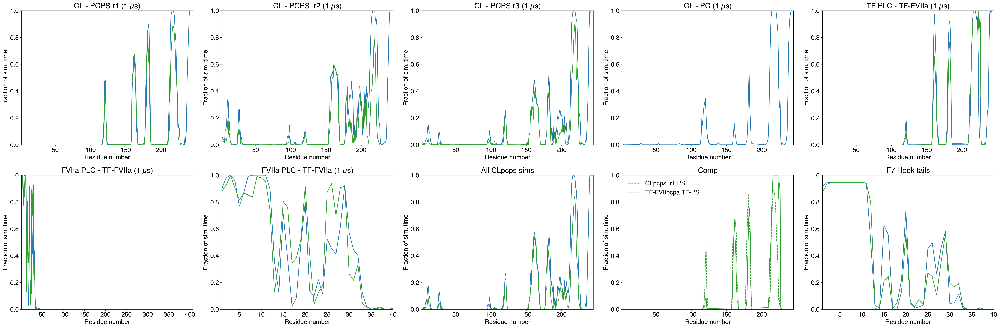

In [202]:
## CL - PCPS
plt.figure( figsize = (36,12)) 
#R1

file1 =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/CL_1us_pcps_PLC_PC_100ps.dat_hist.dat.eq'
file2 =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/CL_1us_pcps_PLC_PS_100ps.dat_hist.dat.eq'

with open(file1, 'r') as fd:
    lines1 = fd.read().split()
    counter1 = Counter(lines1)
    items1 = sorted(counter1.items(), key=lambda x: int(x[0]))
    num_items1 = np.array(items1, dtype=int)

with open(file2, 'r') as fd:
    lines2 = fd.read().split()
    counter2 = Counter(lines2)
    items2 = sorted(counter2.items(), key=lambda x: int(x[0]))
    num_items2 = np.array(items2, dtype=int)
        
    plt.subplot(251)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('CL - PCPS r1 (1 µs)')
    plt.plot((num_items1[:,0]+2), (num_items1[:,1]/8003), color= 'C0', zorder=1)
    plt.plot((num_items2[:,0]+2), (num_items2[:,1]/8003), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])   
    
#R2

file3 =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/CLr2_1us_pcps_PLC_PC_100ps.dat_hist.dat.eq'
file4 =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/CLr2_1us_pcps_PLC_PS_100ps.dat_hist.dat.eq'

with open(file3, 'r') as fd:
    lines3 = fd.read().split()
    counter3 = Counter(lines3)
    items3 = sorted(counter3.items(), key=lambda x: int(x[0]))
    num_items3 = np.array(items3, dtype=int)

with open(file4, 'r') as fd:
    lines4 = fd.read().split()
    counter4 = Counter(lines4)
    items4 = sorted(counter4.items(), key=lambda x: int(x[0]))
    num_items4 = np.array(items4, dtype=int)
        
    plt.subplot(252)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('CL - PCPS  r2 (1 µs)')
    plt.plot((num_items3[:,0]+2), (num_items3[:,1]/9421), color= 'C0', zorder=1)
    plt.plot((num_items4[:,0]+2), (num_items4[:,1]/9421), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])   

#R3
file5 =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/CLr3_1us_pcps_PLC_PC_100ps.dat_hist.dat.eq'
file6 =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/CLr3_1us_pcps_PLC_PS_100ps.dat_hist.dat.eq'

with open(file5, 'r') as fd:
    lines5 = fd.read().split()
    counter5 = Counter(lines5)
    items5 = sorted(counter5.items(), key=lambda x: int(x[0]))
    num_items5 = np.array(items5, dtype=int)

with open(file6, 'r') as fd:
    lines6 = fd.read().split()
    counter6 = Counter(lines6)
    items6 = sorted(counter6.items(), key=lambda x: int(x[0]))
    num_items6 = np.array(items6, dtype=int)
        
    plt.subplot(253)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('CL - PCPS r3 (1 µs)')
    plt.plot((num_items5[:,0]+2), (num_items5[:,1]/9144), color= 'C0', zorder=1)
    plt.plot((num_items6[:,0]+2), (num_items6[:,1]/9144), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])   

    ## CL - PC
file7 =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/CL_1us_pc_PLC_PC_100ps.dat_hist.dat.eq'

with open(file7, 'r') as fd:
    lines7 = fd.read().split()
    counter7 = Counter(lines7)
    items7 = sorted(counter7.items(), key=lambda x: int(x[0]))
    num_items7 = np.array(items7, dtype=int)
    #print(num_items7[:,1])
    
    plt.subplot(254)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('CL - PC (1 µs)')
    plt.plot((num_items7[:,0]+2), (num_items7[:,1]/7962), color= 'C0', zorder=1)
    plt.ylim([0, 1])
    plt.xlim([2, 245])   


## TF- FVIIa PCPS

## TF - TFcl-FVIIa 

filea =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/TFF7new_pcps_TFPLC_PC_100ps.dat_hist.dat'
fileb =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/TFF7new_pcps_TFPLC_PS_100ps.dat_hist.dat'

with open(filea, 'r') as fd:
    linesa = fd.read().split()  
    countera = Counter(linesa)
    itemsa = sorted(countera.items(), key=lambda x: int(x[0]))
    num_itemsa = np.array(itemsa, dtype=int)    
    #print(len(lines9))
    
with open(fileb, 'r') as fd:
    linesb = fd.read().split() 
    counterb = Counter(linesb)
    itemsb = sorted(counterb.items(), key=lambda x: int(x[0]))
    num_itemsb = np.array(itemsb, dtype=int)    
    #print(num_items10)
    
    plt.subplot(255)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('TF PLC - TF-FVIIa (1 µs)')
    plt.plot((num_itemsa[:,0]+2), (num_itemsa[:,1]/8002), color= 'C0', zorder=1)
    plt.plot((num_itemsb[:,0]+2), (num_itemsb[:,1]/8002), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])        
    

# FVIIa - TFcl-FVIIa
file11 =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/TFF7new_pcps_F7PLC_PC_100ps.dat_hist.dat'
file12 =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/TFF7new_pcps_F7PLC_PS_100ps.dat_hist.dat'

with open(file11, 'r') as fd:
    lines11 = fd.read().split() 
    counter11 = Counter(lines11)
    items11 = sorted(counter11.items(), key=lambda x: int(x[0]))
    num_items11 = np.array(items11, dtype=int)    
    #print(len(items11[:,1]))
    
with open(file12, 'r') as fd:
    lines12 = fd.read().split()
    counter12 = Counter(lines12)
    items12 = sorted(counter12.items(), key=lambda x: int(x[0]))
    num_items12 = np.array(items12, dtype=int)    
    #print(num_items10)
    
    plt.subplot(256)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('FVIIa PLC - TF-FVIIa (1 µs)')
    plt.plot((num_items11[:,0]), (num_items11[:,1]/8002), color='C0', zorder=1)
    plt.plot((num_items12[:,0]), (num_items12[:,1]/8002), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([1, 407])       
    
    plt.subplot(257)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('FVIIa PLC - TF-FVIIa (1 µs)')
    plt.plot((num_items11[:,0]), (num_items11[:,1]/8002), color='C0', zorder=1)
    plt.plot((num_items12[:,0]), (num_items12[:,1]/8002), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([1, 40])         

## Sum of all CLpcps PLC ##

file_comb1 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/CL_r1_3_PLC_pc_comb.dat_hist.dat.eq'
file_comb2 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/CL_r1_3_PLC_ps_comb.dat_hist.dat.eq'

with open(file_comb1, 'r') as fd:
    lines13 = fd.read().split() 
    counter13 = Counter(lines13)
    items13 = sorted(counter13.items(), key=lambda x: int(x[0]))
    num_items13 = np.array(items13, dtype=int)    
    #print(len(lines9))
    
with open(file_comb2, 'r') as fd:
    lines14 = fd.read().split() 
    counter14 = Counter(lines14)
    items14 = sorted(counter14.items(), key=lambda x: int(x[0]))
    num_items14 = np.array(items14, dtype=int)    
    #print(len(lines9))


    plt.subplot(2,5,8)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('All CLpcps sims')
    plt.plot((num_items13[:,0]+2),(num_items13[:,1]/26568), color= 'C0', zorder=1)
    plt.plot((num_items14[:,0]+2),(num_items14[:,1]/26568), color='C2', zorder=2)
    plt.ylim([0, 1])
    plt.xlim([2, 245])       

## Comparison CL pcps (r1) -- CL (pc) -- TF-F7 (TF)(pcps)

    plt.subplot(2,5,9)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('Comp')
    #plt.plot((num_items1[:,0]+2), (num_items1[:,1]/8003),linestyle='--',color= 'C0', zorder=1, label='CLpcps_r1 PC')
    plt.plot((num_items2[:,0]+2), (num_items2[:,1]/8003),linestyle='--',color='C2', zorder=2, label='CLpcps_r1 PS')
    #plt.plot((num_items7[:,0]+2), (num_items7[:,1]/7962),linestyle=':', color= 'C0', zorder=3, label='CLpc PC')
    #plt.plot((num_itemsa[:,0]+2), (num_itemsa[:,1]/8002),color= 'C0', zorder=4, label='TF-FVIIpcpa TF-PC')
    plt.plot((num_itemsb[:,0]+2), (num_itemsb[:,1]/8002), color='C2', zorder=5, label='TF-FVIIpcpa TF-PS')
    
    plt.ylim([0, 1])
    plt.xlim([2, 245])       
    plt.legend(loc='best', frameon = False)
    
## Comparison CL pcps (r1) -- CL (pc) 

#    plt.subplot(2,5,10)
#    plt.xlabel('Residue number')
#    plt.ylabel('Fraction of sim. time')
#    plt.title('Comp')
#    plt.plot((num_items1[:,0]+2), (num_items1[:,1]/8003),color= 'C0', zorder=1, label='CLpcps_r1 PC')
#    plt.plot((num_items2[:,0]+2), (num_items2[:,1]/8003),color='C2', zorder=2, label='CLpcps_r1 PS')
#    plt.plot((num_items7[:,0]+2), (num_items7[:,1]/7962),linestyle=':', color= 'C0', zorder=3, label='CLpc PC')
       
#    plt.ylim([0, 1])
#    plt.xlim([2, 245])       
#    plt.legend(loc='best', frameon = False)

## GLA-Hook Penetration
## Keep in mind that files are wrong -- > PC is for PS and viceversa
fileHs =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/TFF7new_pcps_tail_F7PLC_PS.dat_hist.dat'
fileHc =  '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/New_figures/PLCfigs/TFF7new_pcps_tailF7PLC_PC.dat_hist.dat'

with open(fileHs, 'r') as fd:
    lines20 = fd.read().split() 
    counter20 = Counter(lines20)
    items20 = sorted(counter20.items(), key=lambda x: int(x[0]))
    num_items20 = np.array(items20, dtype=int)    
    #print(len(lines9))
    
with open(fileHc, 'r') as fd:
    lines21 = fd.read().split() 
    counter21 = Counter(lines21)
    items21 = sorted(counter21.items(), key=lambda x: int(x[0]))
    num_items21 = np.array(items21, dtype=int)    
    #print(len(lines9))


    plt.subplot(2,5,10)
    plt.xlabel('Residue number')
    plt.ylabel('Fraction of sim. time')
    plt.title('F7 Hook tails')
    plt.plot((num_items20[:,0]),(num_items20[:,1]/8466), color= 'C2', zorder=2)
    plt.plot((num_items21[:,0]),(num_items21[:,1]/8466), color='C0', zorder=1)
    plt.ylim([0, 1])
    plt.xlim([1, 40])       


plt.tight_layout()  
#plt.savefig("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/PLC_full_report_280421_hook1.pdf", dpi=300)

plt.show() 


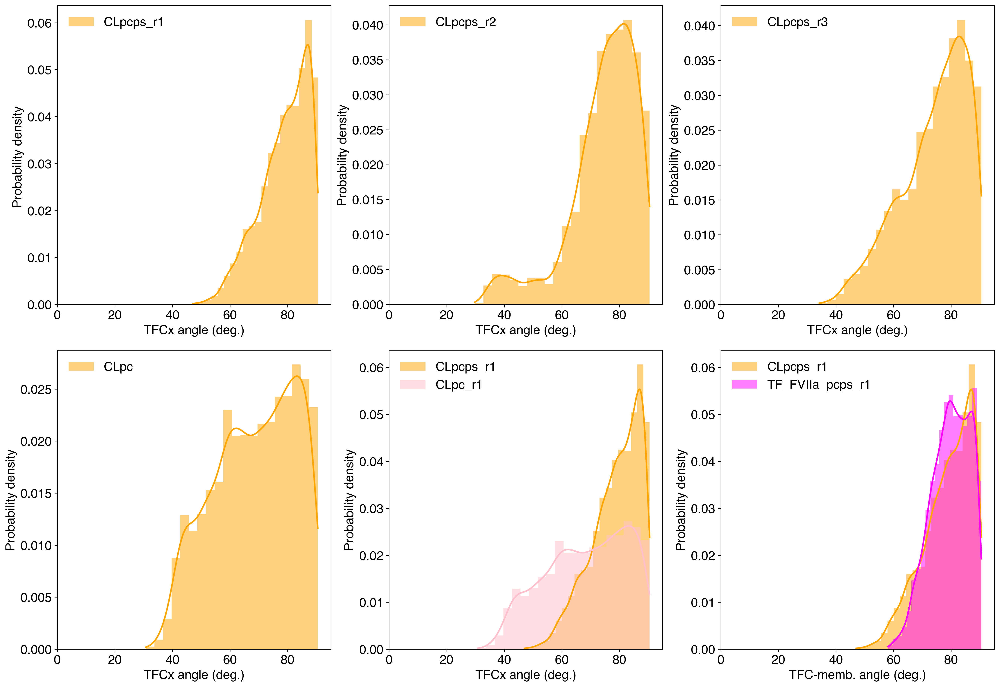

In [240]:
## Angles as in Fig. S3 but with new meausrements. Mostly with Okhubo definition for TFC-Memb angle. -- Regularized bw 0-90 for TFC-memb

### Data

#R1
CLpsr1a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R1_200ps.dat'

CLpsr1a_all = np.genfromtxt(CLpsr1a, usecols=(0,3))
#CLpsr1a_all2 = np.genfromtxt(CLpsr1a, usecols=(0,3))
CLpsr1a_eq = np.genfromtxt(CLpsr1a, usecols=(0,3))

#CLpsr1a_allm = np.genfromtxt(CLpsr1a, usecols=(0,6))
#CLpsr1a_eqm = np.genfromtxt(CLpsr1a, usecols=(0,6))

#R2
CLpsr2a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R2_200ps.dat'
CLpsr2a_all = np.genfromtxt(CLpsr2a, usecols=(0,3))
CLpsr2a_eq = np.genfromtxt(CLpsr2a, usecols=(0,3), skip_header=711)

#CLpsr2a_allm = np.genfromtxt(CLpsr2a, usecols=(0,8))
#CLpsr2a_eqm = np.genfromtxt(CLpsr2a, usecols=(0,8), skip_header=711)

#R3
CLpsr3a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_R3_200ps.dat'
CLpsr3a_all = np.genfromtxt(CLpsr3a, usecols=(0,6))
CLpsr3a_eq = np.genfromtxt(CLpsr3a, usecols=(0,6), skip_header=573)

#CLpsr3a_allm = np.genfromtxt(CLpsr3a, usecols=(0,6))
#CLpsr3a_eqm = np.genfromtxt(CLpsr3a, usecols=(0,6), skip_header=573)

#PC
CLpcr1a= '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFangles_as_Okhubo_PC_200ps.dat'

CLpcr1a_all = np.genfromtxt(CLpcr1a, usecols=(0,3))
#CLpsr1a_all2 = np.genfromtxt(CLpcr1a, usecols=(0,3))
CLpcr1a_eq = np.genfromtxt(CLpcr1a, usecols=(0,3), skip_header=144)

#Reg
CLpsr1a_eq_v2 = np.array([180-x if x > 90.5 else x+0 for x in CLpsr1a_eq[:,1]])
CLpsr2a_eq_v2 = np.array([180-x if x > 90.5 else x+0 for x in CLpsr2a_eq[:,1]])
CLpsr3a_eq_v2 = np.array([180-x if x > 90.5 else x+0 for x in CLpsr3a_eq[:,1]])
CLpcr1a_eq_v2 = np.array([180-x if x > 90.5 else x+0 for x in CLpcr1a_eq[:,1]])

# Concatenate all PCPS runs
#ang_all=np.concatenate((CLpsr1a_eq[:,1],CLpsr2a_eq[:,1],CLpsr3a_eq[:,1]),axis=0)
ang_all_v2=np.concatenate((CLpsr1a_eq_v2,CLpsr2a_eq_v2,CLpsr3a_eq_v2),axis=0)

# new TF_F7
TF7psr1a = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_F7/newTFF7_results/TF_F7_new_angles_as_Okhubo_200ps.dat'
TF7psr1a_all = np.genfromtxt(TF7psr1a, usecols=(0,6))
TF7psr1a_eq = np.genfromtxt(TF7psr1a, usecols=(0,6), skip_header=719)

TF7psr1a_eq_v2 = np.array([180-x if x > 90.5 else x+0 for x in TF7psr1a_eq[:,1]])

### Fig.2 Prob. dist ###
plt.figure(2,figsize = (18,18)) 

plt.subplot(331)
#sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
sns.histplot((CLpsr1a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#lin=ax.lines[0].get_xdata().astype(int)
#lin2=ax.lines[0].get_xdata(0)
#lin3=ax.lines[0].get_ydata()
#np.savetxt("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/Fig3e.csv", (np.c_[lin2,lin3]), delimiter=",")
#print (tabla)

plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density ')
#plt.title('CLpcps_r1')
plt.xlim([0, 95])
legend(loc='best', frameon = False)
#plt.ylim([0, 0.035])

plt.subplot(332)
#sns.histplot((CLpsr2a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r2')
sns.histplot((CLpsr2a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r2')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r2')
plt.xlim([0, 95])
legend(loc='best', frameon = False)
#plt.ylim([0, 0.035])

plt.subplot(333)
#sns.histplot((CLpsr3a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r3')
sns.histplot((CLpsr3a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r3')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r3')
plt.xlim([0, 95])
legend(loc='best', frameon = False)
#plt.ylim([0, 0.035])

plt.subplot(334)
#sns.histplot((CLpcr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpc')
sns.histplot((CLpcr1a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpc')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r3')
plt.xlim([0, 95])
legend(loc='best', frameon = False)
#plt.ylim([0, 0.035])

plt.subplot(335)
#sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((ang_all), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2),edgecolor="None",label='all_pcps')
#sns.histplot((CLpcr1a_eq[:,1]), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2), edgecolor="None",label='CLpc_r1')
sns.histplot((CLpsr1a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((ang_all_v2), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2),edgecolor="None",label='all_pcps')
sns.histplot((CLpcr1a_eq_v2), stat='density',bins=20,kde=True, color='pink',line_kws=dict(color="pink", linewidth=2), edgecolor="None",label='CLpc_r1')

plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('Comparison')
#plt.xlim([0, 180])
plt.xlim([0, 95])
#plt.ylim([0, 0.035])
legend(loc='best', frameon = False)

plt.subplot(336)

#sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
sns.histplot((CLpsr1a_eq_v2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((TF7psr1a_eq[:,1]), stat='density',bins=20,kde=True, color='magenta',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='TF_FVIIa_pcps_r1')
sns.histplot((TF7psr1a_eq_v2), stat='density',bins=20,kde=True, color='magenta',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='TF_FVIIa_pcps_r1')

plt.xlabel('TFC-memb. angle (deg.)')
plt.ylabel('Probability density')
plt.xlim([0, 95])
#plt.ylim([0, 0.07])
legend(loc='best', frameon = False)


plt.tight_layout()    
plt.savefig("/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFC_CM_angle_as_Okhubo_Reg_090.pdf", dpi=300)
plt.show()

CLpcps_R1 V2
78.78768134782581 1.8714467776658148


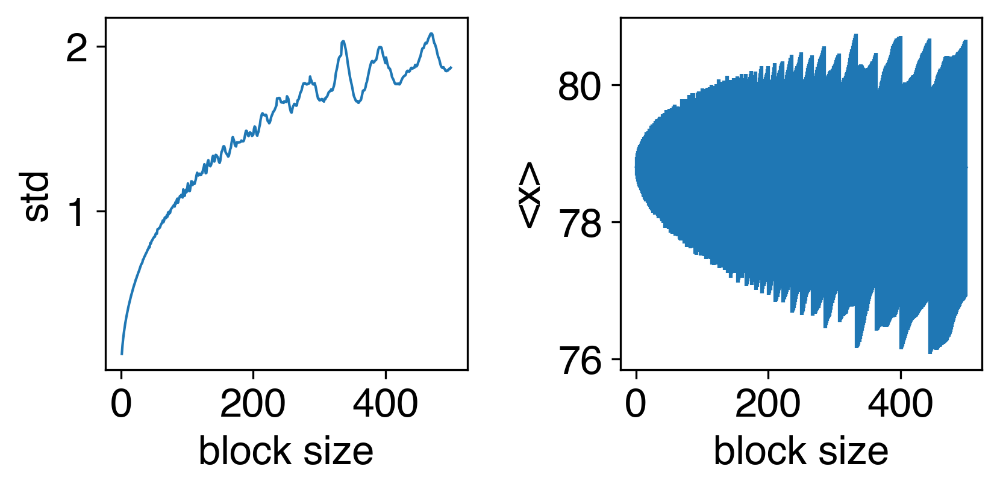

CLpcps_R2 V2
74.33331233258491 1.8728735239630676


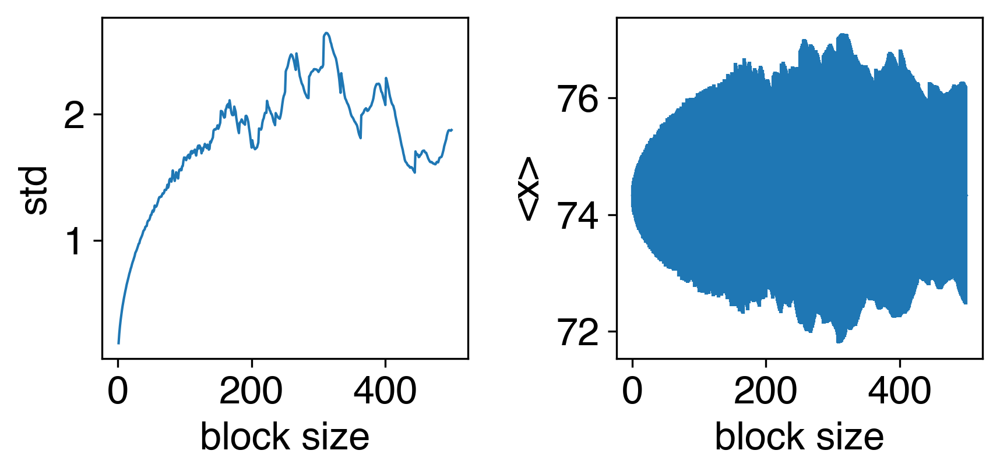

CLpcps R3 V2
74.06329510667038 2.468489679880501


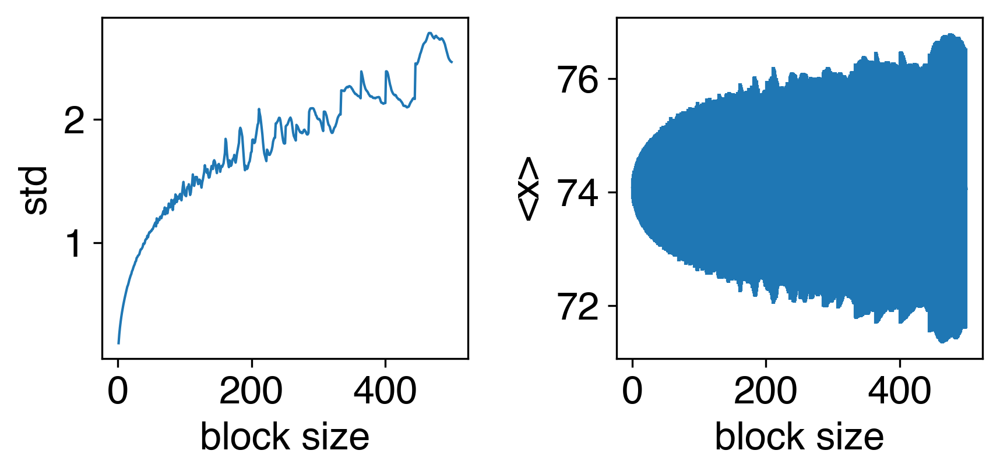

CLpc_R1 V2
68.41871884551176 3.5205748717307417


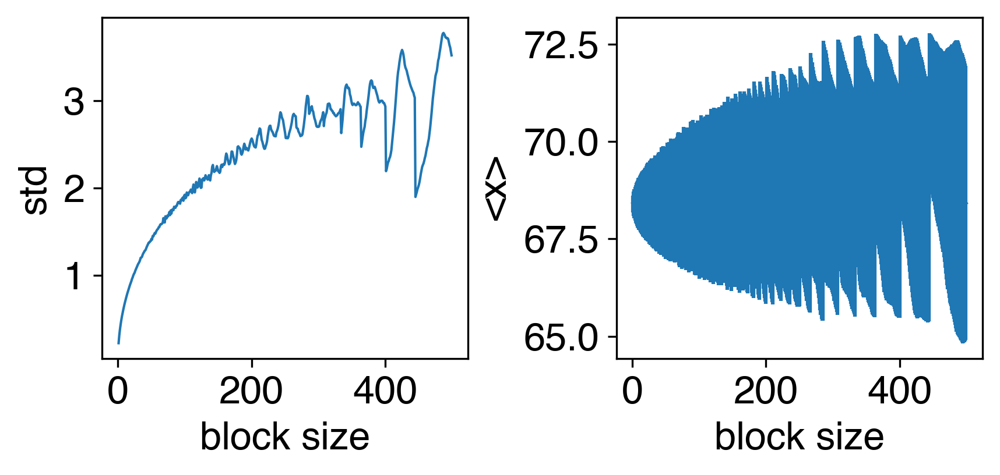

TFF7 V2
79.62741081058618 1.7376982681103355


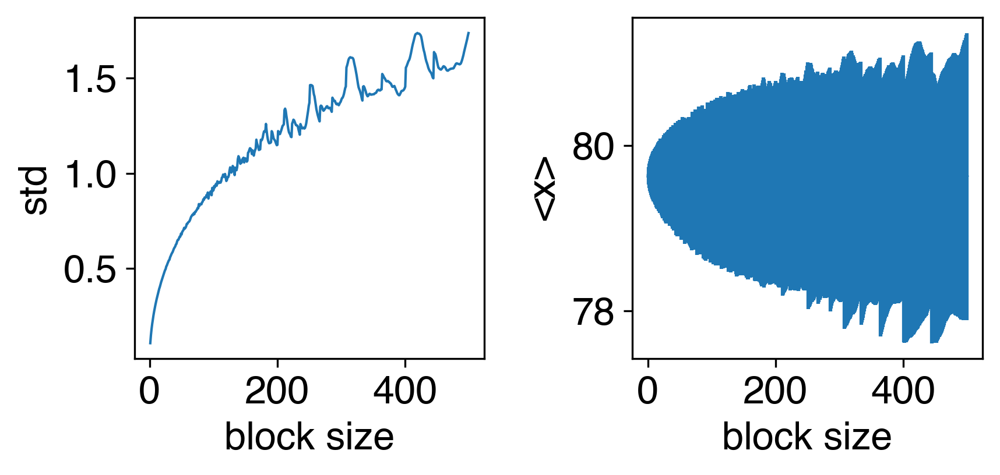

In [234]:
## Block analysis TFC-memb angle Reg

print ('CLpcps_R1 V2')
blockAverage(CLpsr1a_eq_v2,maxBlockSize=500)

print ('CLpcps_R2 V2')
blockAverage(CLpsr2a_eq_v2,maxBlockSize=500)

print ('CLpcps R3 V2')
blockAverage(CLpsr3a_eq_v2,maxBlockSize=500)

print ('CLpc_R1 V2')
blockAverage(CLpcr1a_eq_v2,maxBlockSize=500)

print ('TFF7 V2')
blockAverage(TF7psr1a_eq_v2, maxBlockSize=500)

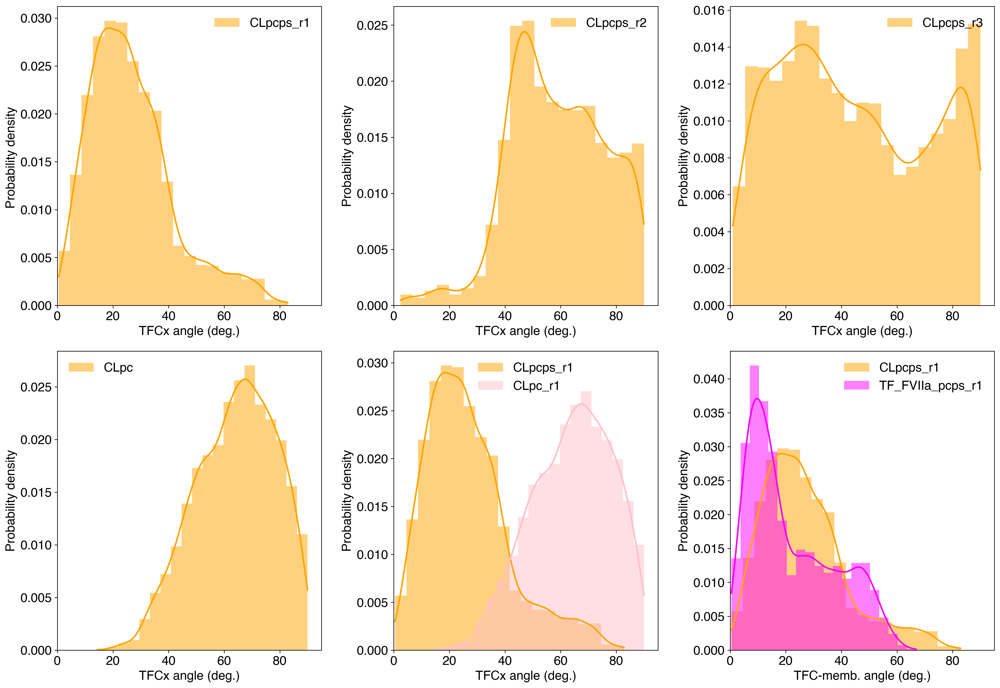

In [236]:
## Prob. dens. of Tilt.

#R1
data1 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_TFC_TMD_titl_skew_R1_wof200ns_200ps.dat'
tilt1=np.genfromtxt(data1, usecols=(6),autostrip=True)
skew1=np.genfromtxt(data1, usecols=(8),autostrip=True)
twist1=np.genfromtxt(data1, usecols=(11),autostrip=True)

#R2
data2 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_TFC_TMD_titl_skew_R2_wof200ns_200ps.dat'
tilt2=np.genfromtxt(data2, usecols=(6),autostrip=True, skip_header=711)
skew2=np.genfromtxt(data2,usecols=(8),autostrip=True, skip_header=711)
twist2=np.genfromtxt(data2, usecols=(11),autostrip=True, skip_header=711)

tilt2_2 = np.array([90-x for x in tilt2])

#R3
data3 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_TFC_TMD_titl_skew_R3_wof200ns_200ps.dat'
tilt3=np.genfromtxt(data3, usecols=(6),autostrip=True, skip_header=573)
skew3=np.genfromtxt(data3, usecols=(8),autostrip=True, skip_header=573)
twist3=np.genfromtxt(data3, usecols=(11),autostrip=True, skip_header=573)

tilt3_2 = np.array([180-x if x > 90 else x+0 for x in tilt3])

#tilt, skew = np.meshgrid(tilt, skew)

#Combine runs
tilt_all=np.concatenate((tilt1,tilt2,tilt3), axis=0)
skew_all=np.concatenate((skew1,skew2,skew3), axis=0)
twist_all=np.concatenate((twist1,twist2,twist3), axis=0)

#PC 

dataPC = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFPC_TFC_TMD_titl_skew_R1_wof200ns_200ps.dat'
tiltPC=np.genfromtxt(dataPC, usecols=(6),autostrip=True)
skewPC=np.genfromtxt(dataPC, usecols=(8),autostrip=True)
twistPC=np.genfromtxt(dataPC, usecols=(11),autostrip=True)

# TFF7 #

dataF7 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_F7/newTFF7_results/TFF7new_TFC_TMD_titl_skew_wof200ns_200ps.dat'
tiltF7=np.genfromtxt(dataF7, usecols=(6),autostrip=True, skip_header=719)
skewF7=np.genfromtxt(dataF7, usecols=(8),autostrip=True, skip_header=719)
twistF7=np.genfromtxt(dataF7, usecols=(11),autostrip=True, skip_header=719)

### Fig.2 Prob. dist ###
plt.figure(2,figsize = (18,18)) 

plt.subplot(331)
#sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
sns.histplot((tilt1), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#lin=ax.lines[0].get_xdata().astype(int)
#lin2=ax.lines[0].get_xdata(0)
#lin3=ax.lines[0].get_ydata()
#np.savetxt("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/Fig3e.csv", (np.c_[lin2,lin3]), delimiter=",")
#print (tabla)

plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density ')
#plt.title('CLpcps_r1')
plt.xlim([0, 95])
legend(loc='best', frameon = False)
#plt.ylim([0, 0.035])

plt.subplot(332)
#sns.histplot((CLpsr2a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r2')
sns.histplot((tilt2), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r2')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r2')
plt.xlim([0, 95])
legend(loc='best', frameon = False)
#plt.ylim([0, 0.035])

plt.subplot(333)
#sns.histplot((CLpsr3a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r3')
sns.histplot((tilt3), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r3')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r3')
plt.xlim([0, 95])
legend(loc='best', frameon = False)
#plt.ylim([0, 0.035])

plt.subplot(334)
#sns.histplot((CLpcr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpc')
sns.histplot((tiltPC), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpc')
plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('CLpcps_r3')
plt.xlim([0, 95])
legend(loc='best', frameon = False)
#plt.ylim([0, 0.035])

plt.subplot(335)
#sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((ang_all), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2),edgecolor="None",label='all_pcps')
#sns.histplot((CLpcr1a_eq[:,1]), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2), edgecolor="None",label='CLpc_r1')
sns.histplot((tilt1), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((ang_all_v2), stat='density',bins=20,kde=True, color='red',line_kws=dict(color="red", linewidth=2),edgecolor="None",label='all_pcps')
sns.histplot((tiltPC), stat='density',bins=20,kde=True, color='pink',line_kws=dict(color="pink", linewidth=2), edgecolor="None",label='CLpc_r1')

plt.xlabel('TFCx angle (deg.)')
plt.ylabel('Probability density')
#plt.title('Comparison')
#plt.xlim([0, 180])
plt.xlim([0, 95])
#plt.ylim([0, 0.035])
legend(loc='best', frameon = False)

plt.subplot(336)

#sns.histplot((CLpsr1a_eq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
sns.histplot((tilt1), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.histplot((TF7psr1a_eq[:,1]), stat='density',bins=20,kde=True, color='magenta',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='TF_FVIIa_pcps_r1')
sns.histplot((tiltF7), stat='density',bins=20,kde=True, color='magenta',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='TF_FVIIa_pcps_r1')

plt.xlabel('TFC-memb. angle (deg.)')
plt.ylabel('Probability density')
plt.xlim([0, 95])
#plt.ylim([0, 0.07])
legend(loc='best', frameon = False)


plt.tight_layout()    
plt.savefig("/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TFC_CM_angle_as_Tilt.pdf", dpi=300)
plt.show()

CLpcps_R1 V2
26.770542780189476 5.237794937574218


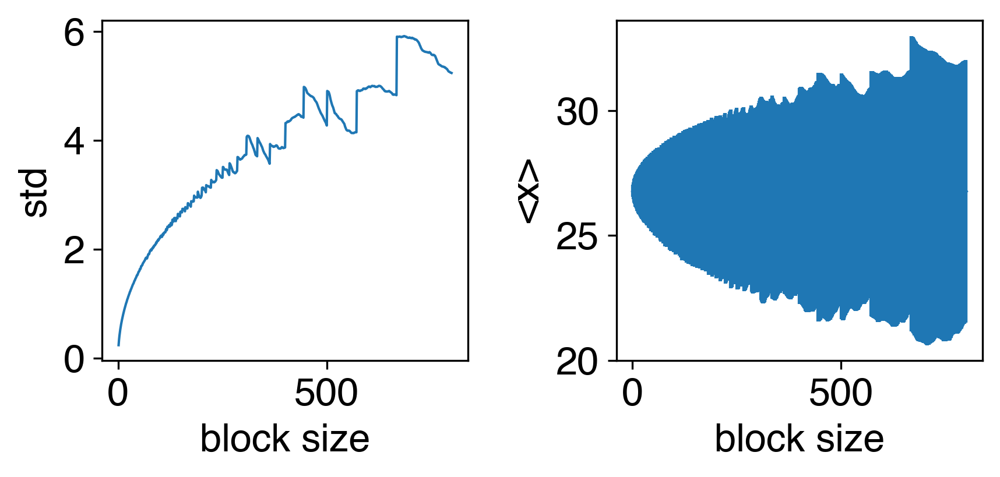

CLpcps_R2 V2
58.89438520006994 4.846831144502916


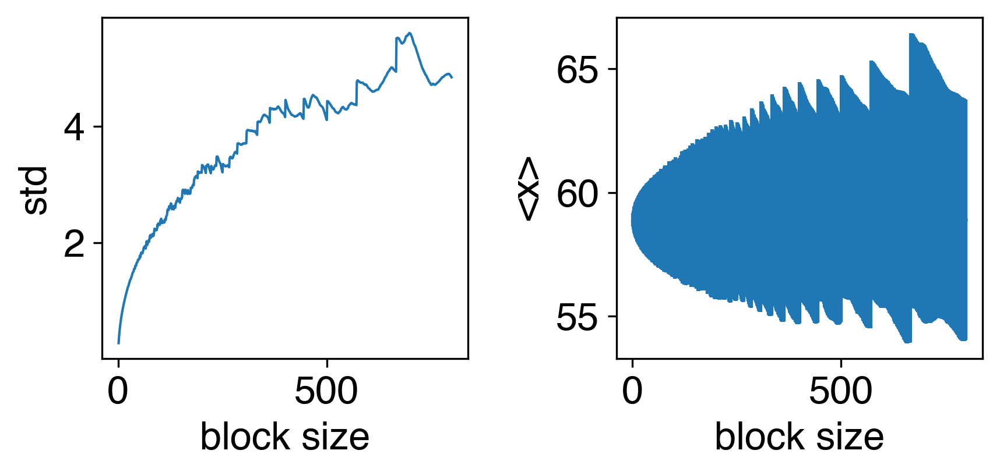

CLpcps R3 V2
44.5566593336583 10.37408073410246


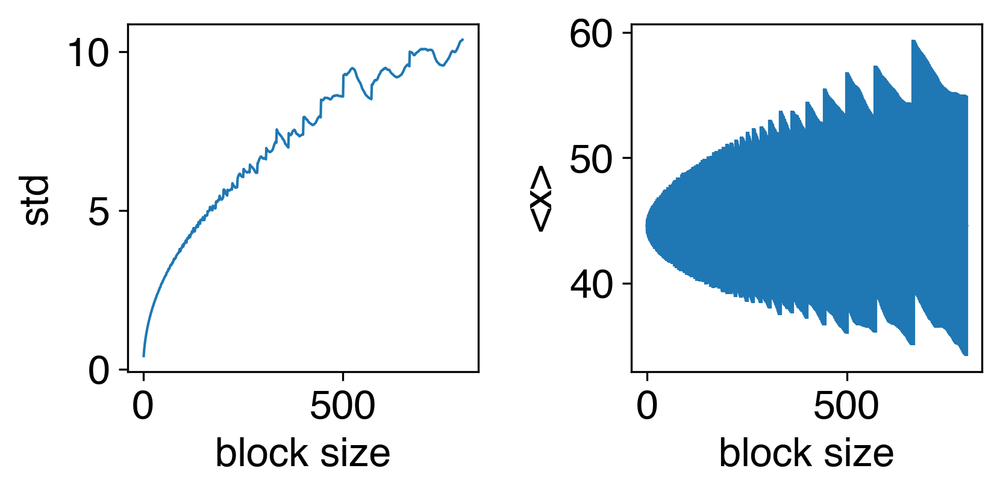

CLpc_R1 V2
64.64434237736312 1.3542920989632548


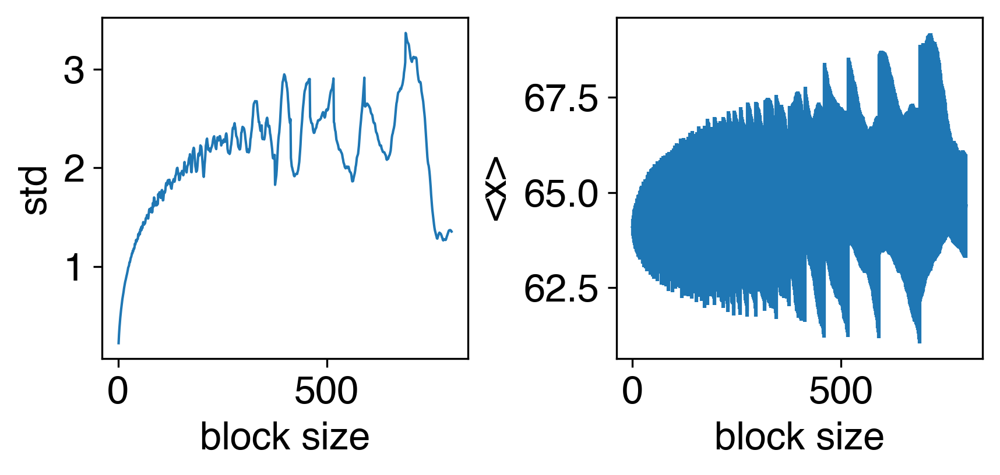

TFF7 V2
22.208004911773223 6.651798226657752


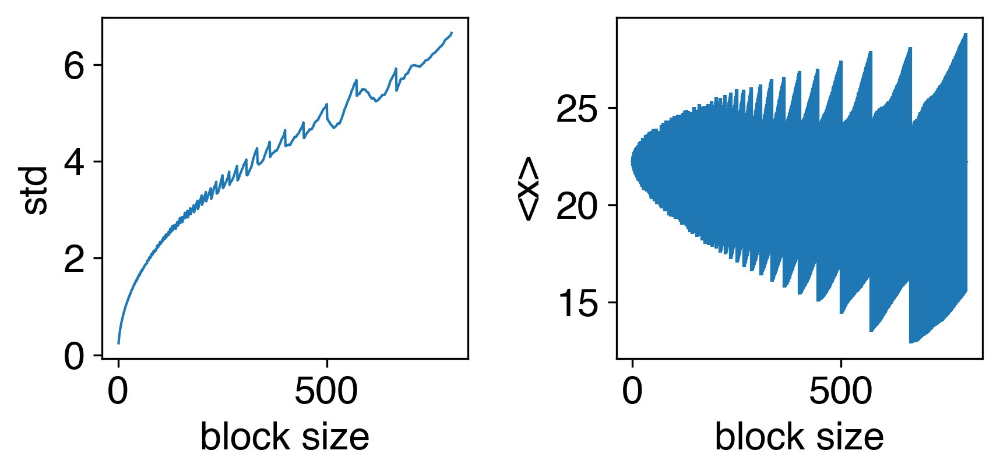

In [239]:
## Block analysis TFC-memb as Tilt

print ('CLpcps_R1 V2')
blockAverage(tilt1,maxBlockSize=800)

print ('CLpcps_R2 V2')
blockAverage(tilt2,maxBlockSize=800)

print ('CLpcps R3 V2')
blockAverage(tilt3,maxBlockSize=800)

print ('CLpc_R1 V2')
blockAverage(tiltPC,maxBlockSize=800)

print ('TFF7 V2')
blockAverage(tiltF7, maxBlockSize=800)

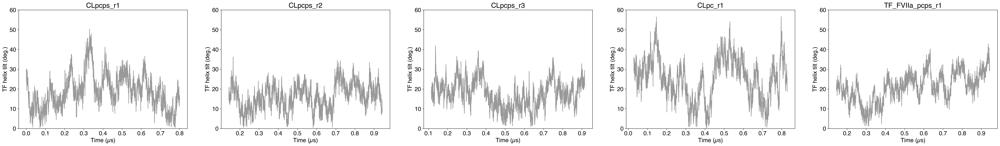

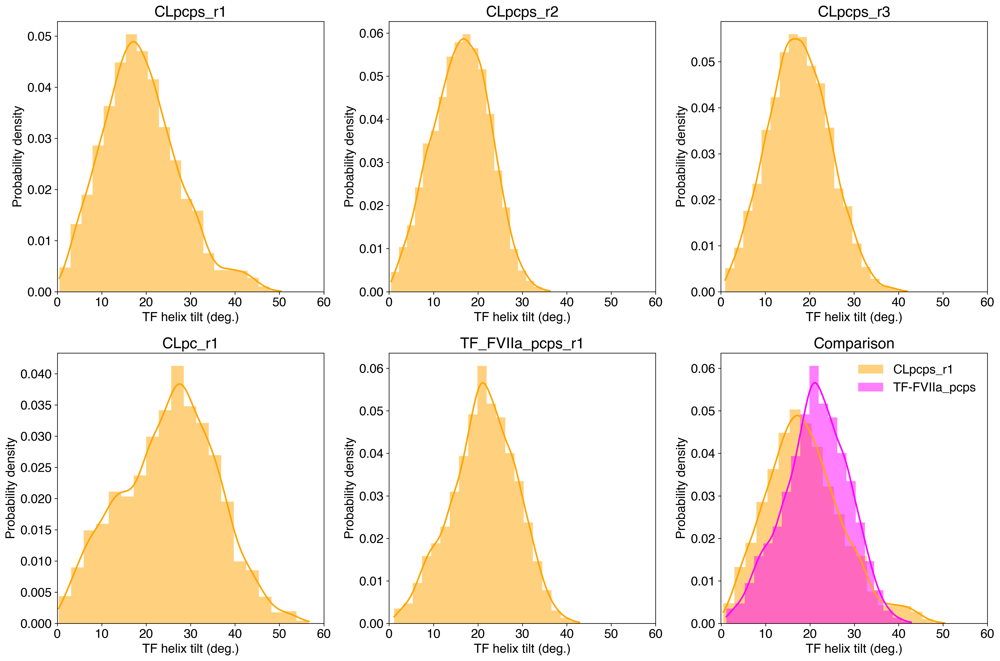

In [251]:
##### TMD-tilt angle ####

#### CL - PCPS ####

#R1
r1 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TMDtilt_R1_200ps.dat'

# Angle
r1_tilt  = np.genfromtxt(r1, usecols=(0,2))
r1_tilteq  = np.genfromtxt(r1, usecols=(0,2))

#Rolling averages -- time evol
#rav_r1_tilt =np.mean(rolling_window(r1_tilt,20), 1)


#r2

r2 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TMDtilt_R2_200ps.dat'

# Angle
r2_tilt  = np.genfromtxt(r2, usecols=(0,2),skip_header=711)
r2_tilteq  = np.genfromtxt(r2, usecols=(0,2),skip_header=711)

#Rolling averages -- time evol
#rav_r2_tilt =np.mean(rolling_window(r2_tilt,20), 1)


#r3

r3 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TMDtilt_R3_200ps.dat'

r3_tilt  = np.genfromtxt(r3, usecols=(0,2),skip_header=573)
r3_tilteq  = np.genfromtxt(r3, usecols=(0,2),skip_header=573)

#Rolling averages -- time evol
#rav_r3_tilt =np.mean(rolling_window(r3_tilt,20), 1)

#### CL PC ####

#files

clpc = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TMDtilt_PC_200ps.dat'

# Angle
clpc_tilt  = np.genfromtxt(clpc, usecols=(0,2),skip_header=144)
clpc_tilteq  = np.genfromtxt(clpc, usecols=(0,2),skip_header=144)

#Rolling averages -- time evol
#rav_clpc_tilt =np.mean(rolling_window(clpc_tilt,20))

                         
#TF-F7 pcps 

tff7 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TMDtilt_TFF7new_200ps.dat'

# Angle
tff7_tilt  = np.genfromtxt(tff7, usecols=(0,2),skip_header=719)
tff7_tilteq  = np.genfromtxt(tff7, usecols=(0,2),skip_header=719)


#Rolling averages -- time evol
#rav_tff7_tilt =np.mean(rolling_window(tff7_tilt,20), 1)

### Figure 1 - Time evol 
plt.figure(1,figsize = (48,6)) 

plt.subplot(151)
plt.plot((r1_tilt[:,0]*0.0002),(r1_tilt[:,1]), color='gray', alpha=0.8)
#plt.plot((rav_r1_tilt[:,0]*0.0002),(rav_r1_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
#plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('CLpcps_r1')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(152)
plt.plot((r2_tilt[:,0]*0.0002),(r2_tilt[:,1]), color='gray', alpha=0.8)
##plt.plot((rav_r2_tilt[:,0]*0.0002),(rav_r2_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
#plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('CLpcps_r2')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(153)
plt.plot((r3_tilt[:,0]*0.0002),(r3_tilt[:,1]), color='gray', alpha=0.8)
#plt.plot((rav_r3_tilt[:,0]*0.0002),(rav_r3_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
#plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('CLpcps_r3')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(154)
plt.plot((clpc_tilt[:,0]*0.0002),(clpc_tilt[:,1]), color='gray', alpha=0.8)
#plt.plot((rav_clpc_tilt[:,0]*0.0002),(rav_clpc_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
#plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('CLpc_r1')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

plt.subplot(155)
plt.plot((tff7_tilt[:,0]*0.0002),(tff7_tilt[:,1]), color='gray', alpha=0.8)
#plt.plot((rav_tff7_tilt[:,0]*0.0002),(rav_tff7_tilt[:,1]), color='red', alpha=1)
plt.ylim([0, 60])
#plt.xlim([0, 1])
plt.xlabel('Time (µs)')
plt.ylabel('TF helix tilt (deg.)')
plt.title('TF_FVIIa_pcps_r1')
plt.vlines(0.2, 90, 140, colors='k', linestyles='solid',zorder=6)

### Fig.2 Prob. dist ###
plt.figure(2,figsize = (18,12)) 
          
plt.subplot(231)
sns.histplot((r1_tilteq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r1')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])

plt.subplot(232)
sns.histplot((r2_tilteq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r2')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r2')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])

plt.subplot(233)
sns.histplot((r3_tilteq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r3')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('CLpcps_r3')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])

plt.subplot(234)
sns.histplot((clpc_tilteq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcp')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('CLpc_r1')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])
          
plt.subplot(235)
sns.histplot((tff7_tilteq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='TF-FVIIa_pcps')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('TF_FVIIa_pcps_r1')
plt.xlim([0, 60])
#plt.ylim([0, 0.1])

plt.subplot(236)
sns.histplot((r1_tilteq[:,1]), stat='density',bins=20,kde=True, color='orange',line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpcps_r1')
#sns.distplot((r2_tilt eq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
#sns.distplot((r3_tilt eq2), bins=20, hist = False, kde = True, kde_kws = {'linewidth': 2} ,label='' )
#sns.histplot((clpc_tilteq[:,1]), stat='density',bins=20,kde=True,line_kws=dict(color="orange", linewidth=2), edgecolor="None",label='CLpc')
sns.histplot((tff7_tilteq[:,1]), stat='density',bins=20,kde=True,color="magenta",line_kws=dict(color="magenta", linewidth=2), edgecolor="None",label='TF-FVIIa_pcps')
plt.xlabel('TF helix tilt (deg.)')
plt.ylabel('Probability density')
plt.title('Comparison')
plt.xlim([-0.1, 60])
#plt.ylim([0, 0.05])
legend(loc='best', frameon = False)

plt.tight_layout()  
plt.savefig("/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_helix_angle.pdf", dpi=300)
plt.show()

18.851858134610666 2.1512821854304187


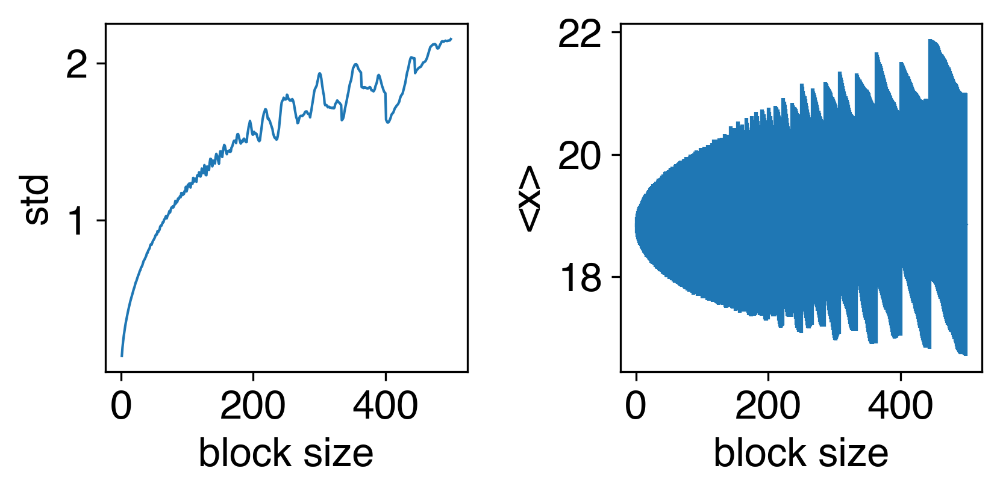

CLpcps_R2 V2
16.229728914031348 0.9211127065403539


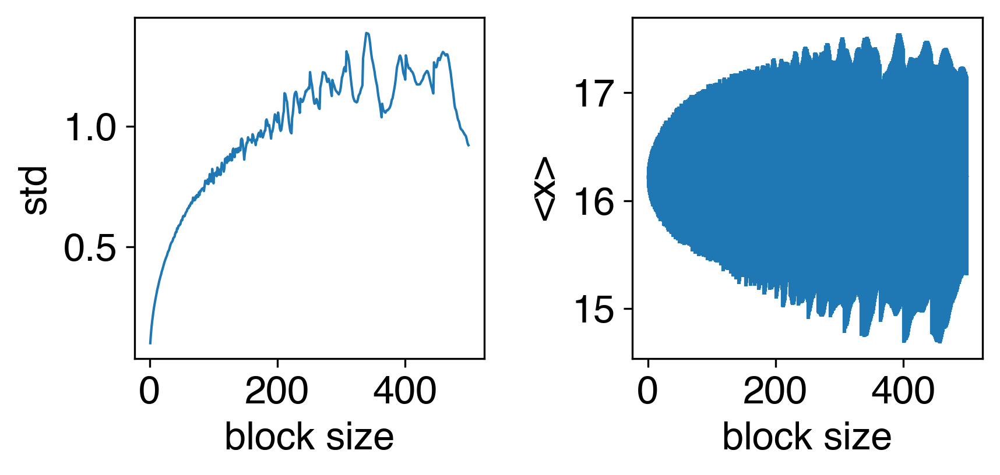

CLpcps R3 V2
17.561665134615943 1.6909400119450253


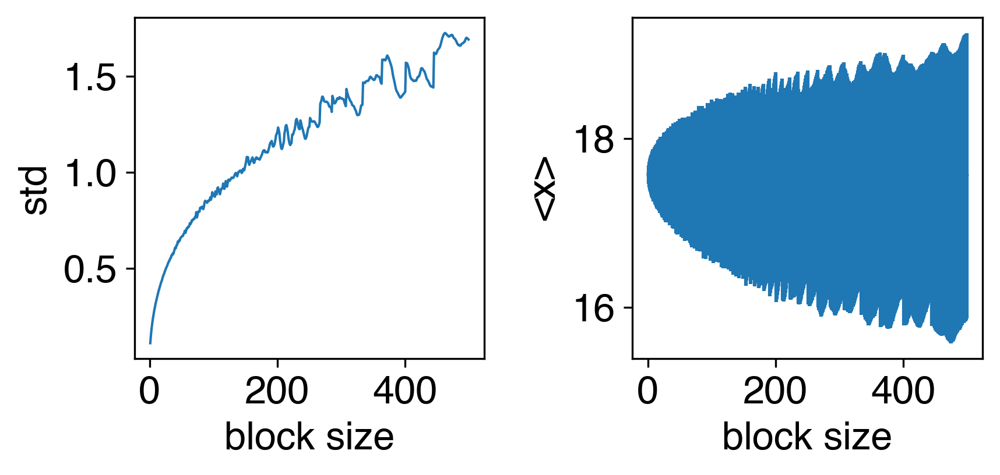

CLpc_R1 V2
25.158420080040717 2.631038659190935


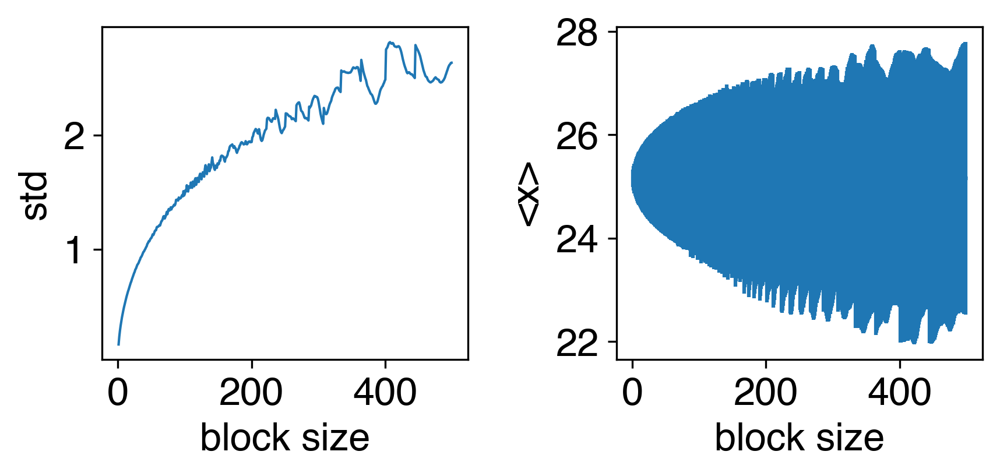

TFF7 V2
21.21005714061925 1.9203685896765956


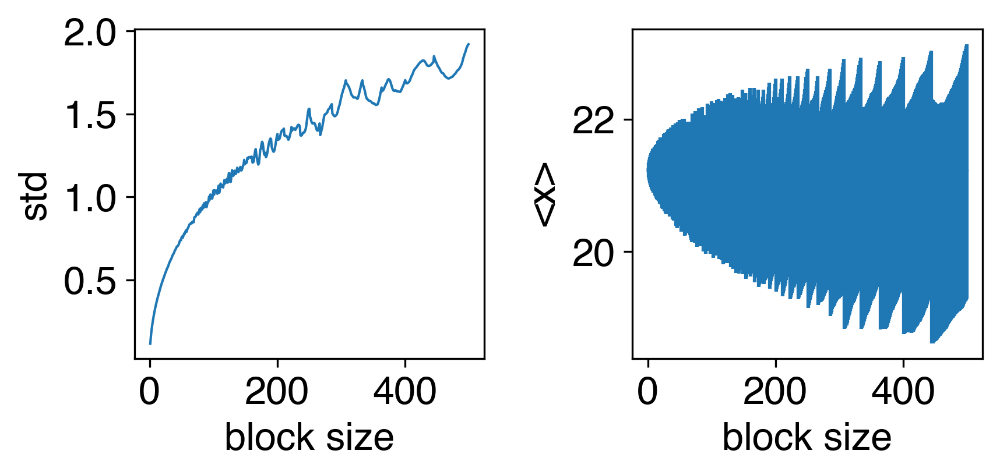

In [250]:
## Block analysis TF-TMD tilt

blockAverage((r1_tilteq[:,1]),maxBlockSize=500)

print ('CLpcps_R2 V2')
blockAverage((r2_tilteq[:,1]),maxBlockSize=500)

print ('CLpcps R3 V2')
blockAverage((r3_tilteq[:,1]),maxBlockSize=500)

print ('CLpc_R1 V2')
blockAverage((clpc_tilteq[:,1]),maxBlockSize=500)

print ('TFF7 V2')
blockAverage((tff7_tilteq[:,1]), maxBlockSize=500)

In [254]:
## PS density map new TFF7 sim

# CL PCPS

#TFCL_PS   = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/CL_1us_pcps_s200ns_200ps_HGPSdens.dx')
#TFCL_prot = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/CL_1us_pcps_s200ns_200ps_TFdens1A.dx')
#TFCL_ECD  = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/CL_1us_pcps_s200ns_200ps_ECDdens1A.dx')
#TFCL_TMD  = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/CL_1us_pcps_s200ns_200ps_TMDdens1A.dx')

TF_F7_pcps  = Grid('/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/density/newTFF7pcps_800ns_200ps_HGPSdens.dx')
#TF_F7_prot  = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/FVIIaTFcl_pcps1us_pcps_s200ns_200ps_PROTdens1A.dx')
#TF_F7_TFecd = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/FVIIaTFcl_pcps1us_pcps_s200ns_200ps_TFECD1Adens.dx')
#TF_F7_F7    = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/FVIIaTFcl_pcps1us_pcps_s200ns_200ps_F7dens1A.dx')
#TF_F7_TF    = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/')
#TF_F7_TMD   = Grid('/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/dens/FVIIaTFcl_pcps1us_pcps_s200ns_200ps_TMDdens1A.dx')



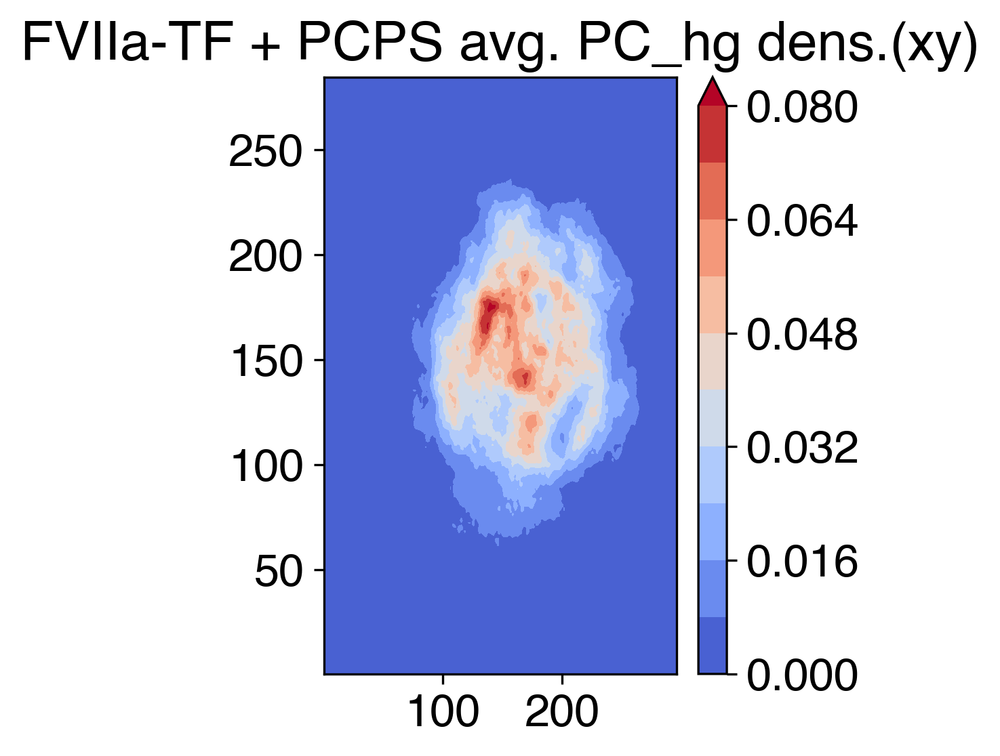

In [256]:
plt.subplot(122)
gridY = TF_F7_pcps.grid
sum_vecY = np.sum(gridY, axis=2)
#rotX = np.rot90(sum_vecX)    
#cfE = plt.contourf(rotE, origin='upper', levels=10, cmap = 'coolwarm',extend='max')
#cfY = plt.contourf(sum_vecY, origin='upper', levels=10, cmap = 'coolwarm',extend='max', norm=norm2)
cfY = plt.contourf(sum_vecY, origin='upper', levels=10, cmap = 'coolwarm',extend='max')
plt.colorbar( cfY )
plt.title('FVIIa-TF + PCPS avg. PC_hg dens.(xy)')
#plt.xlim([15, 140])
#plt.ylim([15, 140])

plt.tight_layout()  
#plt.savefig("/media/4TB_HDD/raul/projects/synergy/TF_EC_TMD/AA/w_SSbs/results/forMS/plots_jan21/PS_dens_maps_020221.pdf", dpi=300)
plt.show()

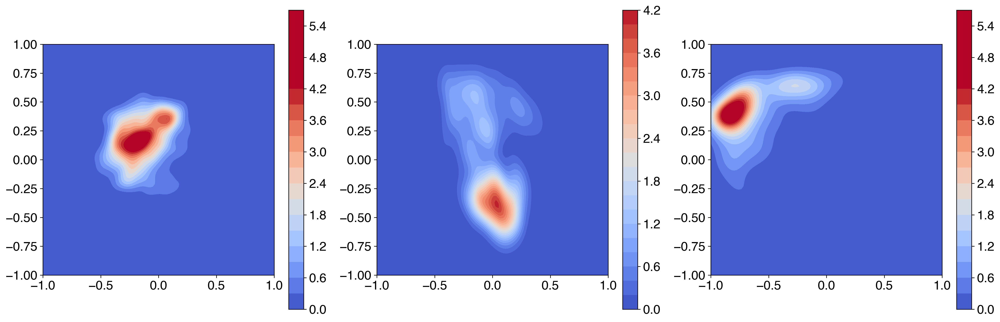

In [277]:
## TFC vector projections

dataTFF7 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/TF_F7/FVIIac_HL_TFCLs6.6_CGU_SBopm_PCPS_charmm-gui/gromacs/TF_F7_new_projections_TFC_R3_200ps.dat'
px7=np.genfromtxt(dataTFF7, usecols=(1))
py7=np.genfromtxt(dataTFF7, usecols=(2))

dataR1 = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/projections_TFC_R1_200ps.dat'
px1=np.genfromtxt(dataR1, usecols=(1))
py1=np.genfromtxt(dataR1, usecols=(2))

dataPC = '/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/projections_TFC_PC_200ps.dat'
pxC=np.genfromtxt(dataPC, usecols=(1))
pyC=np.genfromtxt(dataPC, usecols=(2))

norm1 = cm.colors.Normalize(vmax=4.2)
fig = plt.figure(figsize=(18,6))
# Extract x and y
x = px7
y = py7
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = -1
xmax = 1
ymin = -1
ymax = 1
#print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(131)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=20, cmap='coolwarm',norm=norm1)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
#ax.set_xlabel('Tilt')
#ax.set_ylabel('Skew')\
ax.set_aspect('equal', adjustable='box')
plt.colorbar(cfset)
#################################
# Extract x and y
x = px1
y = py1
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = -1
xmax = 1
ymin = -1
ymax = 1
#print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(132)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=20, cmap='coolwarm',norm=norm1)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
#ax.set_xlabel('Tilt')
#ax.set_ylabel('Skew')\
ax.set_aspect('equal', adjustable='box')
plt.colorbar(cfset)
###########################
# Extract x and y
x = pxC
y = pyC
# Define the borders
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
#xmin = min(x) - deltaX
#xmax = max(x) + deltaX
#ymin = min(y) - deltaY
#ymax = max(y) + deltaY
xmin = -1
xmax = 1
ymin = -1
ymax = 1
#print(xmin, xmax, ymin, ymax)
# Create meshgrid
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

ax = fig.add_subplot(133)
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
cfset = ax.contourf(xx, yy, f, levels=20, cmap='coolwarm',norm=norm1)
#cset = ax.contour(xx, yy, f, colors='k')
#ax.clabel(cset, inline=1, fontsize=10)
#ax.set_xlabel('Tilt')
#ax.set_ylabel('Skew')
ax.set_aspect('equal', adjustable='box')
plt.colorbar(cfset)

plt.tight_layout()  
plt.savefig("/Users/capitank/Dropbox/USS_Lab/Investigacion/TF_paper_redo/projection_maps.pdf", dpi=300)
plt.show()